In [1]:
# imports
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch
from torch import nn
import torch.nn.functional as F
from tqdm import trange
import numpy as np
import matplotlib.pyplot as plt
import directed_graphs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# New Loss

In this notebook, I will code up a DFE with new loss function discussed on July 18th, 2022.

The loss function is as follows:

$$\sum\limits_{i,j \in V}|d_{diff}(x_i,x_j)-||\phi(x_i)-\phi(x_j)||_2|$$ $$+ \beta \sum\limits_{i \in V} \sum\limits_{k \in N_f(i)} ||(\phi(x_k)-\phi(x_i))-f(\phi(x_i))||_2$$ $$+ \gamma \cdot smoothness$$ $$+ \delta \cdot CLL (contrastive learning loss)$$

# Affinity Functions

In [2]:
def affinity_from_flow(flow, directions_array, flow_strength = 1, sigma=1):
  """Compute probabilities of transition in the given directions based on the flow. 

  Parameters
  ----------
  flow : torch tensor of shape n_points x n_dims
      _description_
  directions_array : torch tensor of shape n_directions x n_points x n_dims. Assumed to be normalized.
      _description_
  sigma : int, optional
      kernel bandwidth, by default 1
  returns (n_points)
  """
  assert len(flow.shape) == 2 # flow should only have one dimension
  assert len(directions_array.shape) > 1 and len(directions_array.shape) < 4
  n_directions = directions_array.shape[0]
  # Normalize directions
  length_of_directions = torch.linalg.norm(directions_array,dim=-1)
  normed_directions = F.normalize(directions_array,dim=-1)
  # and normalize flow # TODO: Perhaps reconsider
  # Calculate flow lengths, used to scale directions to flow
  # flow_lengths = torch.linalg.norm(flow,dim=-1)
  if len(directions_array) == 1: # convert to 2d array if necessary
    directions_array = directions_array[:,None] 
  # scale directions to have same norm as flow
  # scaled_directions = normed_directions * flow_lengths[:,None].repeat(directions_array.shape[0],1,directions_array.shape[2])
  # compute dot products as matrix multiplication
  dot_products = (normed_directions * flow).sum(-1)
  # take distance between flow projected onto direction and the direction
  distance_from_flow = (torch.linalg.norm(flow,dim=1)).repeat(n_directions,1) - dot_products
  # take absolute value
  distance_from_flow = torch.abs(distance_from_flow)
  # print('shape of dff',distance_from_flow.shape)
  # add to this the length of each direction
  distance_from_flow = flow_strength*distance_from_flow + length_of_directions
  # put the points on rows, directions in columns
  distance_from_flow = distance_from_flow.T
  # take kernel of distances
  kernel =  torch.exp(-distance_from_flow/sigma)
  return kernel

In [3]:
def affinity_matrix_from_pointset_to_pointset(pointset1, pointset2, flow,n_neighbors=None,sigma=0.5, flow_strength=1):
  """Compute affinity matrix between the points of pointset1 and pointset2, using the provided flow.

  Parameters
  ----------
  pointset1 : torch tensor, n1 x d
      The first pointset, to calculate affinities *from*
  pointset2 : torch tensor, n2 x d
      The second pointset, to calculate affinities *to* (from pointset1)
  flow : a function that, when called at a point, gives the flow at that point
  n_neighbors : number of neighbors to include in affinity computations. All neighbors beyond it are given affinity zero
  (currently not implemented)

  Returns:
  Affinity matrix: torch tensor of shape n1 x n2
  """
  # Calculate the directions from point i in pointset 1 to point j in pointset 2
  n1 = pointset1.shape[0]
  n2 = pointset2.shape[0]
  P2 = pointset2[:,:,None].repeat(1,1,n1)
  P1 = pointset1.T.repeat(n2,1,1)
  P3 = (P2 - P1)
  P3 = P3.transpose(1,2)
  # dimension 1 represents directions to point i
  # dimension 2 represents direction from point j
  # dimension 3 represents direction in each dimension (R^n)
  # compute affinities from flow and directions
  affinities = affinity_from_flow(flow,P3,sigma=sigma,flow_strength=flow_strength)
  return affinities

# Flexible FlowArtist and Encoder (ReLU MLPs) Object Creator Function

In [4]:
from collections import OrderedDict

def FlowArtist(dim = 2, shape = [2,4,8,4,2], device = torch.device('cpu')):
    # Function to create tailored flow artist
    
    FA = nn.Sequential()
    
    d_len = len(shape)*2
    d = OrderedDict()
    d[str(0)] = nn.Linear(shape[0], shape[1])
    for i in range(1,d_len-3):
        if i%2 == 1:
            d[str(i)] = nn.LeakyReLU()
        else:
            d[str(i)] = nn.Linear(shape[int(i/2)], shape[int(i/2)+1])
    
    # create MLP
    FA = nn.Sequential(d) # d is an OrderedDictionary
        
    return FA

In [5]:
class FeedForwardReLU(nn.Module):
    def __init__(self, shape):
        super(FeedForwardReLU, self).__init__()
        d_len = len(shape) * 2
        d = OrderedDict()
        d[str(0)] = nn.Linear(shape[0], shape[1])
        for i in range(1, d_len - 3):
            if i % 2 == 1:
                d[str(i)] = nn.LeakyReLU()
            else:
                d[str(i)] = nn.Linear(shape[int(i / 2)], shape[int(i / 2) + 1])
        # create MLP
        self.FA = nn.Sequential(d)

    def forward(self, X):
        return self.FA(X)

# Loss Functions

In [6]:
def diffusion_map_loss(P_graph, embedded_points):
  num_nodes = P_graph.shape[0]
  D_graph = torch.cdist(P_graph, P_graph)
  D_embedding = torch.cdist(embedded_points, embedded_points)
  loss = torch.norm(D_graph - D_embedding)**2 / (num_nodes**2)
  return loss

def near_neighbors_tensor(points, affinity_matrix, k):
    # returns n x k (neighbors) x dimensions Tensor
    A = affinity_matrix
    n = A.shape[0]
    d = points.size()[1]
    _, indices = torch.topk(A, k)
    
    ret = torch.empty(size=(n,k,d)).to(device)
    
    for i in range(indices.size()[0]):
        for j in range(indices.size()[1]):
            index = indices[i][j]
            ret[i][j] = points[index]
    
    return ret

def flow_neighbor_loss(points, near_neighbors, encoder, flow_artist):
    
    k = near_neighbors.shape[1]
    embedded_points = encoder(points)
    embedded_points = embedded_points[:,None,:].repeat(1,k,1)
    
    big_mat = encoder(near_neighbors) - embedded_points - flow_artist(embedded_points)
    norms = torch.linalg.norm(big_mat, dim = 2)
    
    return torch.sum(norms)

### Test Functions

In [7]:
points = [[0,0],
         [1,0],
         [0,1],
         [-1,0],
         [0,-1]]

flow = [[1,0],
         [1,0],
         [1,0],
         [1,0],
         [1,0]]

points = torch.tensor(points).float()
flow = torch.tensor(flow).float()

#plt.scatter(points[:,0], points[:,1])
#plt.quiver(points[:,0], points[:,1], flow[:,0], flow[:,1])

In [8]:
A = affinity_matrix_from_pointset_to_pointset(points, points, flow)
A
#plt.imshow(A)

tensor([[0.1353, 0.1353, 0.0183, 0.0025, 0.0183],
        [0.0025, 0.1353, 0.0019, 0.0003, 0.0019],
        [0.0183, 0.0329, 0.1353, 0.0019, 0.0025],
        [0.1353, 0.0183, 0.0329, 0.1353, 0.0329],
        [0.0183, 0.0329, 0.0025, 0.0019, 0.1353]])

In [9]:
near_neighbors_tensor(points, A, 2).size()[2]

2

# Embedder Class

In [43]:
class FlowEmbedder(torch.nn.Module):
    def __init__(
        self,
        X,
        flow,
        sigma_graph=0.5,
        flow_strength_graph=5,
        embedding_dimension=2,
        learning_rate=1e-3,
        FAShape=(2, 4, 8, 4, 2),
        EncShape=(3, 4, 8, 4, 2),
        decoder=None,
        labels=None,
        loss_weights=None,
        knn = 10,
        device=torch.device("cpu"),
    ):
        # initialize parameters
        super(FlowEmbedder, self).__init__()

        # generate default parameters
        embedder = (
            FeedForwardReLU(shape=EncShape)
        )
        loss_weights = (
            {
                "points": 1,
                "flow": 1,
                "smoothness": 0,
                "CLL": 0,
            }
            if loss_weights is None
            else loss_weights
        )
        self.X = X
        self.flow = flow
        self.sigma_graph = sigma_graph
        self.nnodes = X.shape[0]
        self.data_dimension = X.shape[1]

        self.loss_weights = loss_weights
        self.labels = labels
        self.embedding_dimension = embedding_dimension
        # set device (used for shuffling points around during visualization)
        self.device = device

        # Affinity Matrix in Ambient Space
        self.P_graph = affinity_matrix_from_pointset_to_pointset(
            X, X, flow, sigma=sigma_graph, flow_strength=flow_strength_graph
        )
        self.P_graph = F.normalize(self.P_graph, p=1, dim=1)
        
        # Ambient space points neighbors
        self.knn = knn
        self.near_neighbors = near_neighbors_tensor(self.X, self.P_graph, self.knn)
        
        # Flow field
        self.FlowArtist = FlowArtist(dim = 2, 
                                     shape = FAShape, 
                                     device = torch.device('cpu')
        ).to(self.device)

        # Autoencoder to embed the points into a low dimension
        
        self.embedder = embedder
        if decoder is not None:
            self.decoder = decoder.to(self.device)
        else:
            self.decoder = None

        # training ops
        self.optim = torch.optim.Adam(self.parameters(), lr=learning_rate)

        # split input data into batches

    def loss(self, epoch):
        # embed points
        self.embedded_points = self.embedder(self.X)
        # compute diffusion loss on embedded points
        
        #"""
        # compute point embedding loss according to diffusion maps
        diffmap_loss = diffusion_map_loss(self.P_graph, self.embedded_points)
        self.losses["points"].append(diffmap_loss)
        #"""
        
        #"""
        # compute flow field loss
        flow_loss = flow_neighbor_loss(self.X, self.near_neighbors, self.embedder, self.FlowArtist)#*10e-6
        self.losses["flow"].append(flow_loss)
        #"""

        """
        if epoch < 2000:
            loss = diffmap_loss
        else:
             loss = diffmap_loss + flow_loss*10e-5
        """
        loss = diffmap_loss + flow_loss*10e-5
        
        return loss

    def visualize_points(self, labels=None):
        embedded_points = self.embedder(X)
        
        xmin = float(torch.min(embedded_points[:,0]))
        xmax = float(torch.max(embedded_points[:,0]))
        ymin = float(torch.min(embedded_points[:,1]))
        ymax = float(torch.max(embedded_points[:,1]))
        
        x_grid = torch.arange(xmin, xmax, (xmax-xmin)/20)
        y_grid = torch.arange(ymin, ymax, (ymax-ymin)/20)
        
        grid = []
        
        for i in range(20):
            for j in range(20):
                grid.append([x_grid[i], y_grid[j]])
        
        grid = torch.tensor(grid).float().to(device)
        flow = self.FlowArtist(grid)
        
        plt.scatter(embedded_points[:,0].cpu().detach(), embedded_points[:,1].cpu().detach(), c=labels)
        plt.quiver(grid[:,0].cpu().detach(),grid[:,1].cpu().detach(),flow[:,0].cpu().detach(),flow[:,1].cpu().detach())
        plt.show()

    def visualize_loss(self, loss_type="total"):
        # diffusion_loss,reconstruction_loss, smoothness_loss
        x = []
        k = ""
        losses = {}
        for key in self.losses.keys():
            losses[key] = []
            k = key
        losses["total"] = []
        for i in range(len(self.losses["points"])):
            x.append(i)
            for key in self.losses.keys():
                try:
                    losses[key].append(self.losses[key][i].detach().cpu().numpy())
                except:
                    losses[key].append(0)
        if loss_type == "all":
            for key in self.losses.keys():
                plt.plot(x, losses[key])
            plt.legend(self.losses.keys(), loc="upper right")
            plt.title("loss")
        else:
            plt.plot(x, losses[loss_type])
            plt.title(loss_type)
        
    def fit(self, n_steps=1000):
        # train Flow Embedder on the provided graph
        self.train()
        # reset losses
        self.losses = {}
        for k in self.loss_weights.keys():
            self.losses[k] = []
        # self.weight_of_flow = 0
        for step in trange(n_steps):
            # vary weight of each part of loss function
            """ 
            if step == 100:
                self.weight_of_flow = 1
            if step == 200:
                self.weight_of_flow = 0.5
            """
            self.optim.zero_grad()
            # compute loss
            loss = self.loss(step)
            if loss.isnan():
                print("Final loss was nan")
                raise NotImplementedError
            # compute gradient and step backwards
            loss.backward()
            self.optim.step()
            # print progress report after every 500 epochs
            #"""
            if step % 100 == 0:
                print(f"EPOCH {step}.")
                self.visualize_points(labels)
            #"""
            # TODO: Criteria to automatically end training
        # print("Exiting training with loss ",loss)
        # return self.embedded_points, self.FlowArtist, self.losses

# Testing library functions

In [11]:
A = [[3,2,1],[5,4,6],[9,7,8]]
A = torch.tensor(A).float()

A

tensor([[3., 2., 1.],
        [5., 4., 6.],
        [9., 7., 8.]])

In [12]:
_, indices = torch.topk(A, 2)
indices

tensor([[0, 1],
        [2, 0],
        [0, 2]])

In [13]:
ret = np.empty(shape=(10,4))

In [14]:
p = [[1,0], [0,1]]
p = torch.tensor(p).float()

p.repeat(2,1,1)

tensor([[[1., 0.],
         [0., 1.]],

        [[1., 0.],
         [0., 1.]]])

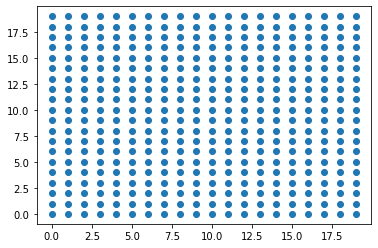

In [15]:
xmin = 0
xmax = 20
ymin = 0
ymax = 20

x_grid = torch.arange(xmin, xmax, (xmax-xmin)/20)
y_grid = torch.arange(ymin, ymax, (ymax-ymin)/20)
        
grid = []
        
for i in range(20):
    for j in range(20):
        grid.append([x_grid[i], y_grid[j]])
    
grid = np.asarray(grid)
    
plt.scatter(grid[:,0], grid[:,1])

# Testing the Embedder

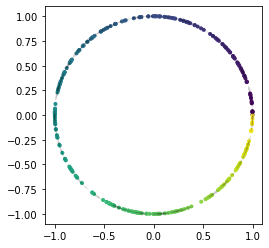

In [33]:
from directed_graphs.datasets import directed_circle
from directed_graphs.datasets import plot_directed_2d, plot_directed_3d

X, flow, labels = directed_circle(num_nodes=300, radius=1)
plot_directed_2d(X, flow, labels)
X = torch.tensor(X).float().to(device)
flow = torch.tensor(flow).float().to(device)

In [17]:
X.shape

torch.Size([300, 3])

In [34]:
FE = FlowEmbedder(X,
                  flow,
                  FAShape=(2, 4, 8, 4, 2),
                  EncShape=(3, 4, 8, 4, 2),
                  knn = 10,
                  device = device).to(device)

  0%|          | 0/20000 [00:00<?, ?it/s]

EPOCH 0.


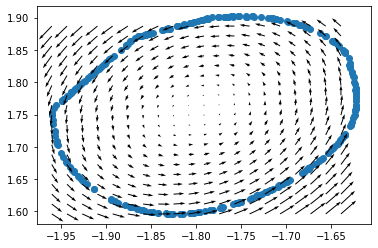

  0%|          | 99/20000 [00:01<03:34, 92.65it/s] 

EPOCH 100.


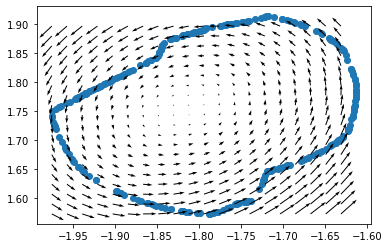

  1%|          | 197/20000 [00:02<03:24, 96.76it/s]

EPOCH 200.


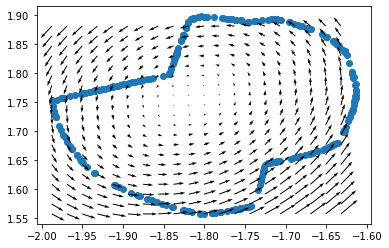

  1%|▏         | 296/20000 [00:04<03:23, 97.05it/s]

EPOCH 300.


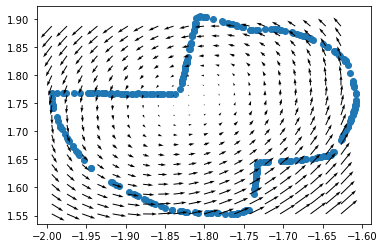

  2%|▏         | 395/20000 [00:05<03:23, 96.51it/s]

EPOCH 400.


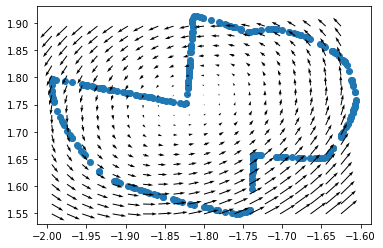

  2%|▏         | 494/20000 [00:06<03:20, 97.37it/s]

EPOCH 500.


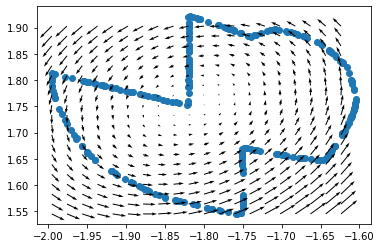

  3%|▎         | 591/20000 [00:07<03:23, 95.30it/s]

EPOCH 600.


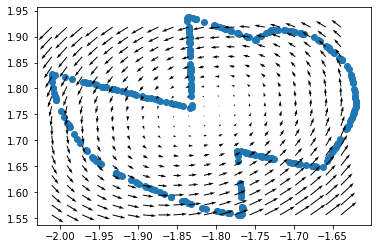

  3%|▎         | 699/20000 [00:09<03:17, 97.62it/s]

EPOCH 700.


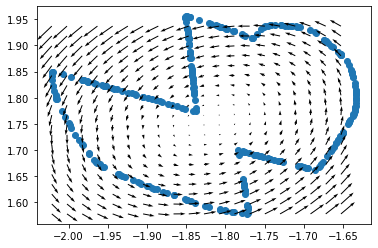

  4%|▍         | 797/20000 [00:10<03:32, 90.20it/s]

EPOCH 800.


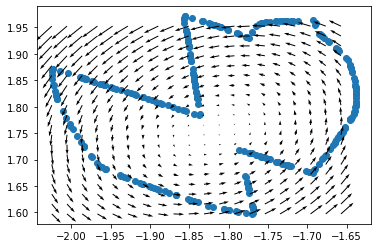

  4%|▍         | 893/20000 [00:12<03:18, 96.22it/s]

EPOCH 900.


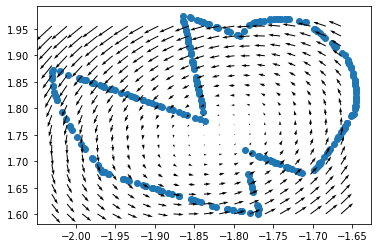

  5%|▍         | 992/20000 [00:13<03:17, 96.43it/s]

EPOCH 1000.


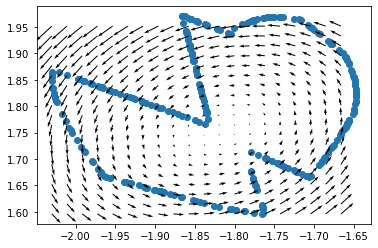

  5%|▌         | 1091/20000 [00:14<03:16, 96.23it/s]

EPOCH 1100.


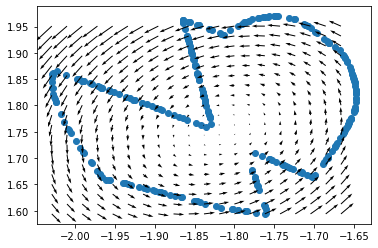

  6%|▌         | 1200/20000 [00:16<03:12, 97.45it/s]

EPOCH 1200.


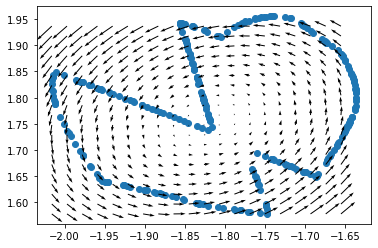

  6%|▋         | 1299/20000 [00:17<03:13, 96.42it/s]

EPOCH 1300.


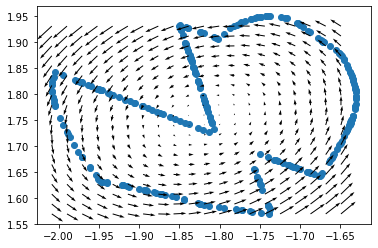

  7%|▋         | 1398/20000 [00:18<03:12, 96.62it/s]

EPOCH 1400.


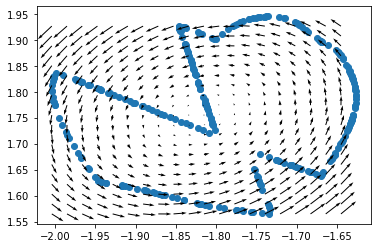

  7%|▋         | 1494/20000 [00:20<03:24, 90.31it/s]

EPOCH 1500.


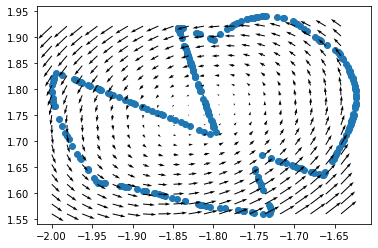

  8%|▊         | 1592/20000 [00:21<03:12, 95.41it/s]

EPOCH 1600.


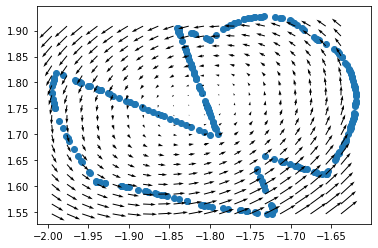

  8%|▊         | 1690/20000 [00:22<03:12, 95.35it/s]

EPOCH 1700.


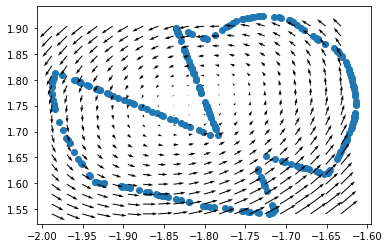

  9%|▉         | 1799/20000 [00:24<03:07, 97.29it/s]

EPOCH 1800.


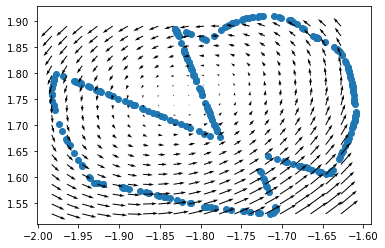

  9%|▉         | 1898/20000 [00:25<03:06, 97.08it/s]

EPOCH 1900.


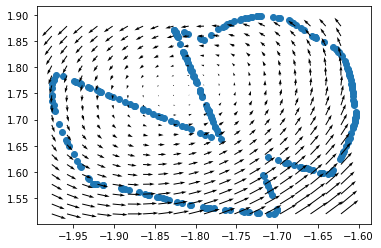

 10%|▉         | 1997/20000 [00:26<03:07, 96.20it/s]

EPOCH 2000.


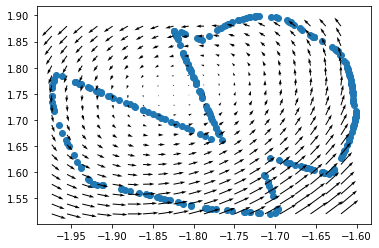

 10%|█         | 2095/20000 [00:28<03:06, 96.15it/s]

EPOCH 2100.


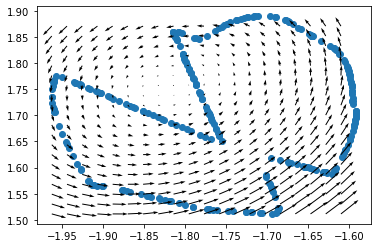

 11%|█         | 2193/20000 [00:29<03:04, 96.77it/s]

EPOCH 2200.


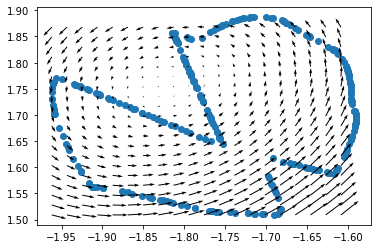

 11%|█▏        | 2290/20000 [00:30<03:15, 90.64it/s]

EPOCH 2300.


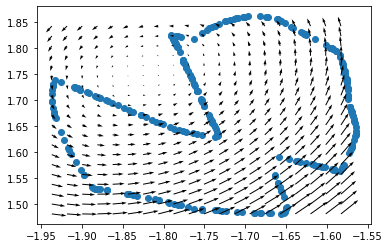

 12%|█▏        | 2400/20000 [00:32<03:00, 97.50it/s]

EPOCH 2400.


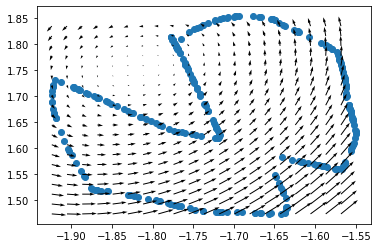

 12%|█▏        | 2499/20000 [00:33<02:59, 97.49it/s]

EPOCH 2500.


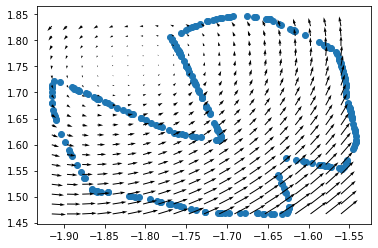

 13%|█▎        | 2598/20000 [00:34<02:58, 97.24it/s]

EPOCH 2600.


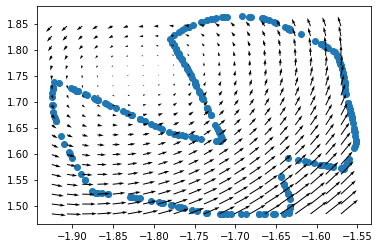

 13%|█▎        | 2697/20000 [00:36<02:59, 96.40it/s]

EPOCH 2700.


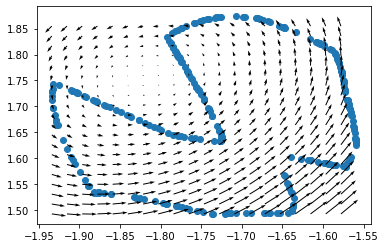

 14%|█▍        | 2796/20000 [00:37<02:58, 96.13it/s]

EPOCH 2800.


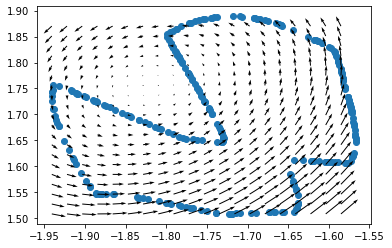

 14%|█▍        | 2895/20000 [00:38<02:58, 96.07it/s]

EPOCH 2900.


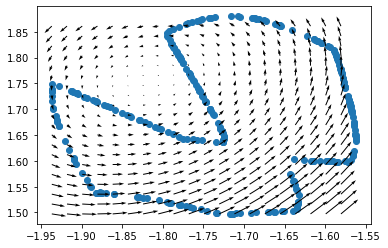

 15%|█▍        | 2992/20000 [00:39<02:58, 95.22it/s]

EPOCH 3000.


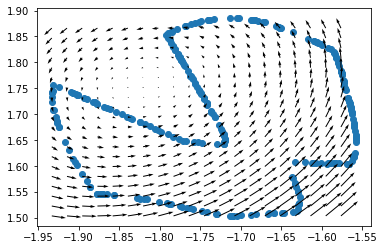

 15%|█▌        | 3099/20000 [00:41<02:59, 94.09it/s]

EPOCH 3100.


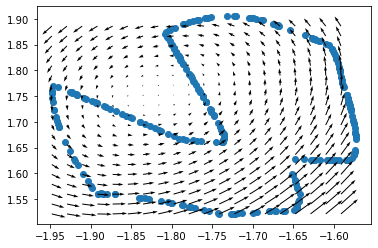

 16%|█▌        | 3195/20000 [00:42<02:56, 95.21it/s]

EPOCH 3200.


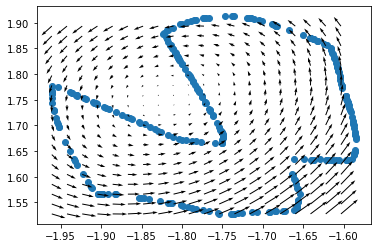

 16%|█▋        | 3292/20000 [00:44<02:54, 95.53it/s]

EPOCH 3300.


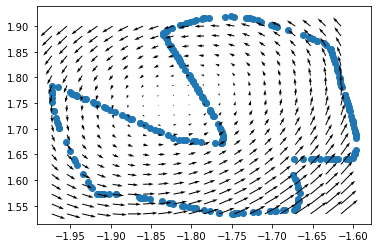

 17%|█▋        | 3400/20000 [00:45<02:51, 96.76it/s]

EPOCH 3400.


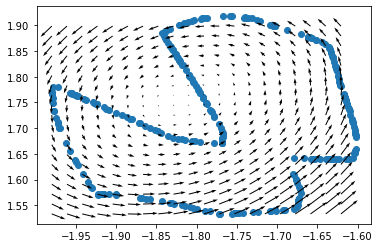

 17%|█▋        | 3498/20000 [00:46<02:52, 95.85it/s]

EPOCH 3500.


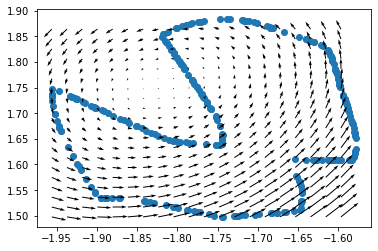

 18%|█▊        | 3596/20000 [00:48<02:51, 95.45it/s]

EPOCH 3600.


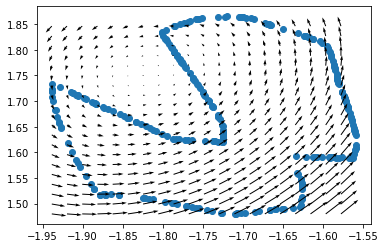

 18%|█▊        | 3694/20000 [00:49<02:50, 95.62it/s]

EPOCH 3700.


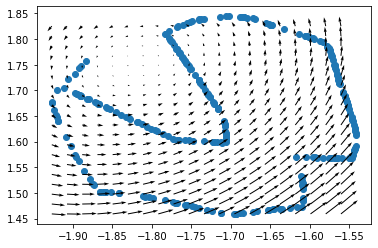

 19%|█▉        | 3792/20000 [00:50<02:49, 95.88it/s]

EPOCH 3800.


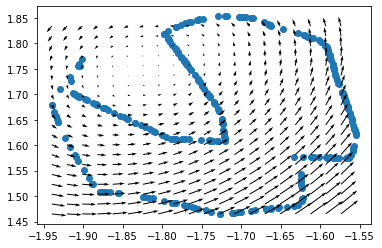

 19%|█▉        | 3890/20000 [00:51<02:48, 95.64it/s]

EPOCH 3900.


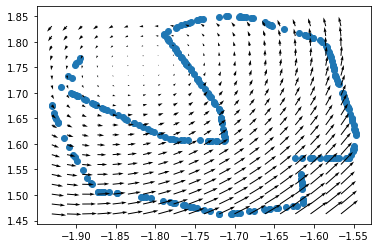

 20%|█▉        | 3999/20000 [00:53<02:51, 93.21it/s]

EPOCH 4000.


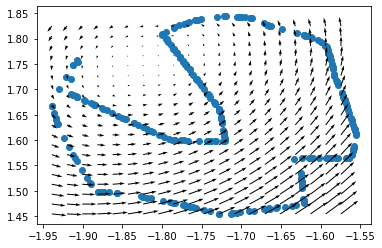

 20%|██        | 4097/20000 [00:54<02:45, 95.86it/s]

EPOCH 4100.


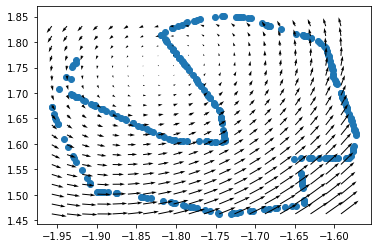

 21%|██        | 4191/20000 [00:56<02:46, 94.99it/s]

EPOCH 4200.


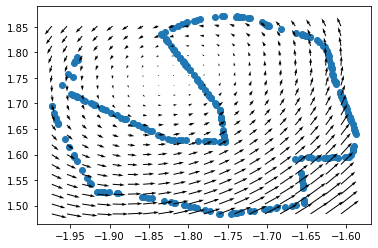

 22%|██▏       | 4300/20000 [00:57<02:41, 97.28it/s]

EPOCH 4300.


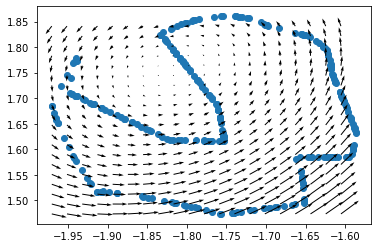

 22%|██▏       | 4398/20000 [00:58<02:43, 95.69it/s]

EPOCH 4400.


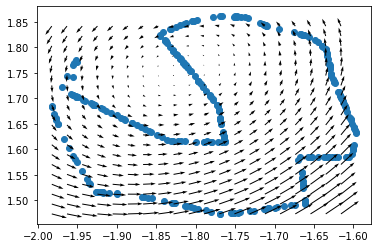

 22%|██▏       | 4495/20000 [01:00<02:42, 95.16it/s]

EPOCH 4500.


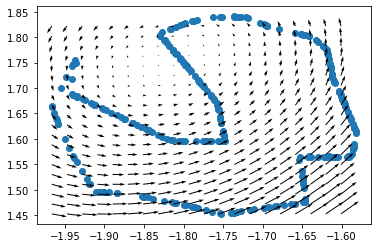

 23%|██▎       | 4593/20000 [01:01<02:39, 96.62it/s]

EPOCH 4600.


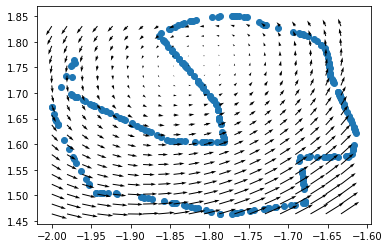

 23%|██▎       | 4692/20000 [01:02<02:38, 96.79it/s]

EPOCH 4700.


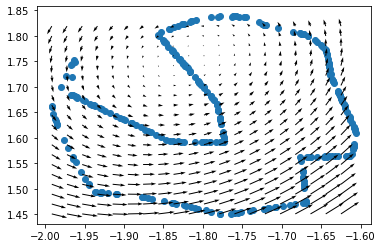

 24%|██▍       | 4791/20000 [01:04<02:37, 96.55it/s]

EPOCH 4800.


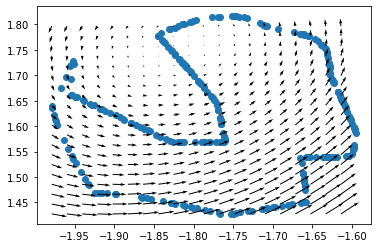

 24%|██▍       | 4900/20000 [01:05<02:36, 96.68it/s]

EPOCH 4900.


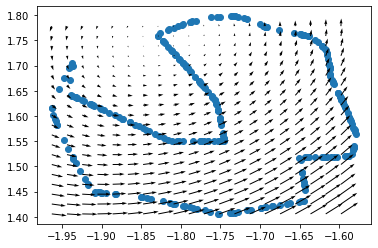

 25%|██▍       | 4995/20000 [01:06<02:49, 88.33it/s]

EPOCH 5000.


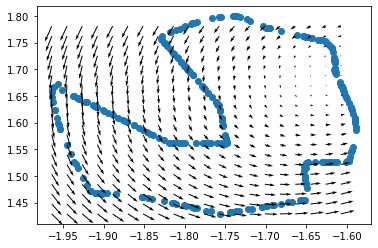

 25%|██▌       | 5093/20000 [01:08<03:27, 71.69it/s]

EPOCH 5100.


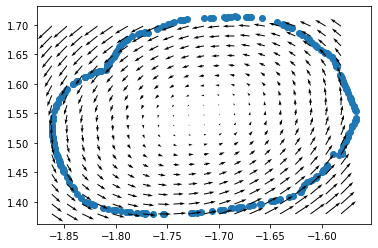

 26%|██▌       | 5197/20000 [01:10<03:25, 71.98it/s]

EPOCH 5200.


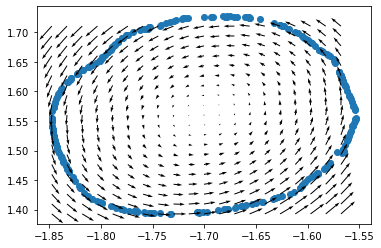

 26%|██▋       | 5293/20000 [01:11<03:24, 71.84it/s]

EPOCH 5300.


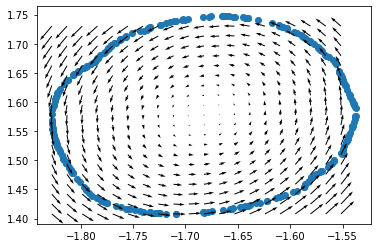

 27%|██▋       | 5397/20000 [01:13<03:22, 71.99it/s]

EPOCH 5400.


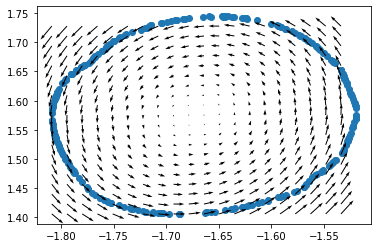

 27%|██▋       | 5493/20000 [01:15<03:22, 71.63it/s]

EPOCH 5500.


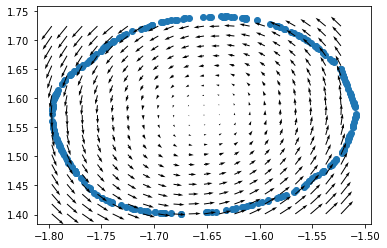

 28%|██▊       | 5597/20000 [01:17<03:21, 71.31it/s]

EPOCH 5600.


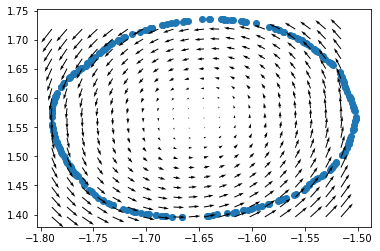

 28%|██▊       | 5693/20000 [01:18<03:19, 71.73it/s]

EPOCH 5700.


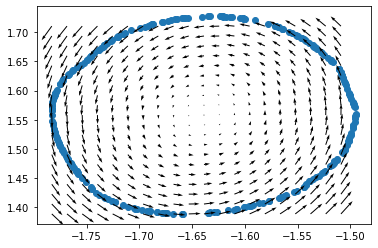

 29%|██▉       | 5797/20000 [01:20<03:17, 72.00it/s]

EPOCH 5800.


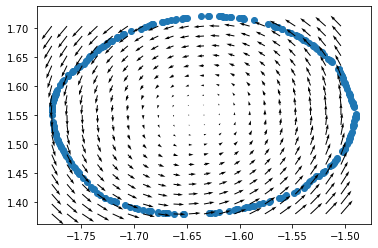

 29%|██▉       | 5893/20000 [01:22<03:17, 71.31it/s]

EPOCH 5900.


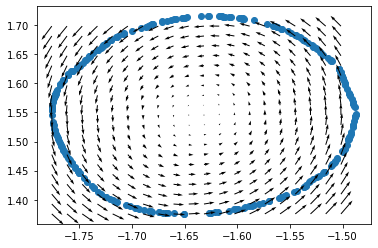

 30%|██▉       | 5997/20000 [01:23<03:14, 72.04it/s]

EPOCH 6000.


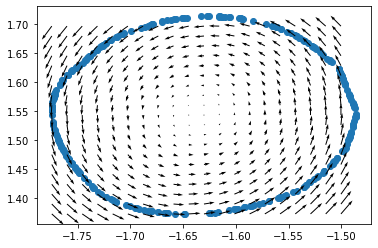

 30%|███       | 6093/20000 [01:25<03:14, 71.66it/s]

EPOCH 6100.


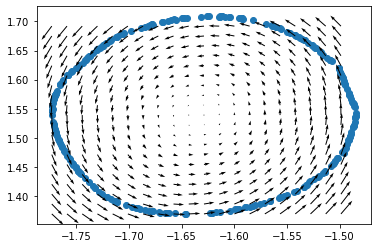

 31%|███       | 6197/20000 [01:27<03:11, 71.96it/s]

EPOCH 6200.


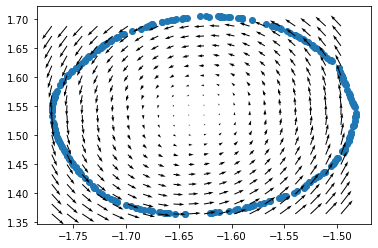

 31%|███▏      | 6293/20000 [01:28<03:11, 71.48it/s]

EPOCH 6300.


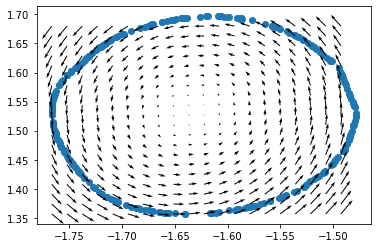

 32%|███▏      | 6397/20000 [01:30<03:09, 71.96it/s]

EPOCH 6400.


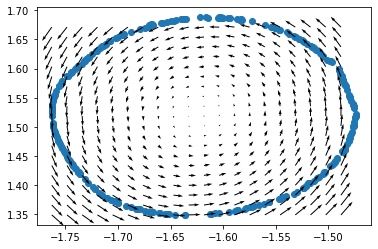

 32%|███▏      | 6493/20000 [01:32<03:08, 71.68it/s]

EPOCH 6500.


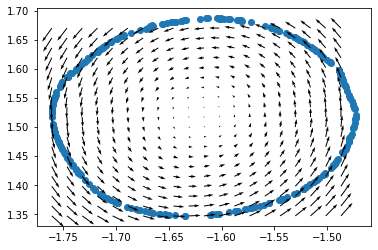

 33%|███▎      | 6597/20000 [01:33<03:05, 72.11it/s]

EPOCH 6600.


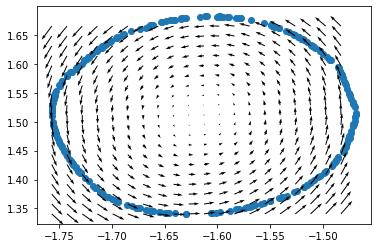

 33%|███▎      | 6693/20000 [01:35<03:05, 71.74it/s]

EPOCH 6700.


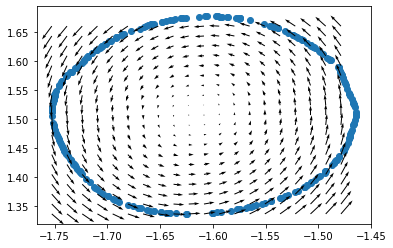

 34%|███▍      | 6797/20000 [01:37<03:03, 71.89it/s]

EPOCH 6800.


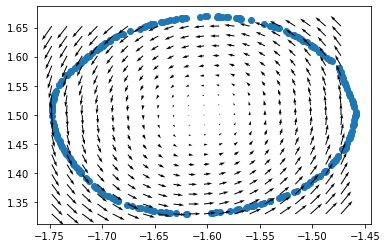

 34%|███▍      | 6893/20000 [01:39<03:01, 72.16it/s]

EPOCH 6900.


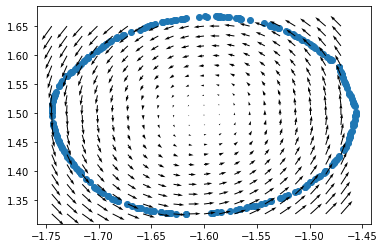

 35%|███▍      | 6997/20000 [01:40<03:00, 72.10it/s]

EPOCH 7000.


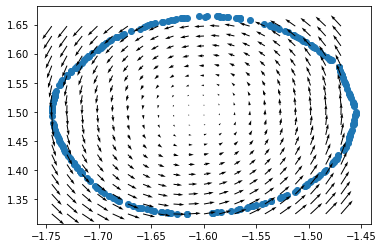

 35%|███▌      | 7093/20000 [01:42<02:59, 71.85it/s]

EPOCH 7100.


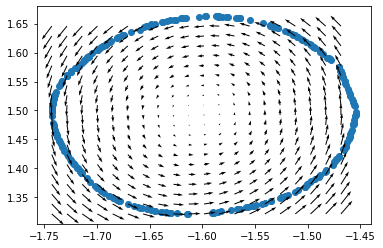

 36%|███▌      | 7197/20000 [01:44<02:57, 72.04it/s]

EPOCH 7200.


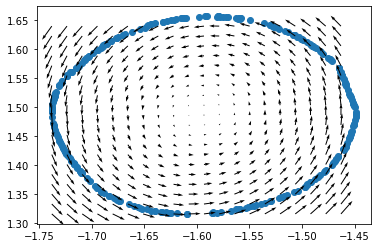

 36%|███▋      | 7293/20000 [01:45<02:57, 71.42it/s]

EPOCH 7300.


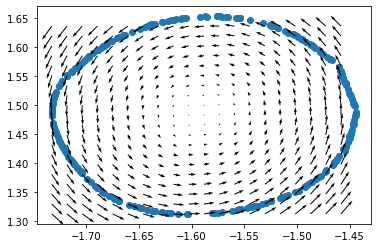

 37%|███▋      | 7397/20000 [01:47<02:55, 71.83it/s]

EPOCH 7400.


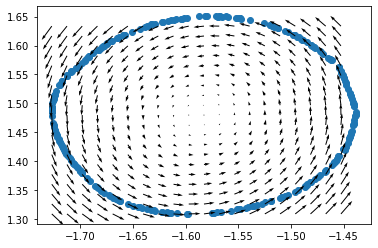

 37%|███▋      | 7493/20000 [01:49<02:56, 70.98it/s]

EPOCH 7500.


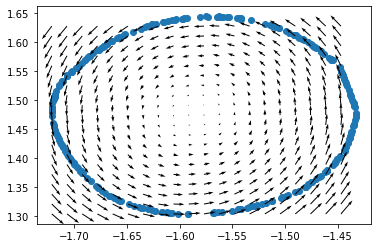

 38%|███▊      | 7597/20000 [01:50<02:51, 72.32it/s]

EPOCH 7600.


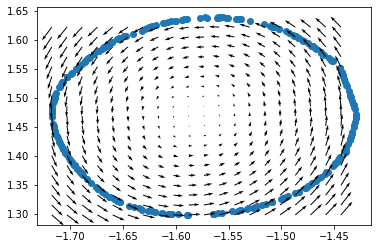

 38%|███▊      | 7693/20000 [01:52<02:52, 71.38it/s]

EPOCH 7700.


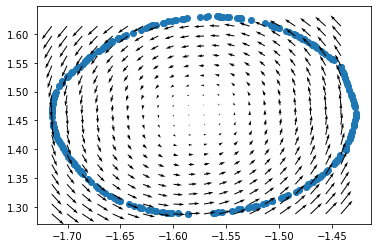

 39%|███▉      | 7797/20000 [01:54<02:50, 71.70it/s]

EPOCH 7800.


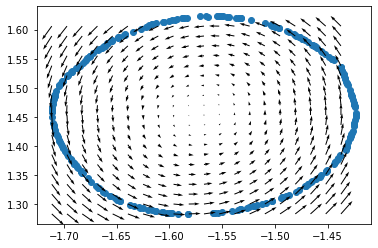

 39%|███▉      | 7893/20000 [01:55<02:49, 71.26it/s]

EPOCH 7900.


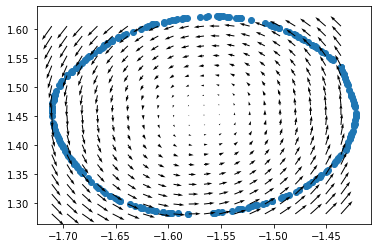

 40%|███▉      | 7997/20000 [01:57<02:47, 71.48it/s]

EPOCH 8000.


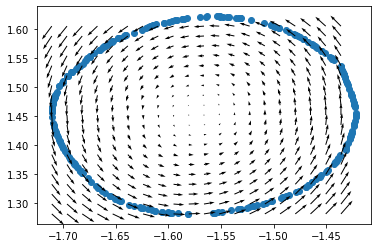

 40%|████      | 8093/20000 [01:59<02:48, 70.86it/s]

EPOCH 8100.


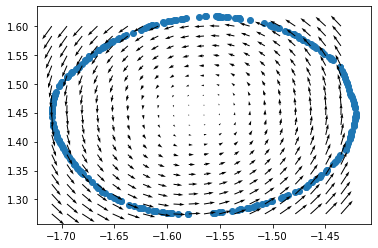

 41%|████      | 8197/20000 [02:00<02:45, 71.25it/s]

EPOCH 8200.


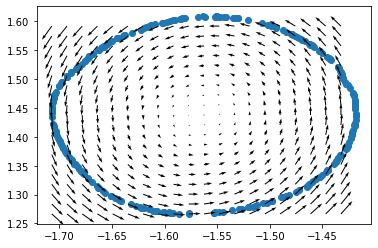

 41%|████▏     | 8293/20000 [02:02<02:44, 71.03it/s]

EPOCH 8300.


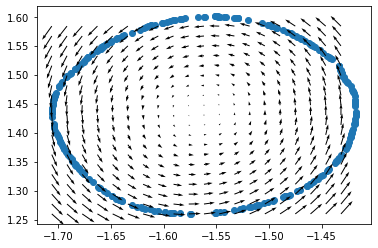

 42%|████▏     | 8397/20000 [02:04<02:43, 71.16it/s]

EPOCH 8400.


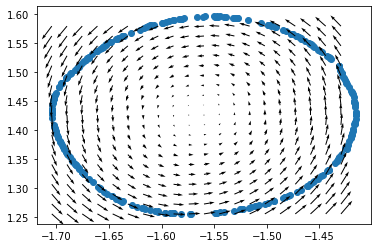

 42%|████▏     | 8493/20000 [02:06<02:41, 71.34it/s]

EPOCH 8500.


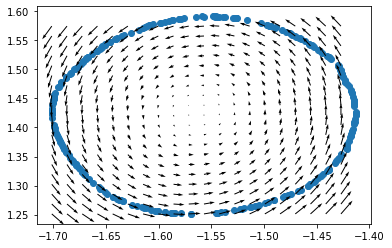

 43%|████▎     | 8597/20000 [02:07<02:40, 71.15it/s]

EPOCH 8600.


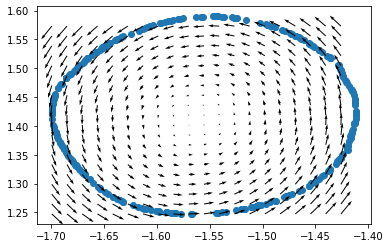

 43%|████▎     | 8693/20000 [02:09<02:38, 71.20it/s]

EPOCH 8700.


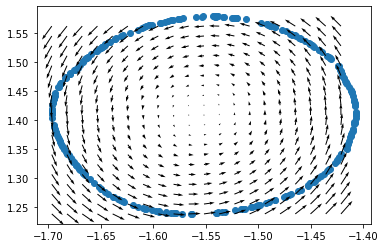

 44%|████▍     | 8797/20000 [02:11<02:36, 71.51it/s]

EPOCH 8800.


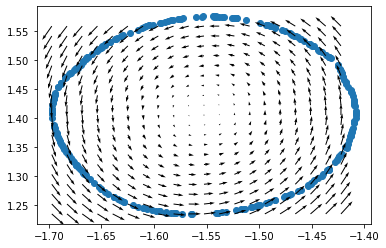

 44%|████▍     | 8893/20000 [02:13<02:34, 71.96it/s]

EPOCH 8900.


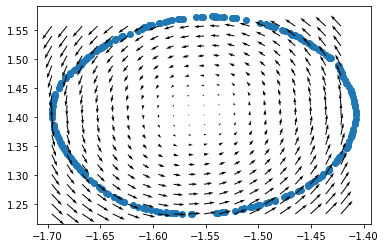

 45%|████▍     | 8997/20000 [02:14<02:34, 71.15it/s]

EPOCH 9000.


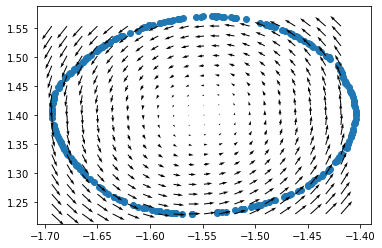

 45%|████▌     | 9093/20000 [02:16<02:33, 70.95it/s]

EPOCH 9100.


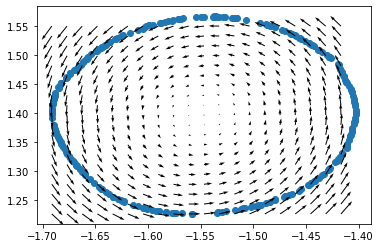

 46%|████▌     | 9197/20000 [02:18<02:31, 71.17it/s]

EPOCH 9200.


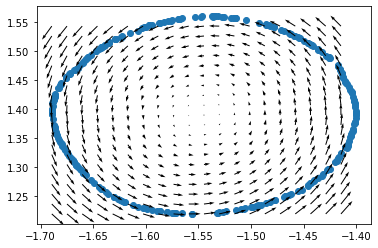

 46%|████▋     | 9300/20000 [02:19<02:30, 71.33it/s]

EPOCH 9300.


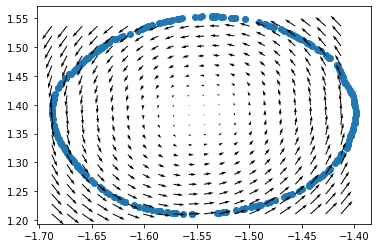

 47%|████▋     | 9396/20000 [02:21<02:29, 71.14it/s]

EPOCH 9400.


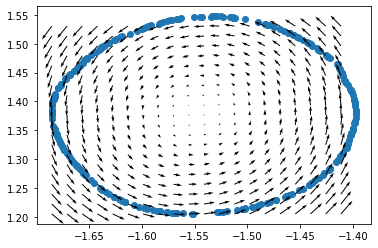

 48%|████▊     | 9500/20000 [02:23<02:26, 71.56it/s]

EPOCH 9500.


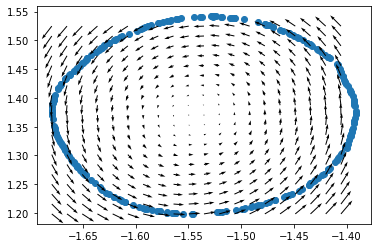

 48%|████▊     | 9596/20000 [02:24<02:26, 71.26it/s]

EPOCH 9600.


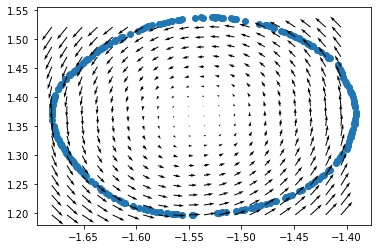

 48%|████▊     | 9700/20000 [02:26<02:24, 71.47it/s]

EPOCH 9700.


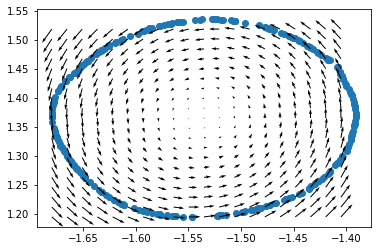

 49%|████▉     | 9796/20000 [02:28<02:23, 71.17it/s]

EPOCH 9800.


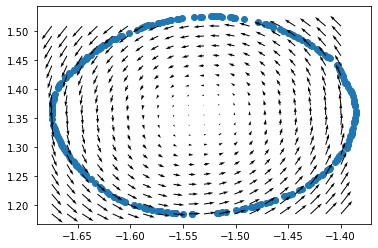

 50%|████▉     | 9900/20000 [02:30<02:22, 71.12it/s]

EPOCH 9900.


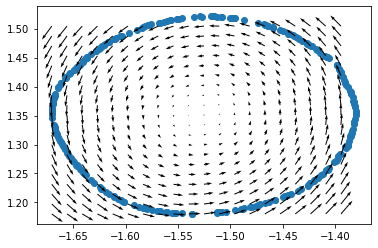

 50%|████▉     | 9996/20000 [02:31<02:18, 72.06it/s]

EPOCH 10000.


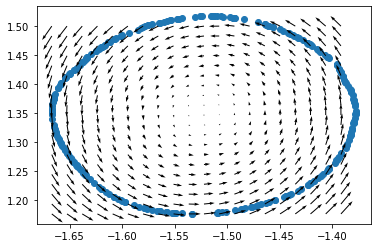

 50%|█████     | 10100/20000 [02:33<02:20, 70.55it/s]

EPOCH 10100.


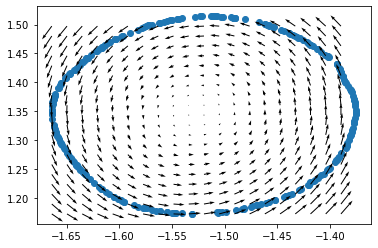

 51%|█████     | 10196/20000 [02:35<02:18, 70.83it/s]

EPOCH 10200.


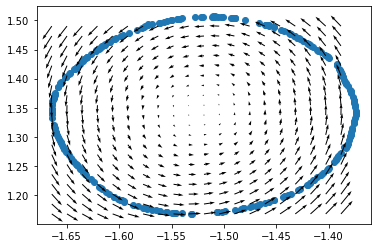

 52%|█████▏    | 10300/20000 [02:36<02:15, 71.40it/s]

EPOCH 10300.


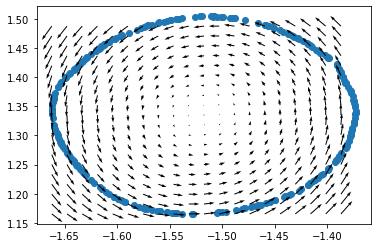

 52%|█████▏    | 10396/20000 [02:38<02:16, 70.50it/s]

EPOCH 10400.


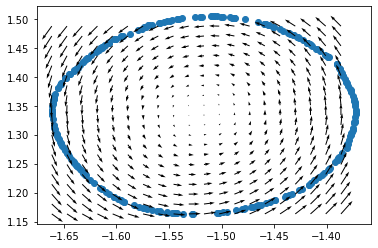

 52%|█████▎    | 10500/20000 [02:40<02:12, 71.92it/s]

EPOCH 10500.


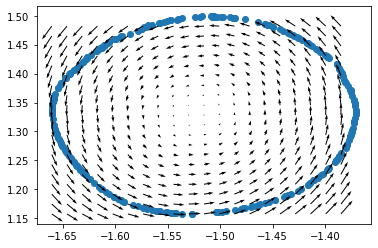

 53%|█████▎    | 10596/20000 [02:42<02:12, 71.18it/s]

EPOCH 10600.


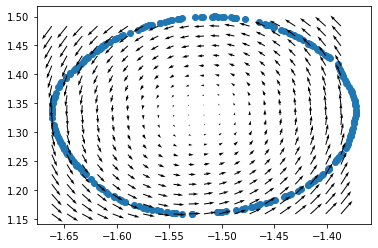

 54%|█████▎    | 10700/20000 [02:43<02:10, 71.48it/s]

EPOCH 10700.


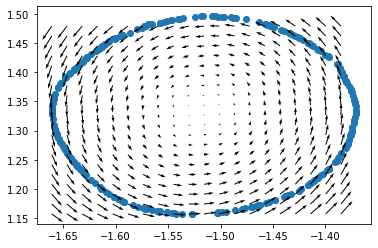

 54%|█████▍    | 10796/20000 [02:45<02:10, 70.47it/s]

EPOCH 10800.


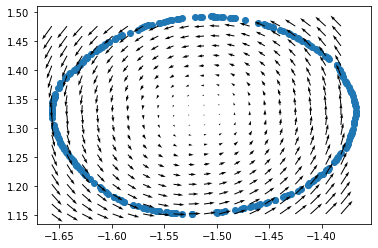

 55%|█████▍    | 10900/20000 [02:47<02:05, 72.30it/s]

EPOCH 10900.


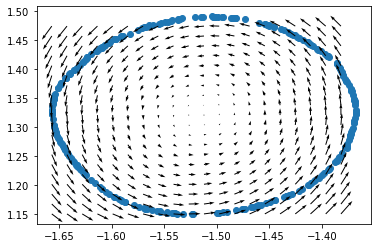

 55%|█████▍    | 10996/20000 [02:48<02:06, 71.19it/s]

EPOCH 11000.


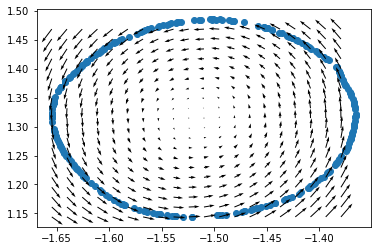

 56%|█████▌    | 11100/20000 [02:50<02:04, 71.32it/s]

EPOCH 11100.


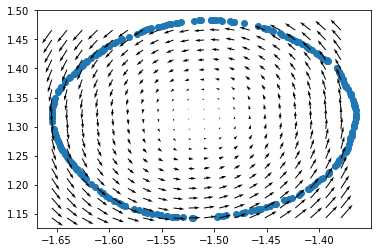

 56%|█████▌    | 11196/20000 [02:52<02:03, 71.16it/s]

EPOCH 11200.


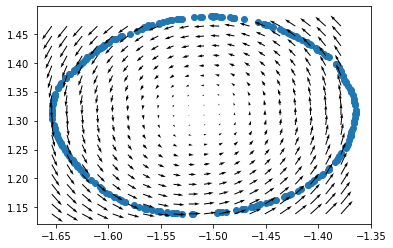

 56%|█████▋    | 11300/20000 [02:54<02:01, 71.58it/s]

EPOCH 11300.


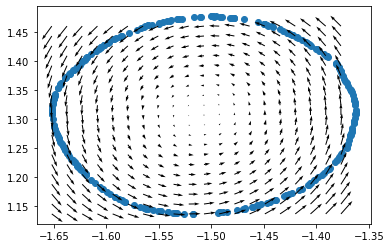

 57%|█████▋    | 11396/20000 [02:55<02:00, 71.13it/s]

EPOCH 11400.


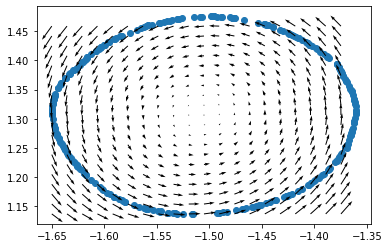

 57%|█████▊    | 11500/20000 [02:57<01:58, 71.58it/s]

EPOCH 11500.


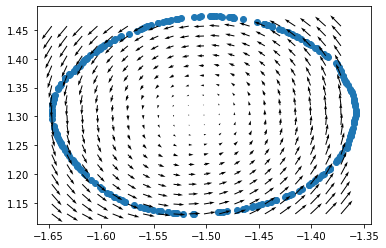

 58%|█████▊    | 11596/20000 [02:59<01:57, 71.25it/s]

EPOCH 11600.


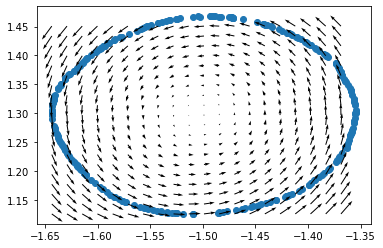

 58%|█████▊    | 11700/20000 [03:00<01:55, 71.74it/s]

EPOCH 11700.


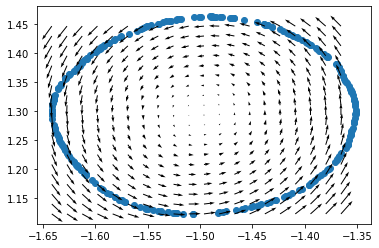

 59%|█████▉    | 11796/20000 [03:02<01:54, 71.79it/s]

EPOCH 11800.


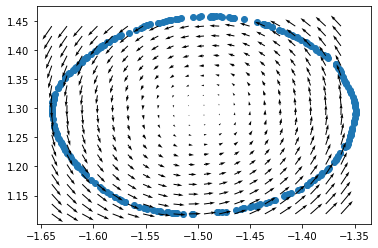

 60%|█████▉    | 11900/20000 [03:04<01:52, 72.31it/s]

EPOCH 11900.


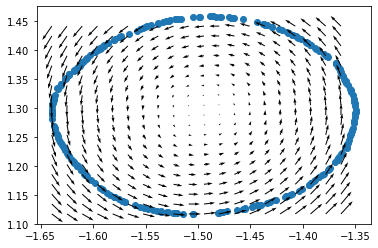

 60%|█████▉    | 11996/20000 [03:05<01:51, 71.90it/s]

EPOCH 12000.


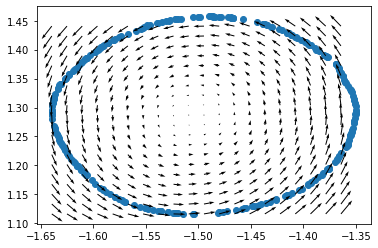

 60%|██████    | 12100/20000 [03:07<01:49, 72.24it/s]

EPOCH 12100.


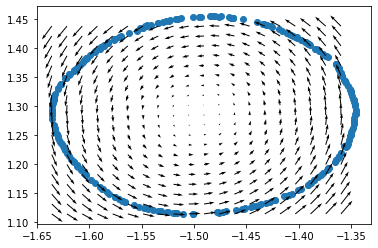

 61%|██████    | 12196/20000 [03:09<01:49, 71.31it/s]

EPOCH 12200.


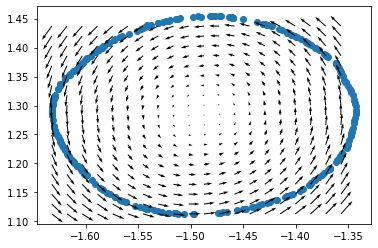

 62%|██████▏   | 12300/20000 [03:11<01:46, 72.47it/s]

EPOCH 12300.


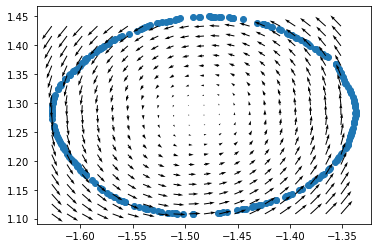

 62%|██████▏   | 12396/20000 [03:12<01:46, 71.23it/s]

EPOCH 12400.


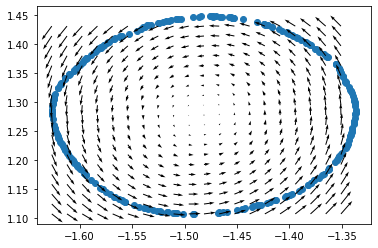

 62%|██████▎   | 12500/20000 [03:14<01:44, 71.80it/s]

EPOCH 12500.


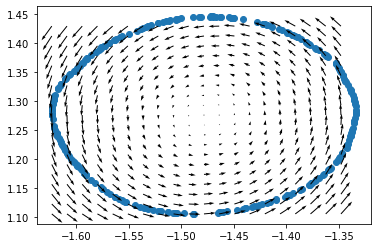

 63%|██████▎   | 12596/20000 [03:16<01:43, 71.51it/s]

EPOCH 12600.


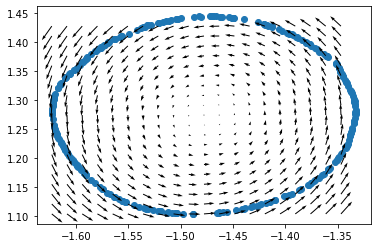

 64%|██████▎   | 12700/20000 [03:17<01:41, 72.27it/s]

EPOCH 12700.


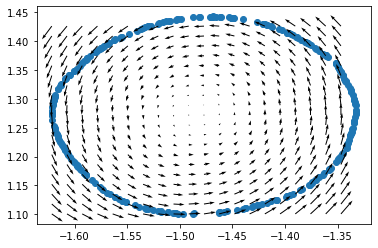

 64%|██████▍   | 12796/20000 [03:19<01:40, 71.91it/s]

EPOCH 12800.


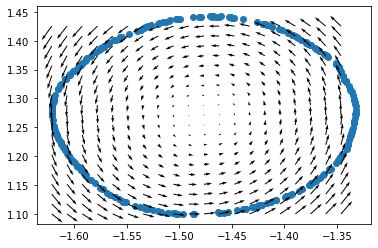

 64%|██████▍   | 12900/20000 [03:21<01:38, 72.10it/s]

EPOCH 12900.


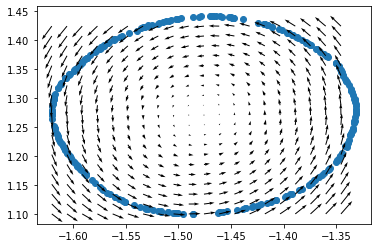

 65%|██████▍   | 12996/20000 [03:22<01:42, 68.31it/s]

EPOCH 13000.


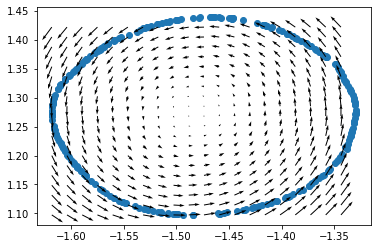

 65%|██████▌   | 13099/20000 [03:24<01:32, 74.38it/s]

EPOCH 13100.


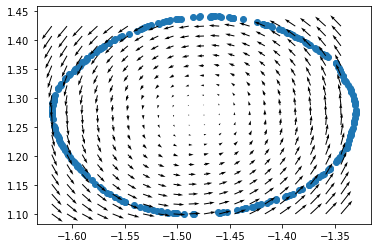

 66%|██████▌   | 13195/20000 [03:26<01:34, 71.80it/s]

EPOCH 13200.


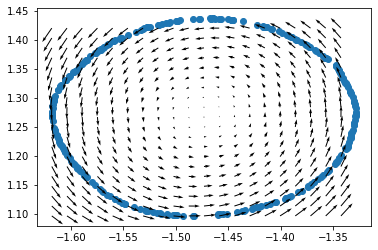

 66%|██████▋   | 13299/20000 [03:27<01:32, 72.12it/s]

EPOCH 13300.


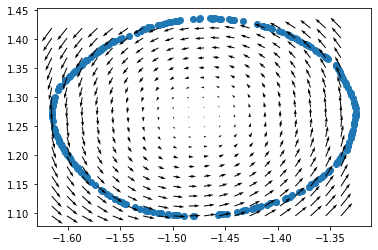

 67%|██████▋   | 13395/20000 [03:29<01:32, 71.77it/s]

EPOCH 13400.


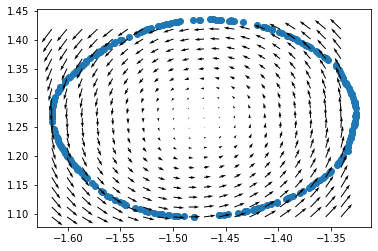

 67%|██████▋   | 13499/20000 [03:31<01:30, 71.98it/s]

EPOCH 13500.


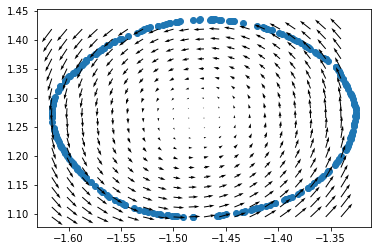

 68%|██████▊   | 13595/20000 [03:32<01:29, 71.73it/s]

EPOCH 13600.


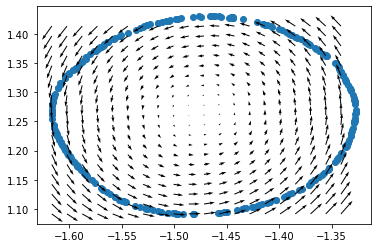

 68%|██████▊   | 13699/20000 [03:34<01:27, 72.20it/s]

EPOCH 13700.


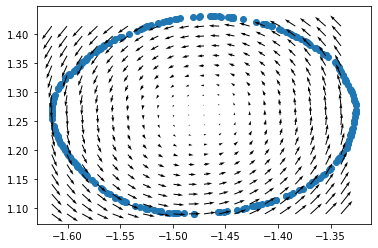

 69%|██████▉   | 13794/20000 [03:36<01:26, 71.64it/s]

EPOCH 13800.


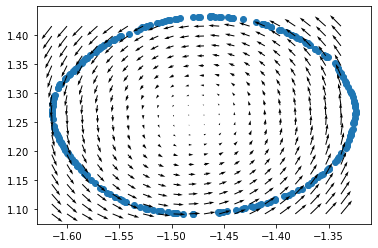

 69%|██████▉   | 13898/20000 [03:37<01:24, 72.45it/s]

EPOCH 13900.


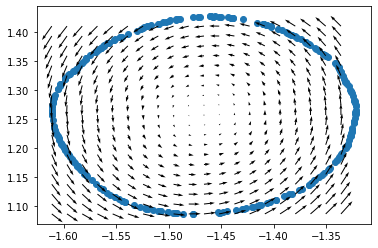

 70%|██████▉   | 13994/20000 [03:39<01:23, 72.24it/s]

EPOCH 14000.


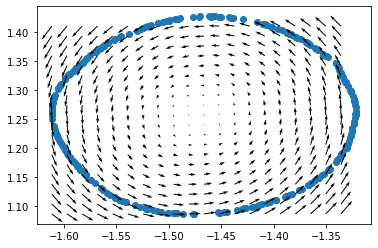

 70%|███████   | 14098/20000 [03:41<01:22, 71.74it/s]

EPOCH 14100.


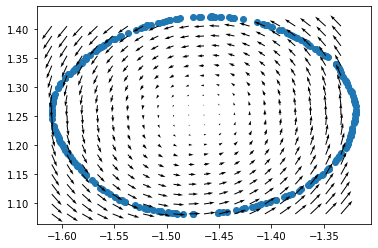

 71%|███████   | 14194/20000 [03:43<01:20, 72.30it/s]

EPOCH 14200.


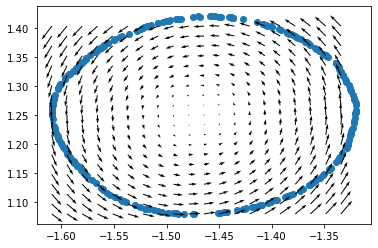

 71%|███████▏  | 14298/20000 [03:45<01:18, 72.37it/s]

EPOCH 14300.


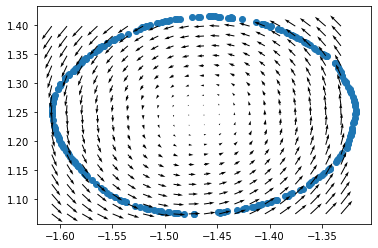

 72%|███████▏  | 14394/20000 [03:46<01:17, 72.20it/s]

EPOCH 14400.


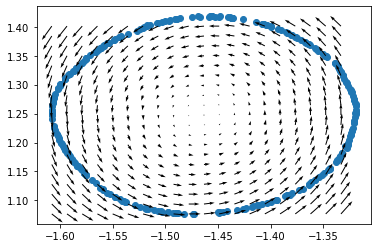

 72%|███████▏  | 14498/20000 [03:48<01:15, 72.43it/s]

EPOCH 14500.


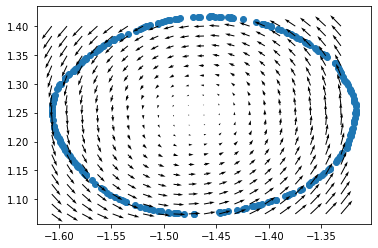

 73%|███████▎  | 14594/20000 [03:49<01:15, 72.01it/s]

EPOCH 14600.


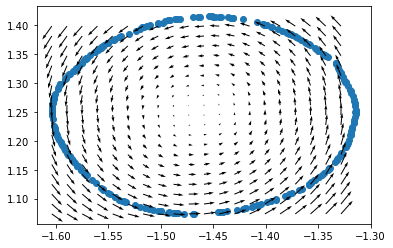

 73%|███████▎  | 14698/20000 [03:51<01:13, 72.38it/s]

EPOCH 14700.


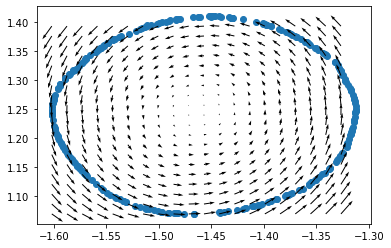

 74%|███████▍  | 14794/20000 [03:53<01:11, 72.74it/s]

EPOCH 14800.


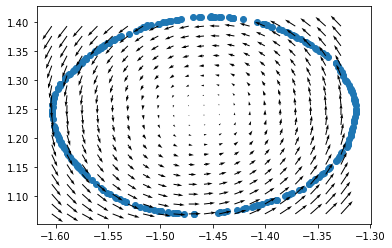

 74%|███████▍  | 14898/20000 [03:55<01:10, 72.38it/s]

EPOCH 14900.


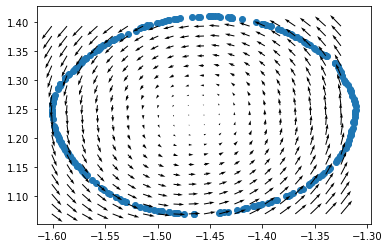

 75%|███████▍  | 14994/20000 [03:56<01:09, 72.11it/s]

EPOCH 15000.


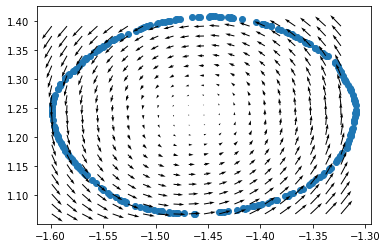

 75%|███████▌  | 15098/20000 [03:58<01:07, 72.55it/s]

EPOCH 15100.


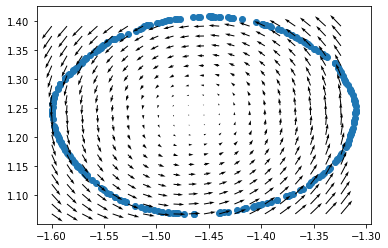

 76%|███████▌  | 15194/20000 [04:00<01:06, 72.15it/s]

EPOCH 15200.


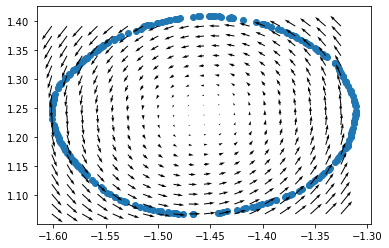

 76%|███████▋  | 15298/20000 [04:01<01:04, 72.50it/s]

EPOCH 15300.


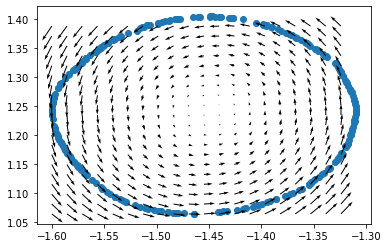

 77%|███████▋  | 15394/20000 [04:03<01:03, 72.31it/s]

EPOCH 15400.


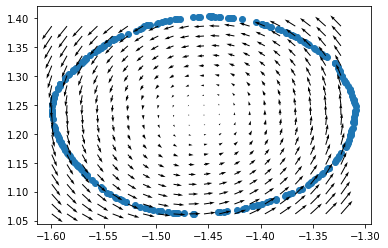

 77%|███████▋  | 15498/20000 [04:05<01:01, 72.68it/s]

EPOCH 15500.


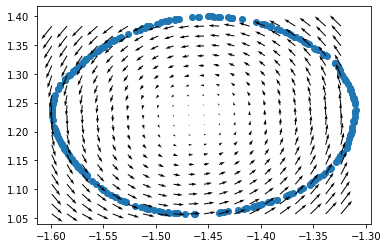

 78%|███████▊  | 15594/20000 [04:06<01:00, 72.55it/s]

EPOCH 15600.


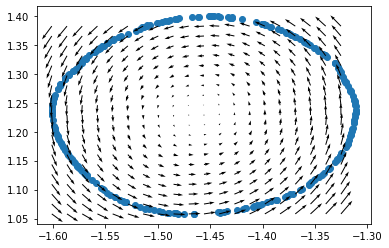

 78%|███████▊  | 15698/20000 [04:08<00:59, 72.56it/s]

EPOCH 15700.


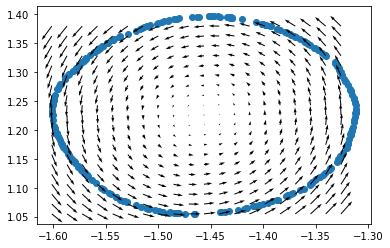

 79%|███████▉  | 15794/20000 [04:10<00:58, 72.36it/s]

EPOCH 15800.


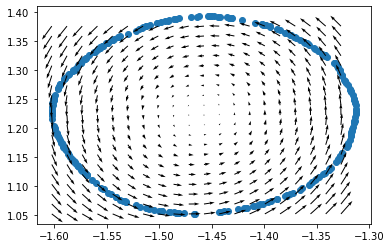

 79%|███████▉  | 15898/20000 [04:11<00:56, 72.67it/s]

EPOCH 15900.


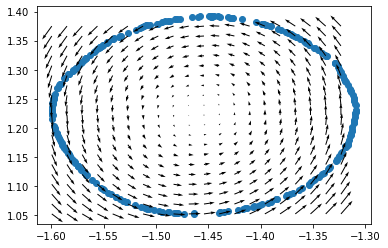

 80%|███████▉  | 15994/20000 [04:13<00:55, 72.40it/s]

EPOCH 16000.


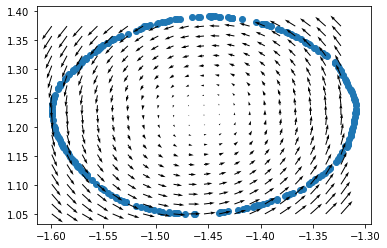

 80%|████████  | 16098/20000 [04:15<00:53, 72.87it/s]

EPOCH 16100.


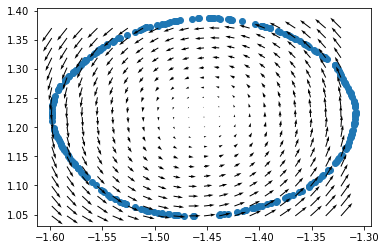

 81%|████████  | 16194/20000 [04:16<00:52, 72.11it/s]

EPOCH 16200.


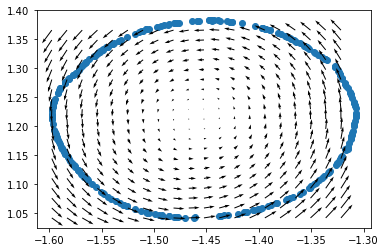

 81%|████████▏ | 16298/20000 [04:18<00:51, 72.51it/s]

EPOCH 16300.


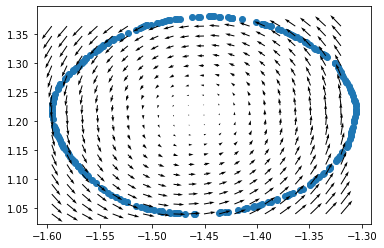

 82%|████████▏ | 16394/20000 [04:20<00:50, 71.84it/s]

EPOCH 16400.


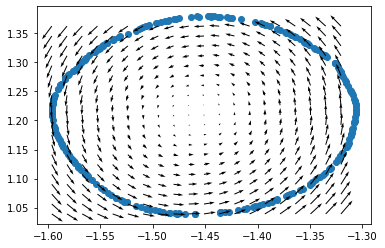

 82%|████████▏ | 16498/20000 [04:22<00:48, 72.12it/s]

EPOCH 16500.


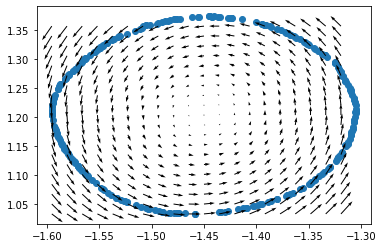

 83%|████████▎ | 16594/20000 [04:23<00:47, 71.84it/s]

EPOCH 16600.


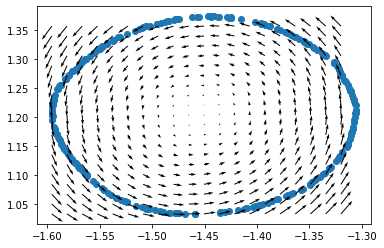

 83%|████████▎ | 16698/20000 [04:25<00:45, 72.23it/s]

EPOCH 16700.


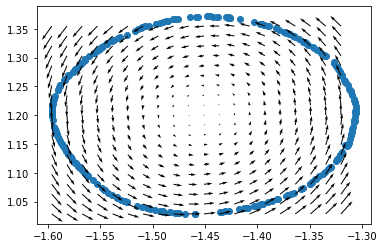

 84%|████████▍ | 16794/20000 [04:26<00:44, 71.77it/s]

EPOCH 16800.


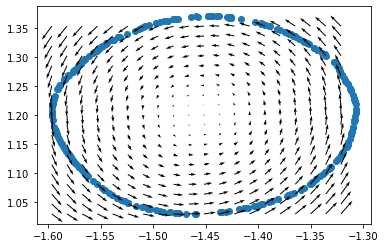

 84%|████████▍ | 16898/20000 [04:28<00:43, 72.11it/s]

EPOCH 16900.


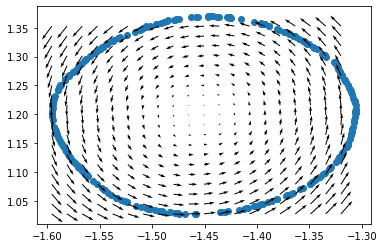

 85%|████████▍ | 16994/20000 [04:30<00:41, 71.74it/s]

EPOCH 17000.


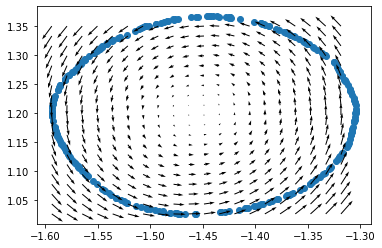

 85%|████████▌ | 17098/20000 [04:32<00:40, 72.11it/s]

EPOCH 17100.


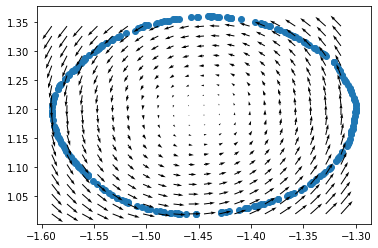

 86%|████████▌ | 17194/20000 [04:33<00:39, 71.73it/s]

EPOCH 17200.


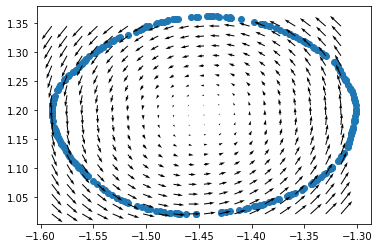

 86%|████████▋ | 17298/20000 [04:35<00:37, 72.43it/s]

EPOCH 17300.


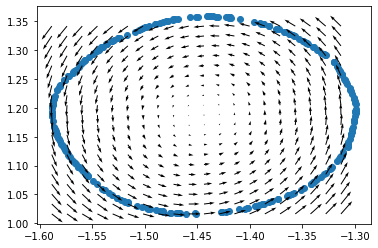

 87%|████████▋ | 17394/20000 [04:37<00:36, 71.57it/s]

EPOCH 17400.


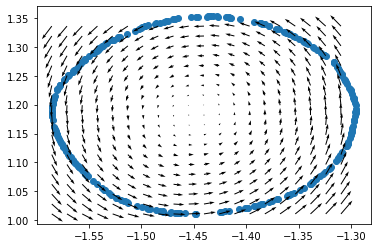

 87%|████████▋ | 17498/20000 [04:38<00:34, 72.23it/s]

EPOCH 17500.


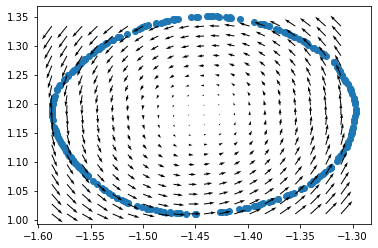

 88%|████████▊ | 17594/20000 [04:40<00:33, 71.79it/s]

EPOCH 17600.


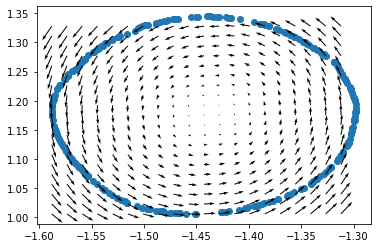

 88%|████████▊ | 17698/20000 [04:42<00:31, 72.16it/s]

EPOCH 17700.


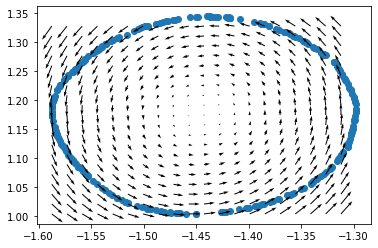

 89%|████████▉ | 17794/20000 [04:43<00:30, 71.84it/s]

EPOCH 17800.


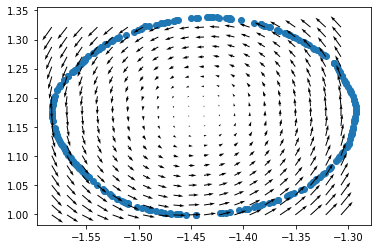

 89%|████████▉ | 17898/20000 [04:45<00:29, 71.37it/s]

EPOCH 17900.


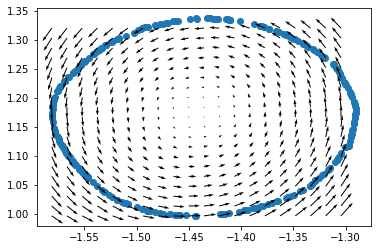

 90%|████████▉ | 17994/20000 [04:47<00:27, 71.82it/s]

EPOCH 18000.


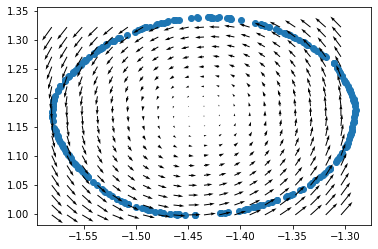

 90%|█████████ | 18098/20000 [04:49<00:26, 71.93it/s]

EPOCH 18100.


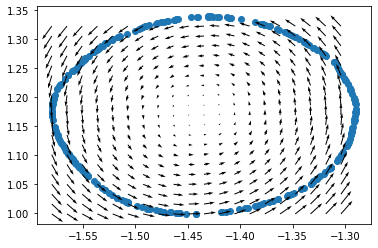

 91%|█████████ | 18194/20000 [04:50<00:25, 71.75it/s]

EPOCH 18200.


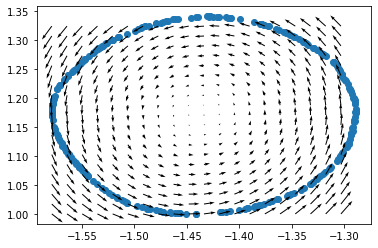

 91%|█████████▏| 18298/20000 [04:52<00:23, 71.86it/s]

EPOCH 18300.


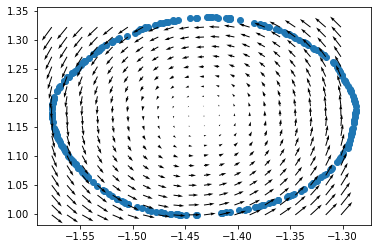

 92%|█████████▏| 18394/20000 [04:54<00:22, 71.84it/s]

EPOCH 18400.


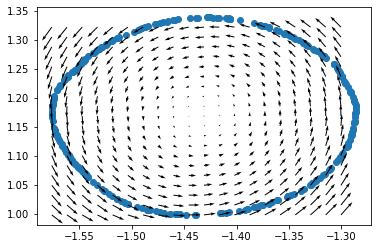

 92%|█████████▏| 18498/20000 [04:56<00:20, 72.27it/s]

EPOCH 18500.


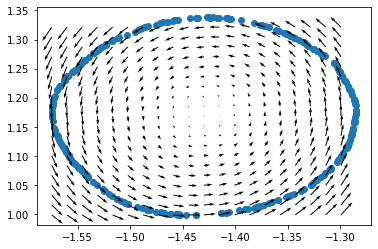

 93%|█████████▎| 18594/20000 [04:57<00:19, 71.95it/s]

EPOCH 18600.


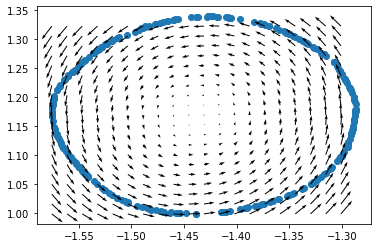

 93%|█████████▎| 18698/20000 [04:59<00:17, 72.34it/s]

EPOCH 18700.


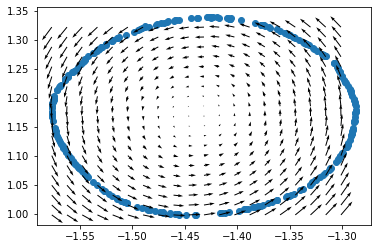

 94%|█████████▍| 18794/20000 [05:01<00:16, 72.01it/s]

EPOCH 18800.


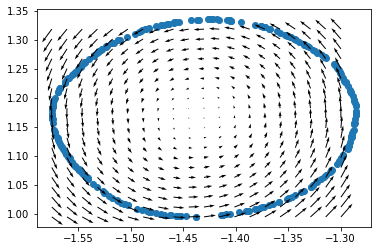

 94%|█████████▍| 18898/20000 [05:02<00:15, 72.16it/s]

EPOCH 18900.


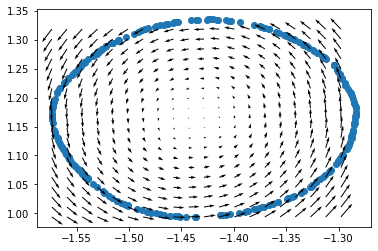

 95%|█████████▍| 18994/20000 [05:04<00:13, 72.11it/s]

EPOCH 19000.


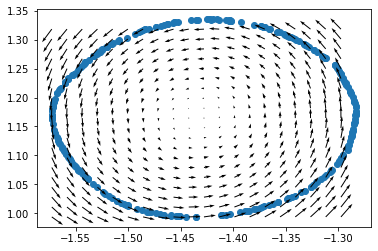

 95%|█████████▌| 19098/20000 [05:06<00:12, 72.40it/s]

EPOCH 19100.


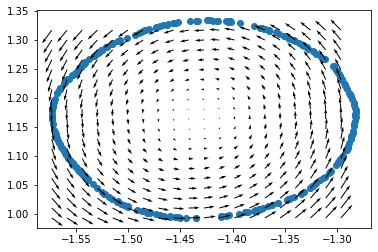

 96%|█████████▌| 19194/20000 [05:07<00:11, 72.10it/s]

EPOCH 19200.


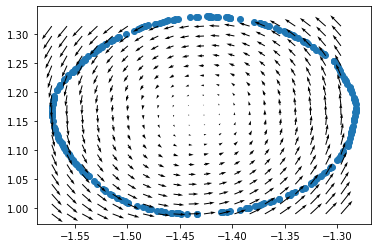

 96%|█████████▋| 19298/20000 [05:09<00:09, 72.27it/s]

EPOCH 19300.


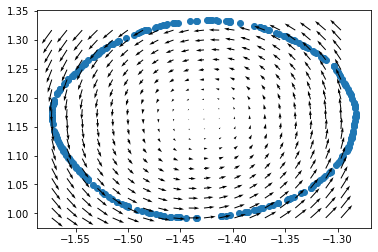

 97%|█████████▋| 19394/20000 [05:11<00:08, 72.10it/s]

EPOCH 19400.


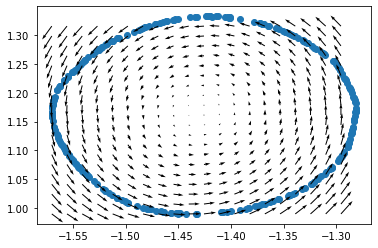

 97%|█████████▋| 19498/20000 [05:12<00:06, 72.64it/s]

EPOCH 19500.


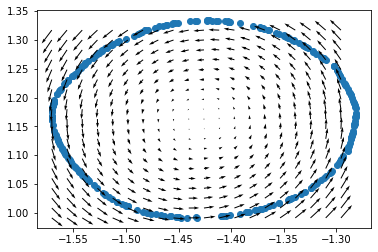

 98%|█████████▊| 19594/20000 [05:14<00:05, 71.75it/s]

EPOCH 19600.


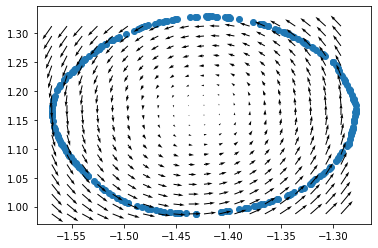

 98%|█████████▊| 19698/20000 [05:16<00:04, 72.31it/s]

EPOCH 19700.


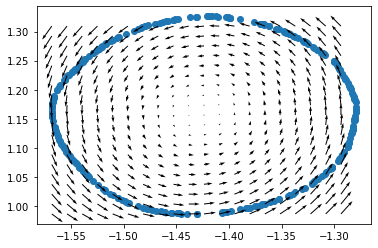

 99%|█████████▉| 19794/20000 [05:17<00:02, 72.26it/s]

EPOCH 19800.


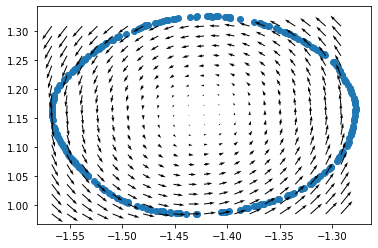

 99%|█████████▉| 19898/20000 [05:19<00:01, 72.19it/s]

EPOCH 19900.


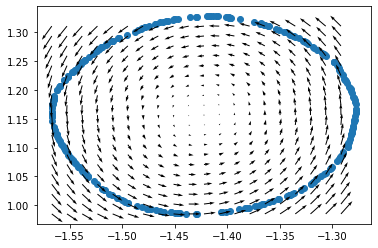

100%|██████████| 20000/20000 [05:21<00:00, 62.22it/s]


In [25]:
FE.fit(n_steps = 20000)

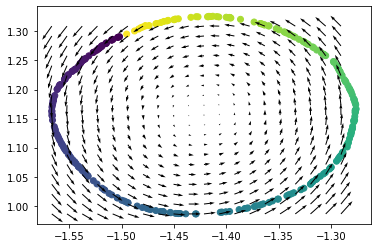

In [26]:
FE.visualize_points(labels)

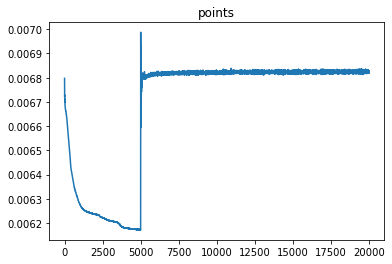

In [27]:
FE.visualize_loss("points")

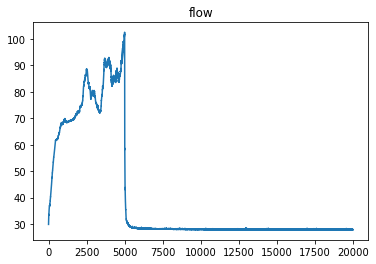

In [28]:
FE.visualize_loss("flow")

In [23]:
for w in FE.embedder.parameters():
    print(w)

Parameter containing:
tensor([[-0.5784,  0.1342, -0.3991],
        [ 0.2042, -0.1896,  0.2555],
        [-0.4655, -0.4289,  0.3062],
        [ 0.3660, -0.6293, -0.0561]], device='cuda:0', requires_grad=True)
Parameter containing:
tensor([ 0.8334, -0.2344,  0.3815, -0.1534], device='cuda:0',
       requires_grad=True)
Parameter containing:
tensor([[ 0.1427, -0.4856,  0.0205,  0.4970],
        [ 0.2098, -0.3671,  0.3762, -0.3932],
        [-0.3958, -0.9551, -0.1646,  0.2587],
        [ 0.8857, -0.9234, -0.3614,  0.1607],
        [ 0.1207,  0.5504, -0.3704, -0.2498],
        [-0.2958,  0.5103,  0.4685, -0.0775],
        [ 0.3566,  0.1596, -0.3194, -0.1472],
        [ 0.6427, -0.4520, -0.4550, -0.5174]], device='cuda:0',
       requires_grad=True)
Parameter containing:
tensor([ 0.0132, -0.6575,  0.1218,  0.0106,  0.2112, -0.4020,  0.5019, -0.3920],
       device='cuda:0', requires_grad=True)
Parameter containing:
tensor([[-0.0908,  0.2780, -0.1103,  0.2238,  0.3009, -0.5311,  0.5388,  0.90

In [24]:
for w in FE.FlowArtist.parameters():
    print(w)

Parameter containing:
tensor([[ 1.7489, -0.2066],
        [-0.3994, -1.2795],
        [ 2.4843,  1.2429],
        [-0.2959,  0.6723]], device='cuda:0', requires_grad=True)
Parameter containing:
tensor([ 0.1621, -0.3109, -0.3776,  0.2448], device='cuda:0',
       requires_grad=True)
Parameter containing:
tensor([[ 0.9714, -0.0423,  0.6532, -0.2829],
        [ 0.7734,  0.0935,  0.0700, -0.7035],
        [ 0.2268, -0.3696, -1.0275,  0.0727],
        [-0.6113, -0.4376, -0.6182,  0.6062],
        [ 0.4382, -0.1881,  1.4975, -0.1129],
        [ 1.7312, -1.0682,  4.4002,  0.3043],
        [-0.3952,  0.5733, -1.0089, -0.4061],
        [ 0.2293,  0.2913, -0.3191, -0.6506]], device='cuda:0',
       requires_grad=True)
Parameter containing:
tensor([-0.3495, -0.1006, -0.2129,  0.0946,  0.4158, -0.2686, -0.2135, -0.5381],
       device='cuda:0', requires_grad=True)
Parameter containing:
tensor([[-0.4107, -0.1679,  0.7453,  0.2220, -0.2663, -0.5353,  0.0203, -0.0453],
        [ 0.0044,  0.2016,  0.2

## Testing on Tree Branch

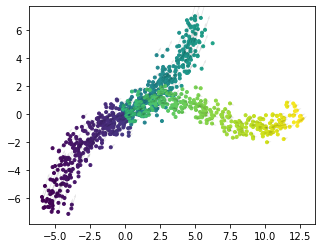

In [44]:
from directed_graphs.datasets import directed_sinh_branch, plot_directed_2d
X, flow, labels = directed_sinh_branch(num_nodes=1000, xscale=2, yscale=1, sigma=0.5)
plot_directed_2d(X, flow, labels)
X = torch.tensor(X).float().to(device)
flow = torch.tensor(flow).float().to(device)

In [37]:
print(X.shape)
print(flow.shape)

torch.Size([1000, 3])
torch.Size([1000, 3])


In [45]:
FE = FlowEmbedder(X,
                  flow,
                  FAShape=(2, 4, 8, 4, 2),
                  EncShape=(3, 4, 8, 4, 2),
                  knn = 10,
                  device = device).to(device)

  0%|          | 0/15000 [00:00<?, ?it/s]

EPOCH 0.


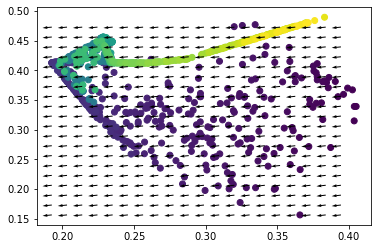

  1%|          | 96/15000 [00:01<03:30, 70.90it/s] 

EPOCH 100.


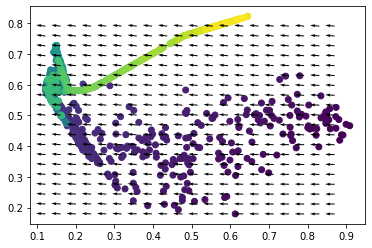

  1%|▏         | 200/15000 [00:03<03:31, 69.90it/s]

EPOCH 200.


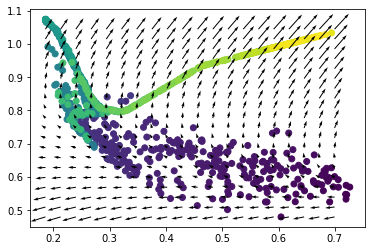

  2%|▏         | 296/15000 [00:05<03:30, 69.80it/s]

EPOCH 300.


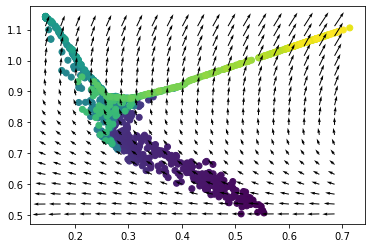

  3%|▎         | 400/15000 [00:07<03:26, 70.57it/s]

EPOCH 400.


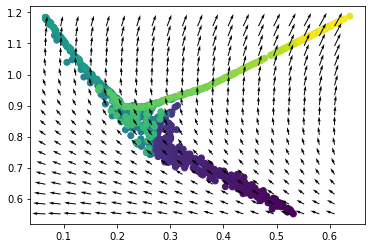

  3%|▎         | 496/15000 [00:08<03:26, 70.29it/s]

EPOCH 500.


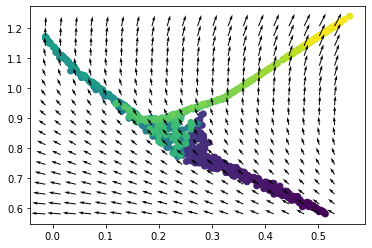

  4%|▍         | 600/15000 [00:10<03:22, 71.27it/s]

EPOCH 600.


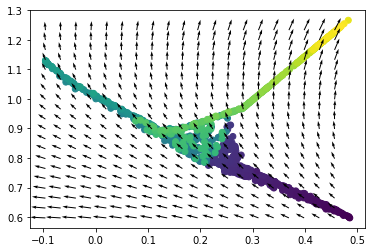

  5%|▍         | 696/15000 [00:12<03:23, 70.42it/s]

EPOCH 700.


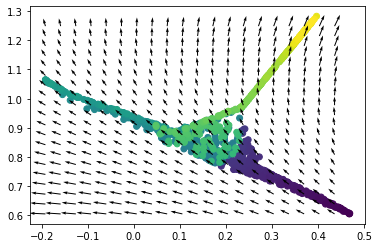

  5%|▌         | 800/15000 [00:14<03:19, 71.09it/s]

EPOCH 800.


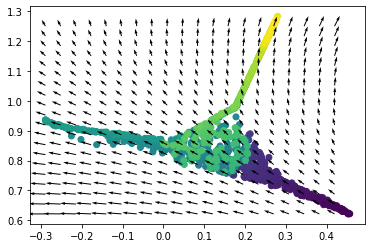

  6%|▌         | 894/15000 [00:15<03:20, 70.36it/s]

EPOCH 900.


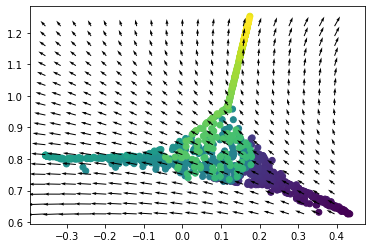

  7%|▋         | 998/15000 [00:17<03:15, 71.58it/s]

EPOCH 1000.


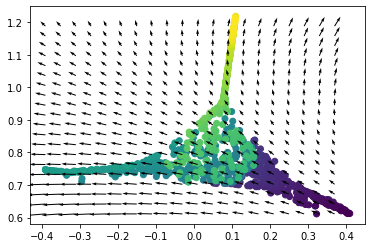

  7%|▋         | 1094/15000 [00:19<03:15, 71.23it/s]

EPOCH 1100.


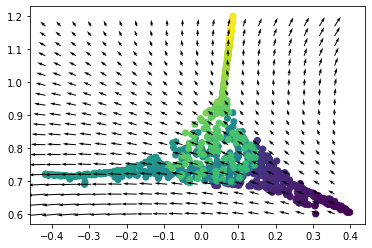

  8%|▊         | 1198/15000 [00:21<03:13, 71.25it/s]

EPOCH 1200.


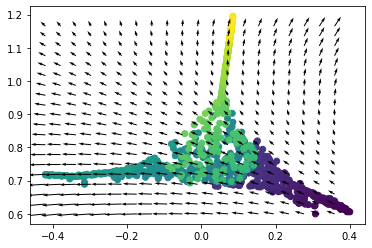

  9%|▊         | 1294/15000 [00:23<03:12, 71.05it/s]

EPOCH 1300.


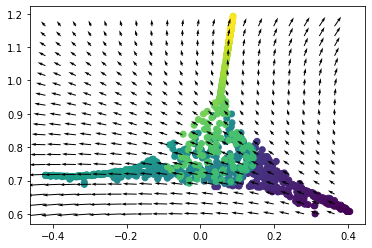

  9%|▉         | 1398/15000 [00:24<03:11, 70.92it/s]

EPOCH 1400.


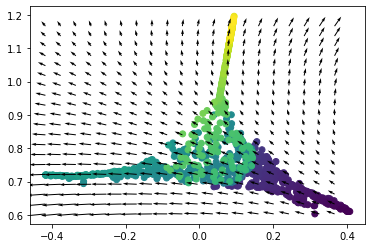

 10%|▉         | 1494/15000 [00:26<03:10, 70.82it/s]

EPOCH 1500.


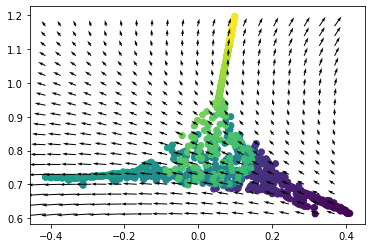

 11%|█         | 1598/15000 [00:28<03:08, 71.07it/s]

EPOCH 1600.


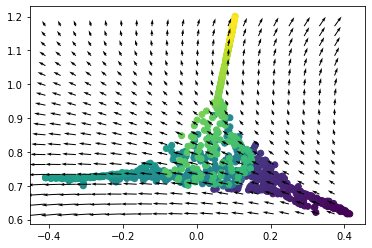

 11%|█▏        | 1694/15000 [00:30<03:08, 70.72it/s]

EPOCH 1700.


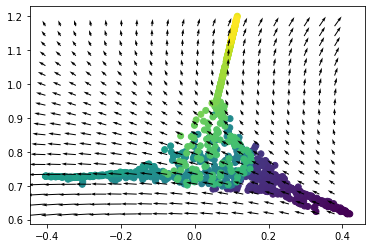

 12%|█▏        | 1798/15000 [00:31<03:04, 71.50it/s]

EPOCH 1800.


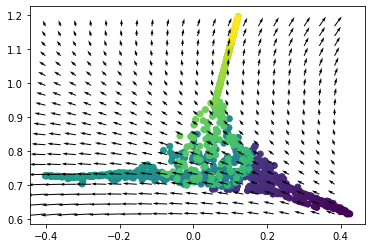

 13%|█▎        | 1894/15000 [00:33<03:04, 71.07it/s]

EPOCH 1900.


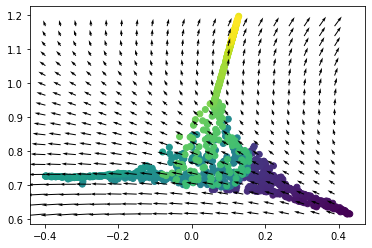

 13%|█▎        | 1998/15000 [00:35<03:03, 71.02it/s]

EPOCH 2000.


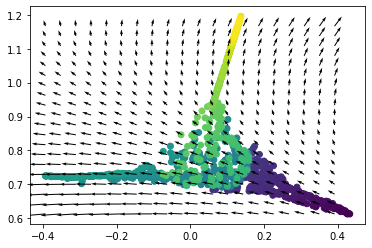

 14%|█▍        | 2094/15000 [00:37<03:02, 70.55it/s]

EPOCH 2100.


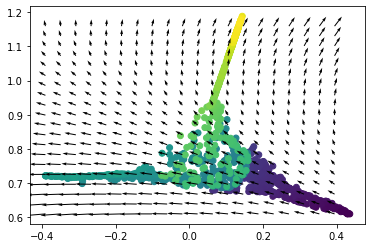

 15%|█▍        | 2197/15000 [00:38<02:59, 71.35it/s]

EPOCH 2200.


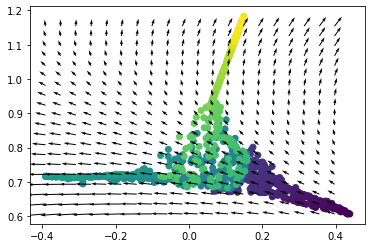

 15%|█▌        | 2293/15000 [00:40<02:58, 71.05it/s]

EPOCH 2300.


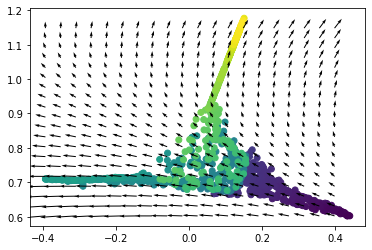

 16%|█▌        | 2397/15000 [00:42<02:55, 71.71it/s]

EPOCH 2400.


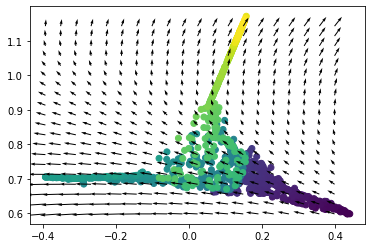

 17%|█▋        | 2493/15000 [00:43<02:56, 70.92it/s]

EPOCH 2500.


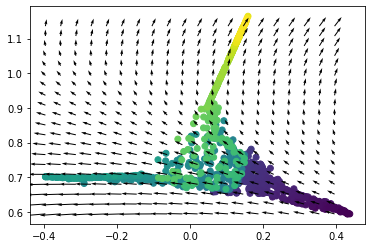

 17%|█▋        | 2597/15000 [00:45<02:55, 70.70it/s]

EPOCH 2600.


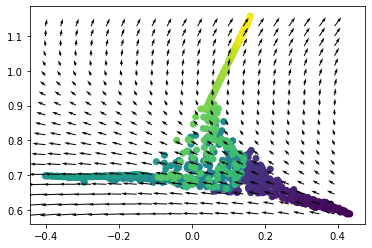

 18%|█▊        | 2693/15000 [00:47<02:53, 70.93it/s]

EPOCH 2700.


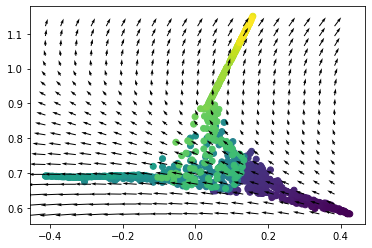

 19%|█▊        | 2797/15000 [00:49<02:50, 71.39it/s]

EPOCH 2800.


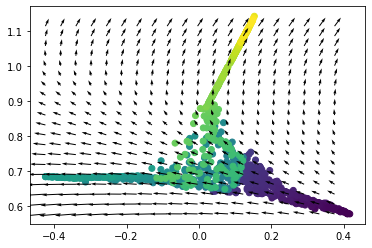

 19%|█▉        | 2893/15000 [00:51<02:49, 71.28it/s]

EPOCH 2900.


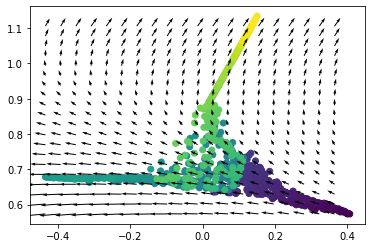

 20%|█▉        | 2997/15000 [00:52<02:47, 71.48it/s]

EPOCH 3000.


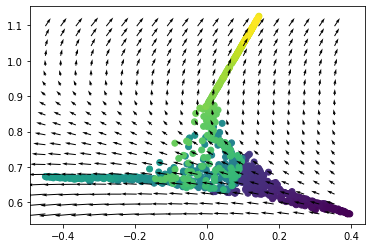

 21%|██        | 3093/15000 [00:54<02:47, 71.09it/s]

EPOCH 3100.


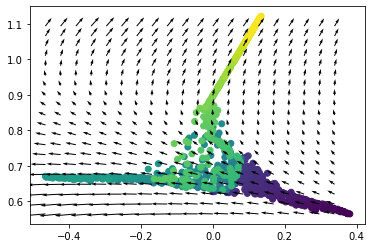

 21%|██▏       | 3197/15000 [00:56<02:47, 70.47it/s]

EPOCH 3200.


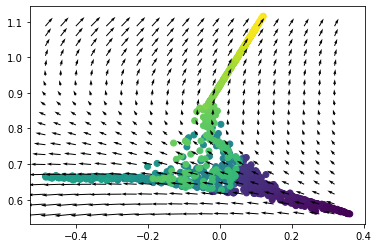

 22%|██▏       | 3300/15000 [00:58<02:50, 68.75it/s]

EPOCH 3300.


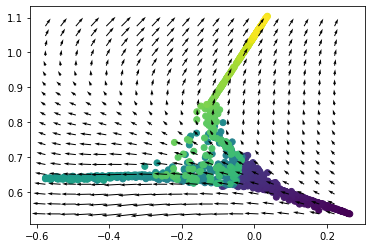

 23%|██▎       | 3395/15000 [00:59<02:44, 70.51it/s]

EPOCH 3400.


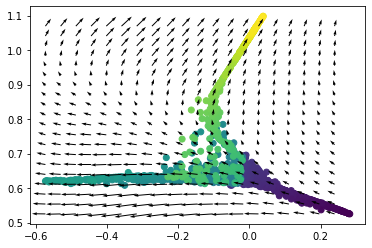

 23%|██▎       | 3498/15000 [01:01<02:42, 70.64it/s]

EPOCH 3500.


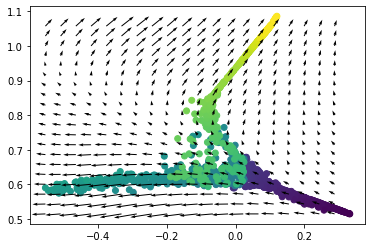

 24%|██▍       | 3594/15000 [01:03<02:41, 70.67it/s]

EPOCH 3600.


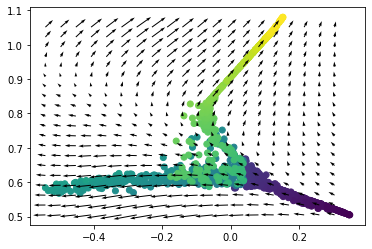

 25%|██▍       | 3698/15000 [01:05<02:39, 70.74it/s]

EPOCH 3700.


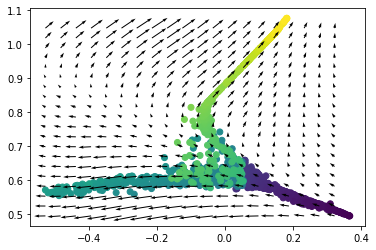

 25%|██▌       | 3794/15000 [01:06<02:38, 70.67it/s]

EPOCH 3800.


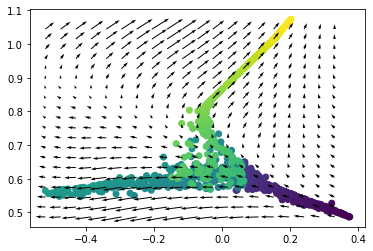

 26%|██▌       | 3898/15000 [01:08<02:38, 70.23it/s]

EPOCH 3900.


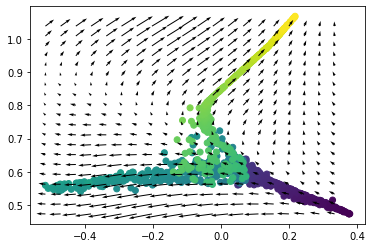

 27%|██▋       | 3994/15000 [01:10<02:36, 70.44it/s]

EPOCH 4000.


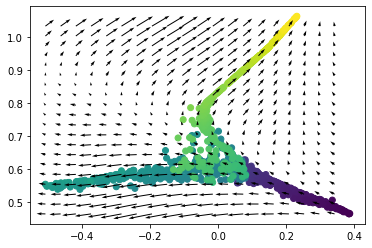

 27%|██▋       | 4098/15000 [01:12<02:33, 71.01it/s]

EPOCH 4100.


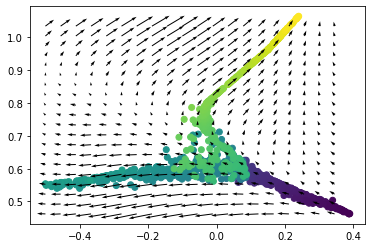

 28%|██▊       | 4194/15000 [01:13<02:32, 70.96it/s]

EPOCH 4200.


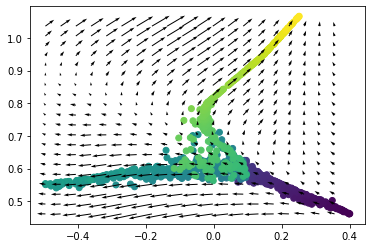

 29%|██▊       | 4298/15000 [01:15<02:30, 71.12it/s]

EPOCH 4300.


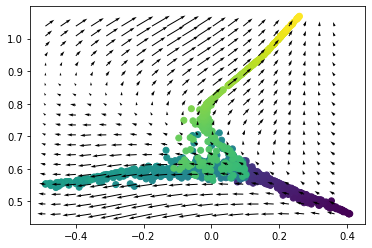

 29%|██▉       | 4394/15000 [01:17<02:32, 69.73it/s]

EPOCH 4400.


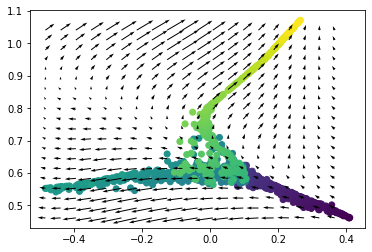

 30%|██▉       | 4494/15000 [01:19<02:28, 70.69it/s]

EPOCH 4500.


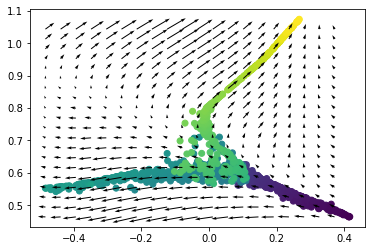

 31%|███       | 4598/15000 [01:20<02:27, 70.74it/s]

EPOCH 4600.


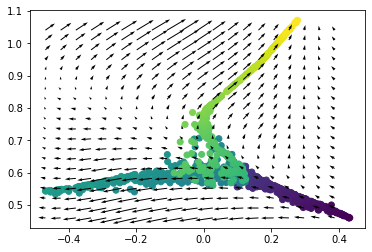

 31%|███▏      | 4694/15000 [01:22<02:26, 70.53it/s]

EPOCH 4700.


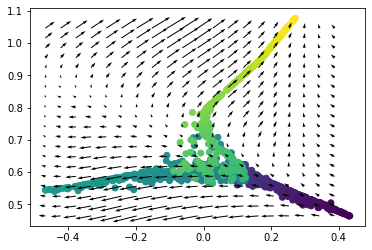

 32%|███▏      | 4798/15000 [01:24<02:23, 71.02it/s]

EPOCH 4800.


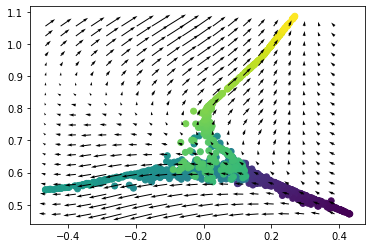

 33%|███▎      | 4894/15000 [01:26<02:23, 70.50it/s]

EPOCH 4900.


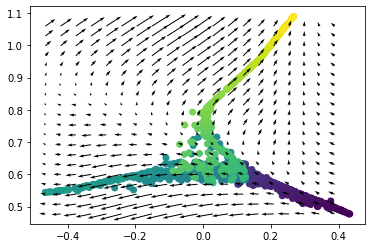

 33%|███▎      | 4998/15000 [01:27<02:20, 71.02it/s]

EPOCH 5000.


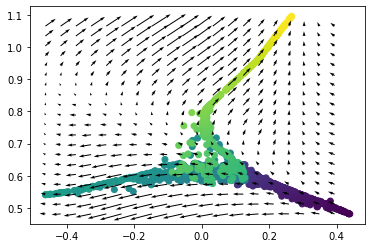

 34%|███▍      | 5094/15000 [01:29<02:22, 69.54it/s]

EPOCH 5100.


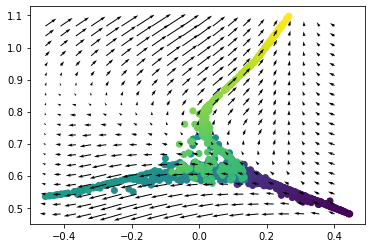

 35%|███▍      | 5198/15000 [01:31<02:18, 70.93it/s]

EPOCH 5200.


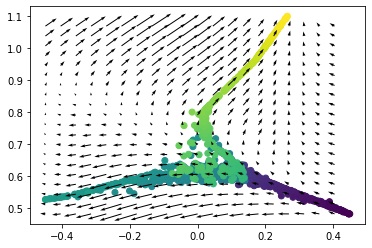

 35%|███▌      | 5294/15000 [01:33<02:17, 70.52it/s]

EPOCH 5300.


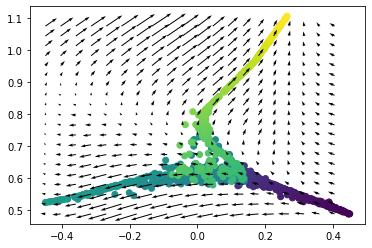

 36%|███▌      | 5398/15000 [01:35<02:14, 71.44it/s]

EPOCH 5400.


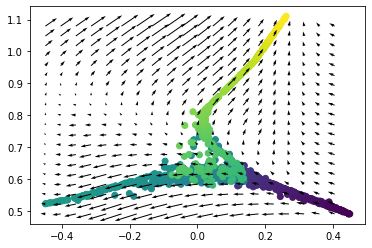

 37%|███▋      | 5494/15000 [01:36<02:15, 70.18it/s]

EPOCH 5500.


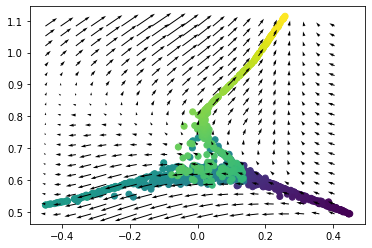

 37%|███▋      | 5598/15000 [01:38<02:12, 71.09it/s]

EPOCH 5600.


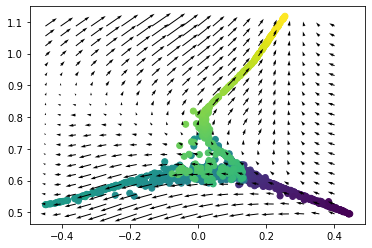

 38%|███▊      | 5694/15000 [01:40<02:13, 69.86it/s]

EPOCH 5700.


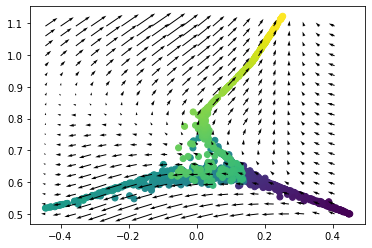

 39%|███▊      | 5797/15000 [01:42<02:08, 71.40it/s]

EPOCH 5800.


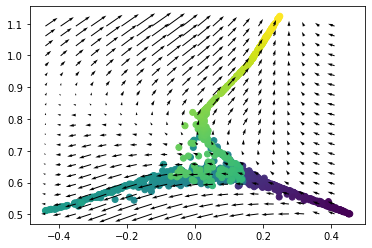

 39%|███▉      | 5900/15000 [01:43<02:09, 70.54it/s]

EPOCH 5900.


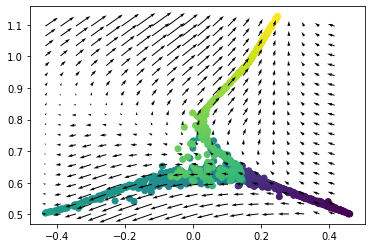

 40%|███▉      | 5996/15000 [01:45<02:07, 70.75it/s]

EPOCH 6000.


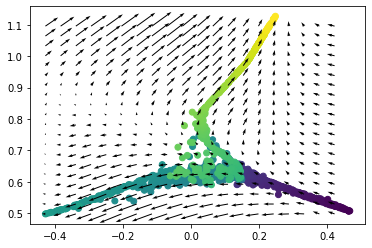

 41%|████      | 6100/15000 [01:47<02:05, 71.05it/s]

EPOCH 6100.


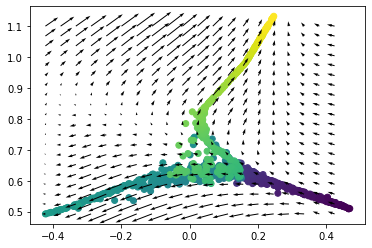

 41%|████▏     | 6196/15000 [01:49<02:04, 70.71it/s]

EPOCH 6200.


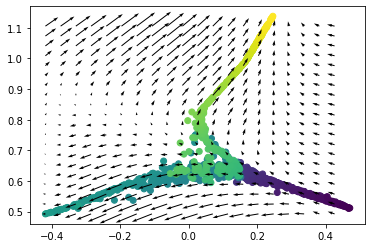

 42%|████▏     | 6300/15000 [01:50<02:02, 70.83it/s]

EPOCH 6300.


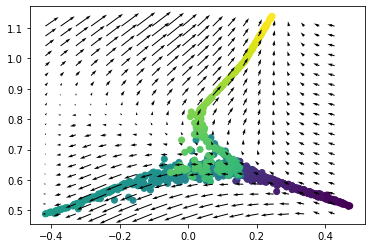

 43%|████▎     | 6396/15000 [01:52<02:03, 69.74it/s]

EPOCH 6400.


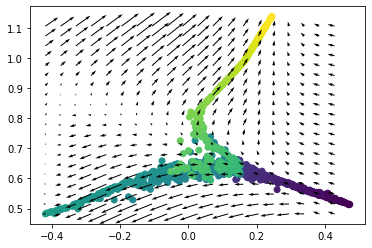

 43%|████▎     | 6500/15000 [01:54<01:59, 70.91it/s]

EPOCH 6500.


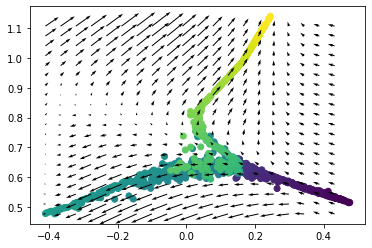

 44%|████▍     | 6596/15000 [01:56<01:58, 70.75it/s]

EPOCH 6600.


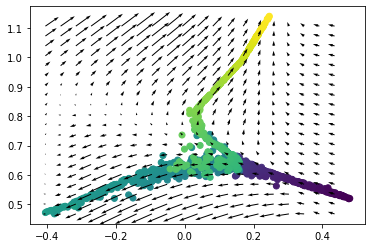

 45%|████▍     | 6699/15000 [01:57<01:56, 70.99it/s]

EPOCH 6700.


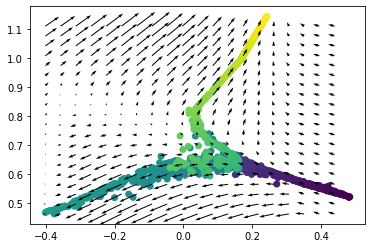

 45%|████▌     | 6795/15000 [01:59<01:55, 70.91it/s]

EPOCH 6800.


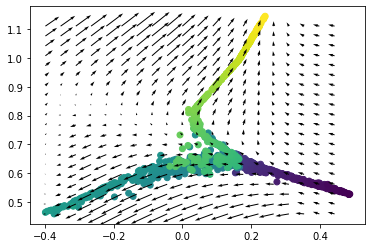

 46%|████▌     | 6899/15000 [02:01<01:54, 70.95it/s]

EPOCH 6900.


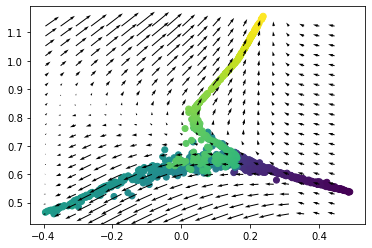

 47%|████▋     | 6994/15000 [02:03<01:53, 70.28it/s]

EPOCH 7000.


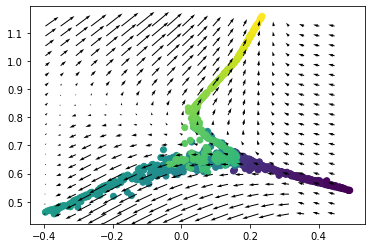

 47%|████▋     | 7098/15000 [02:04<01:51, 71.16it/s]

EPOCH 7100.


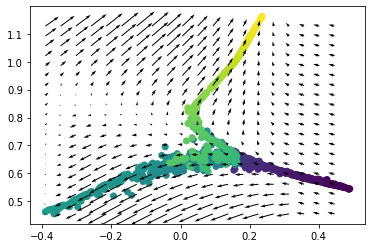

 48%|████▊     | 7194/15000 [02:06<01:50, 70.88it/s]

EPOCH 7200.


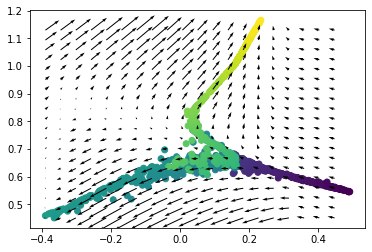

 49%|████▊     | 7297/15000 [02:08<01:48, 70.84it/s]

EPOCH 7300.


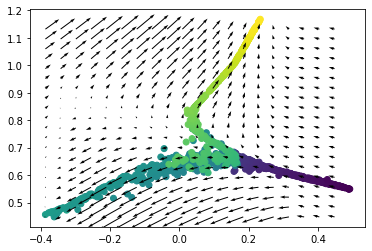

 49%|████▉     | 7393/15000 [02:10<01:47, 70.72it/s]

EPOCH 7400.


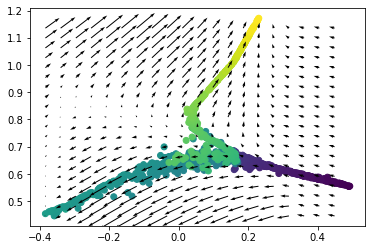

 50%|████▉     | 7497/15000 [02:11<01:46, 70.72it/s]

EPOCH 7500.


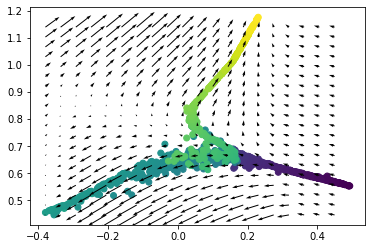

 51%|█████     | 7593/15000 [02:13<01:45, 70.46it/s]

EPOCH 7600.


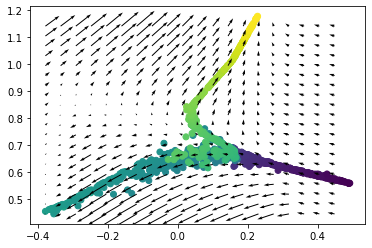

 51%|█████▏    | 7697/15000 [02:15<01:43, 70.59it/s]

EPOCH 7700.


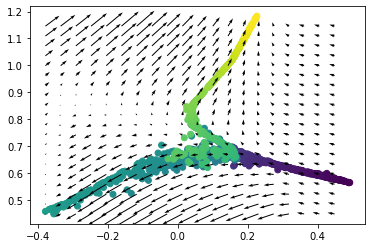

 52%|█████▏    | 7800/15000 [02:17<01:42, 70.41it/s]

EPOCH 7800.


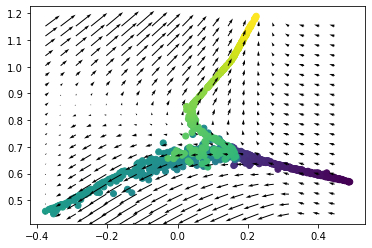

 53%|█████▎    | 7896/15000 [02:19<01:40, 70.63it/s]

EPOCH 7900.


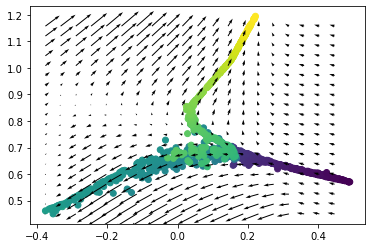

 53%|█████▎    | 8000/15000 [02:20<01:38, 71.03it/s]

EPOCH 8000.


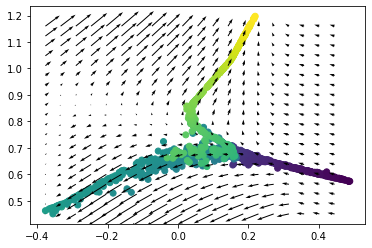

 54%|█████▍    | 8096/15000 [02:22<01:37, 70.73it/s]

EPOCH 8100.


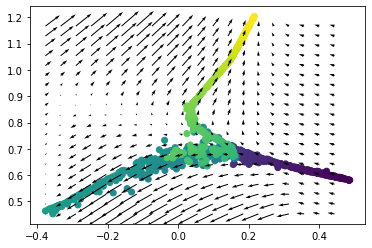

 55%|█████▍    | 8199/15000 [02:24<01:36, 70.50it/s]

EPOCH 8200.


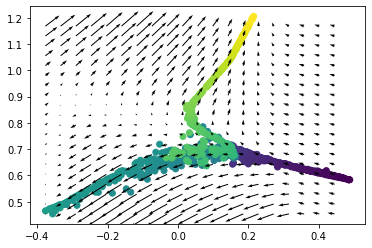

 55%|█████▌    | 8295/15000 [02:25<01:36, 69.41it/s]

EPOCH 8300.


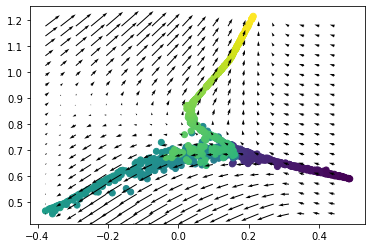

 56%|█████▌    | 8399/15000 [02:27<01:33, 70.80it/s]

EPOCH 8400.


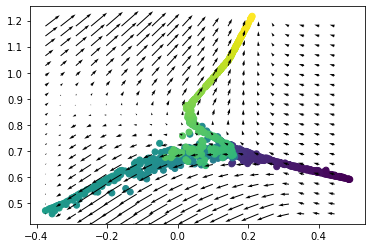

 57%|█████▋    | 8495/15000 [02:29<01:32, 70.67it/s]

EPOCH 8500.


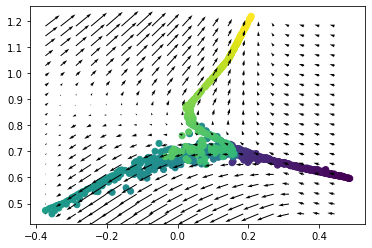

 57%|█████▋    | 8599/15000 [02:31<01:30, 70.80it/s]

EPOCH 8600.


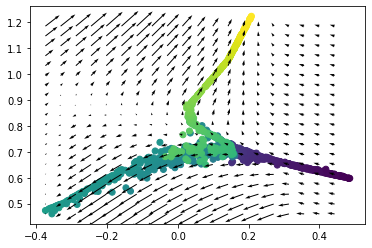

 58%|█████▊    | 8694/15000 [02:32<01:29, 70.60it/s]

EPOCH 8700.


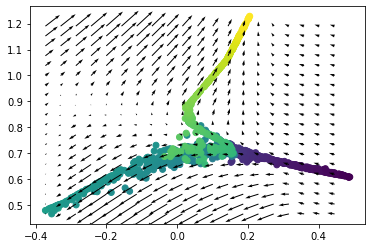

 59%|█████▊    | 8796/15000 [02:34<01:28, 70.40it/s]

EPOCH 8800.


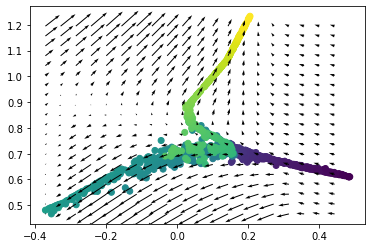

 59%|█████▉    | 8900/15000 [02:36<01:26, 70.57it/s]

EPOCH 8900.


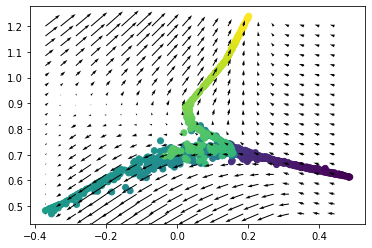

 60%|█████▉    | 8996/15000 [02:38<01:24, 70.66it/s]

EPOCH 9000.


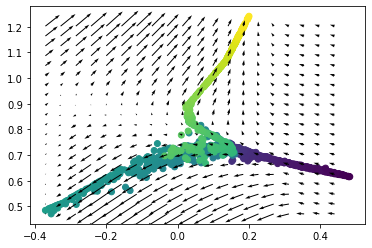

 61%|██████    | 9100/15000 [02:40<01:23, 70.60it/s]

EPOCH 9100.


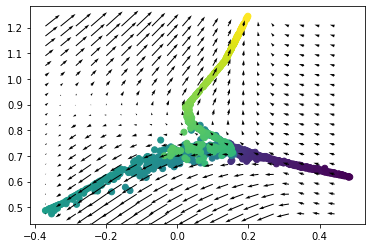

 61%|██████▏   | 9196/15000 [02:42<01:23, 69.73it/s]

EPOCH 9200.


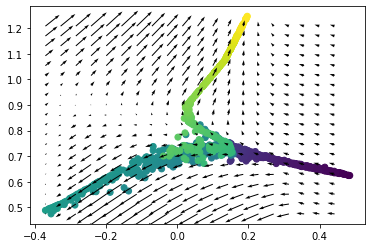

 62%|██████▏   | 9300/15000 [02:43<01:20, 70.66it/s]

EPOCH 9300.


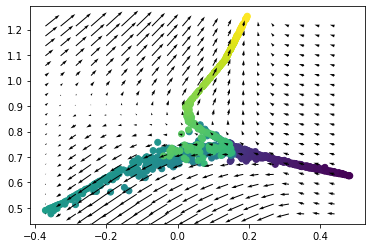

 63%|██████▎   | 9396/15000 [02:45<01:19, 70.23it/s]

EPOCH 9400.


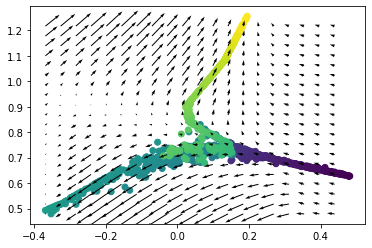

 63%|██████▎   | 9498/15000 [02:47<01:17, 70.55it/s]

EPOCH 9500.


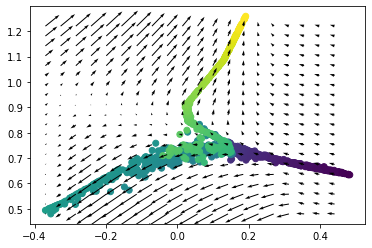

 64%|██████▍   | 9594/15000 [02:49<01:16, 70.55it/s]

EPOCH 9600.


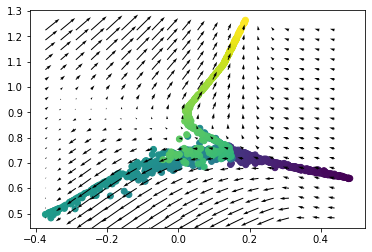

 65%|██████▍   | 9698/15000 [02:50<01:14, 71.01it/s]

EPOCH 9700.


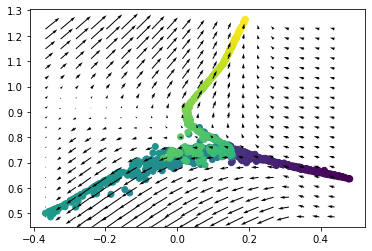

 65%|██████▌   | 9793/15000 [02:52<01:13, 70.40it/s]

EPOCH 9800.


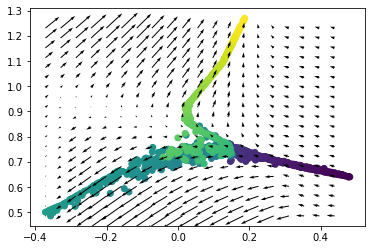

 66%|██████▌   | 9896/15000 [02:54<01:12, 70.82it/s]

EPOCH 9900.


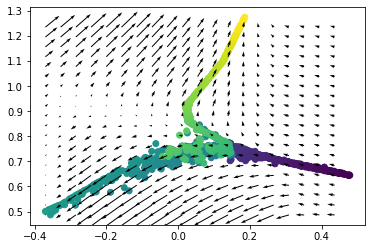

 67%|██████▋   | 10000/15000 [02:56<01:10, 70.85it/s]

EPOCH 10000.


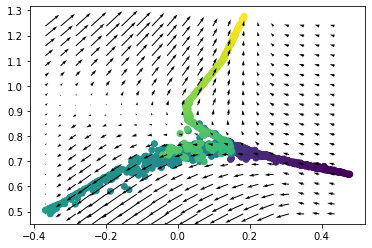

 67%|██████▋   | 10094/15000 [02:58<01:10, 69.15it/s]

EPOCH 10100.


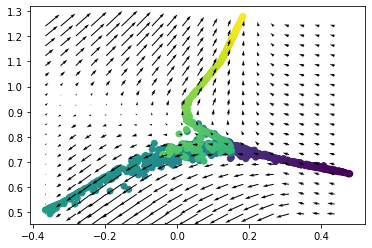

 68%|██████▊   | 10198/15000 [02:59<01:09, 68.90it/s]

EPOCH 10200.


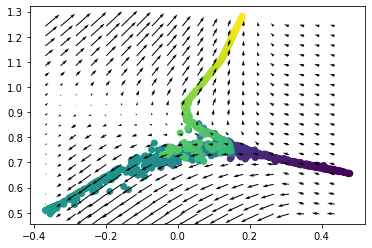

 69%|██████▊   | 10299/15000 [03:01<01:06, 70.68it/s]

EPOCH 10300.


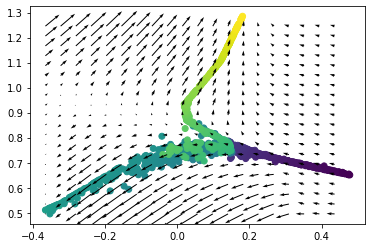

 69%|██████▉   | 10395/15000 [03:03<01:05, 70.32it/s]

EPOCH 10400.


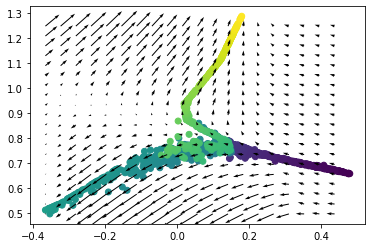

 70%|██████▉   | 10499/15000 [03:05<01:03, 70.88it/s]

EPOCH 10500.


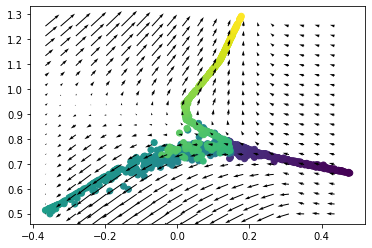

 71%|███████   | 10594/15000 [03:06<01:02, 69.94it/s]

EPOCH 10600.


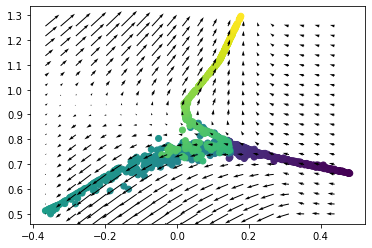

 71%|███████▏  | 10697/15000 [03:08<01:00, 70.58it/s]

EPOCH 10700.


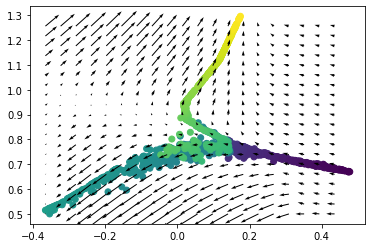

 72%|███████▏  | 10793/15000 [03:10<00:59, 70.48it/s]

EPOCH 10800.


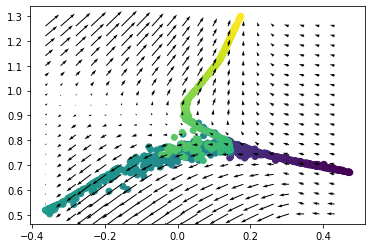

 73%|███████▎  | 10897/15000 [03:12<00:57, 70.76it/s]

EPOCH 10900.


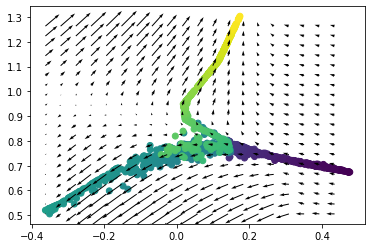

 73%|███████▎  | 10993/15000 [03:13<00:56, 70.43it/s]

EPOCH 11000.


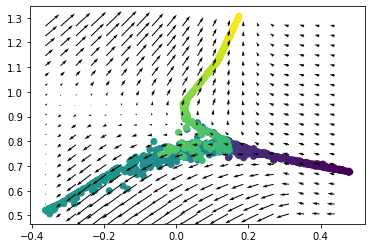

 74%|███████▍  | 11097/15000 [03:15<00:55, 70.63it/s]

EPOCH 11100.


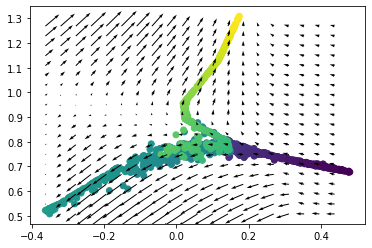

 75%|███████▍  | 11193/15000 [03:17<00:54, 70.36it/s]

EPOCH 11200.


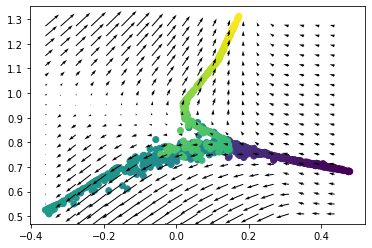

 75%|███████▌  | 11297/15000 [03:19<00:52, 70.98it/s]

EPOCH 11300.


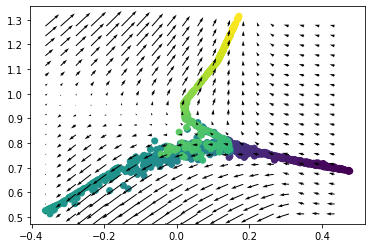

 76%|███████▌  | 11393/15000 [03:21<00:51, 70.34it/s]

EPOCH 11400.


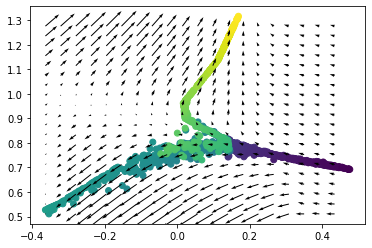

 77%|███████▋  | 11497/15000 [03:22<00:49, 70.98it/s]

EPOCH 11500.


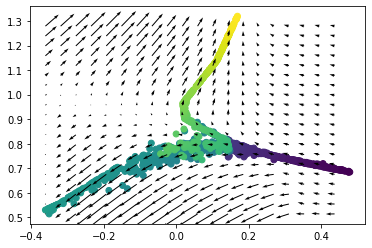

 77%|███████▋  | 11593/15000 [03:24<00:48, 70.51it/s]

EPOCH 11600.


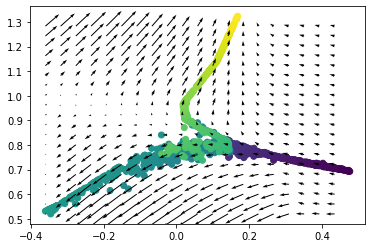

 78%|███████▊  | 11697/15000 [03:26<00:46, 70.86it/s]

EPOCH 11700.


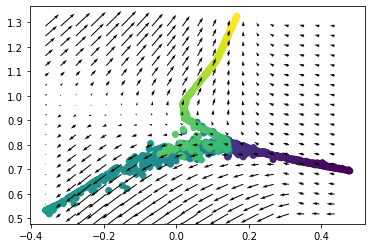

 79%|███████▊  | 11793/15000 [03:28<00:45, 70.41it/s]

EPOCH 11800.


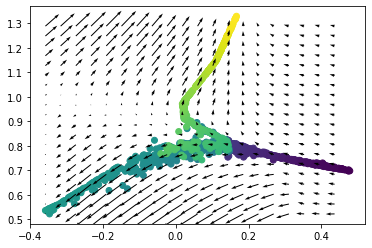

 79%|███████▉  | 11897/15000 [03:29<00:43, 70.61it/s]

EPOCH 11900.


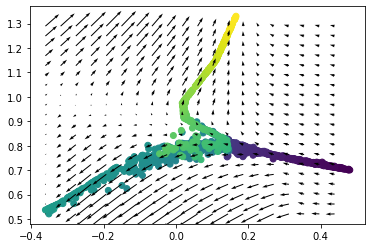

 80%|███████▉  | 11993/15000 [03:31<00:42, 70.62it/s]

EPOCH 12000.


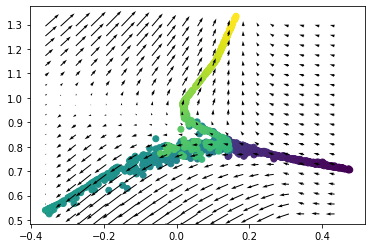

 81%|████████  | 12097/15000 [03:33<00:41, 70.53it/s]

EPOCH 12100.


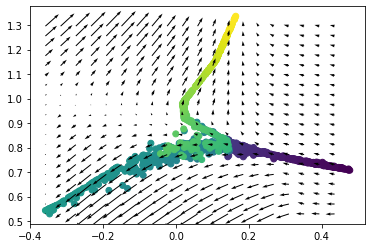

 81%|████████▏ | 12193/15000 [03:35<00:39, 70.47it/s]

EPOCH 12200.


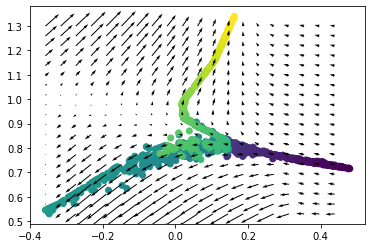

 82%|████████▏ | 12297/15000 [03:36<00:38, 70.99it/s]

EPOCH 12300.


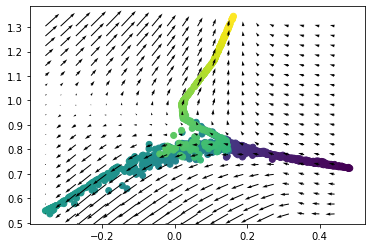

 83%|████████▎ | 12393/15000 [03:38<00:36, 70.48it/s]

EPOCH 12400.


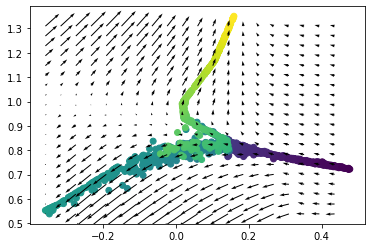

 83%|████████▎ | 12497/15000 [03:40<00:35, 70.99it/s]

EPOCH 12500.


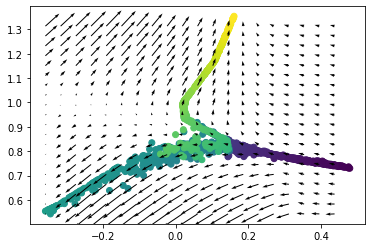

 84%|████████▍ | 12593/15000 [03:42<00:34, 70.37it/s]

EPOCH 12600.


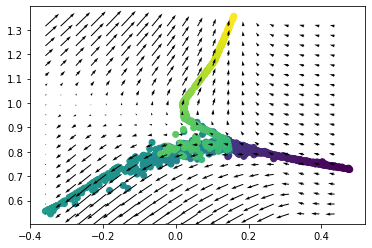

 85%|████████▍ | 12697/15000 [03:44<00:32, 70.71it/s]

EPOCH 12700.


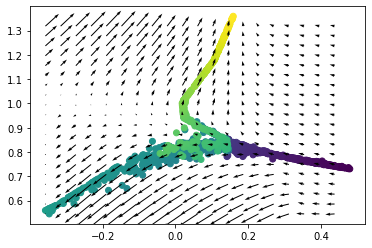

 85%|████████▌ | 12800/15000 [03:45<00:31, 70.73it/s]

EPOCH 12800.


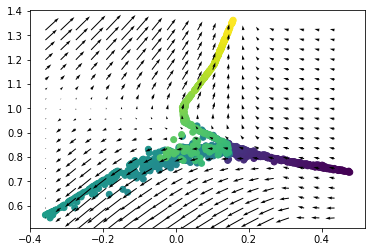

 86%|████████▌ | 12896/15000 [03:47<00:29, 70.53it/s]

EPOCH 12900.


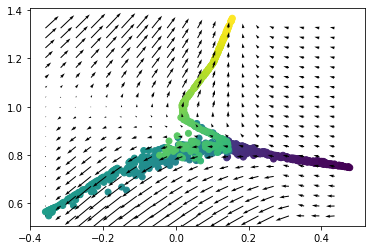

 87%|████████▋ | 12999/15000 [03:49<00:28, 70.49it/s]

EPOCH 13000.


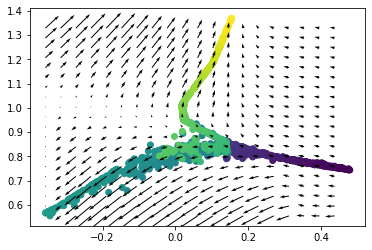

 87%|████████▋ | 13094/15000 [03:51<00:27, 70.37it/s]

EPOCH 13100.


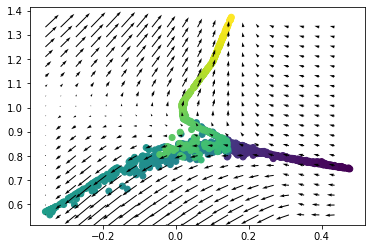

 88%|████████▊ | 13198/15000 [03:52<00:25, 70.48it/s]

EPOCH 13200.


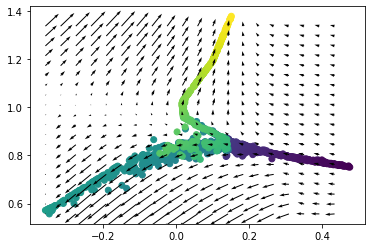

 89%|████████▊ | 13294/15000 [03:54<00:24, 70.25it/s]

EPOCH 13300.


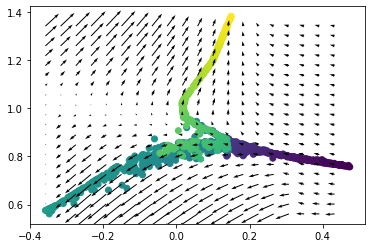

 89%|████████▉ | 13397/15000 [03:56<00:22, 70.51it/s]

EPOCH 13400.


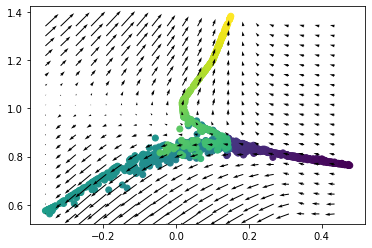

 90%|████████▉ | 13493/15000 [03:58<00:21, 69.85it/s]

EPOCH 13500.


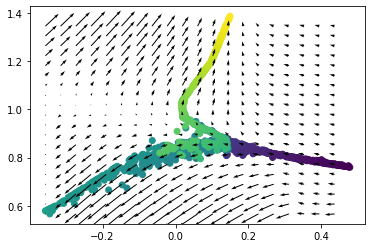

 91%|█████████ | 13595/15000 [03:59<00:19, 70.40it/s]

EPOCH 13600.


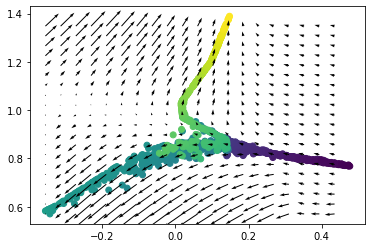

 91%|█████████▏| 13699/15000 [04:01<00:18, 70.85it/s]

EPOCH 13700.


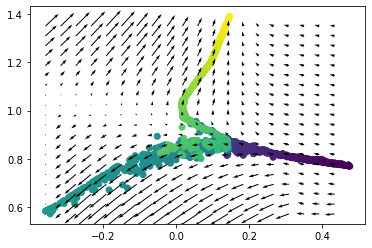

 92%|█████████▏| 13795/15000 [04:03<00:17, 70.28it/s]

EPOCH 13800.


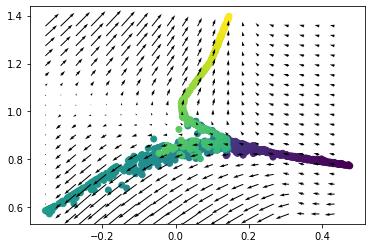

 93%|█████████▎| 13899/15000 [04:05<00:15, 70.95it/s]

EPOCH 13900.


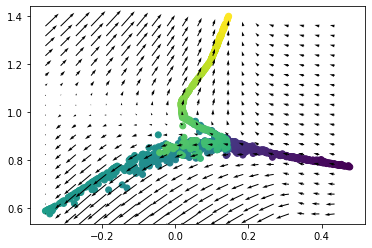

 93%|█████████▎| 13995/15000 [04:06<00:14, 70.33it/s]

EPOCH 14000.


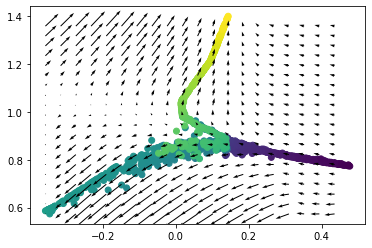

 94%|█████████▍| 14099/15000 [04:08<00:12, 70.21it/s]

EPOCH 14100.


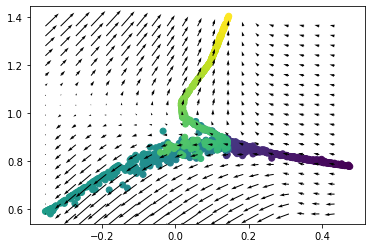

 95%|█████████▍| 14195/15000 [04:10<00:11, 70.94it/s]

EPOCH 14200.


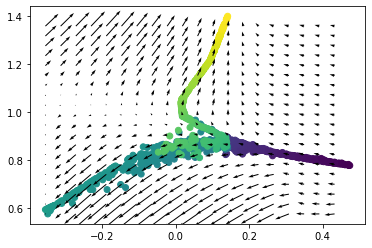

 95%|█████████▌| 14299/15000 [04:12<00:09, 70.52it/s]

EPOCH 14300.


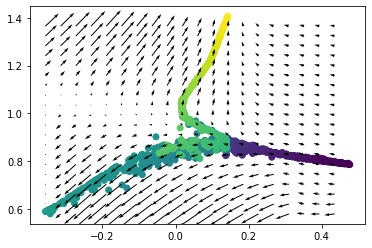

 96%|█████████▌| 14395/15000 [04:13<00:08, 70.28it/s]

EPOCH 14400.


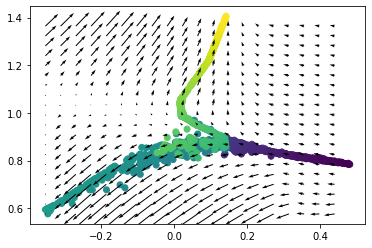

 97%|█████████▋| 14499/15000 [04:15<00:07, 70.48it/s]

EPOCH 14500.


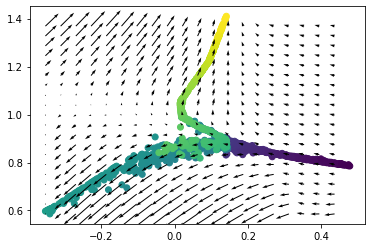

 97%|█████████▋| 14595/15000 [04:17<00:05, 69.81it/s]

EPOCH 14600.


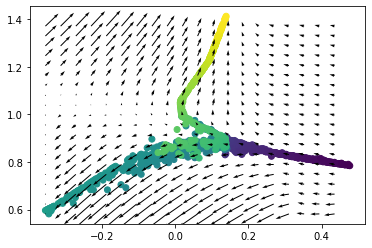

 98%|█████████▊| 14697/15000 [04:19<00:04, 70.75it/s]

EPOCH 14700.


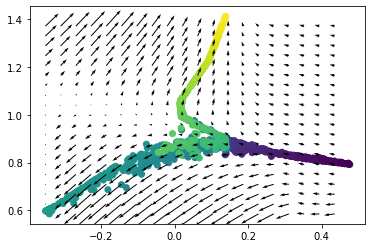

 99%|█████████▊| 14793/15000 [04:20<00:02, 70.84it/s]

EPOCH 14800.


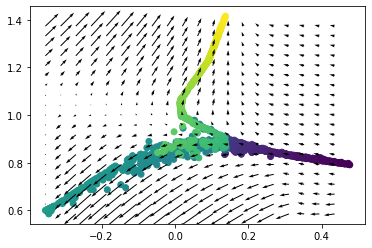

 99%|█████████▉| 14897/15000 [04:22<00:01, 70.93it/s]

EPOCH 14900.


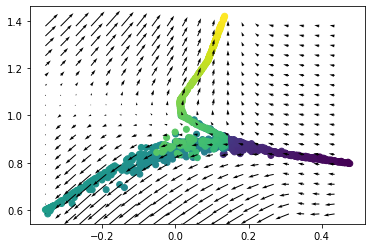

100%|██████████| 15000/15000 [04:24<00:00, 56.75it/s]


In [46]:
FE.fit(n_steps = 15000)

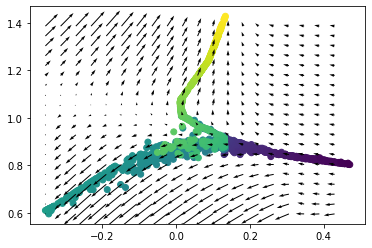

In [47]:
FE.visualize_points(labels)

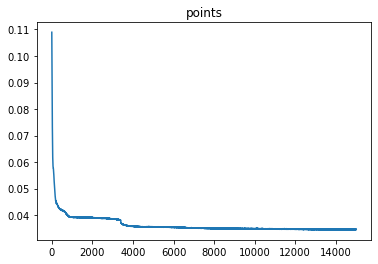

In [51]:
FE.visualize_loss("points")

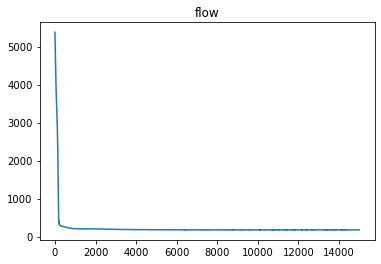

In [52]:
FE.visualize_loss("flow")

## Testing on Swiss Roll (from origin)

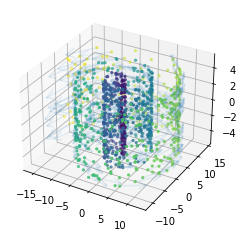

In [53]:
from directed_graphs.datasets import directed_swiss_roll
X, flow, labels = directed_swiss_roll()
plot_directed_3d(X, flow, labels)
X = torch.tensor(X).float().to(device)
flow = torch.tensor(flow).float().to(device)

In [54]:
FE = FlowEmbedder(X,
                  flow,
                  FAShape=(2, 4, 8, 4, 2),
                  EncShape=(3, 4, 8, 4, 2),
                  knn = 10,
                  device = device).to(device)

  0%|          | 0/10000 [00:00<?, ?it/s]

EPOCH 0.


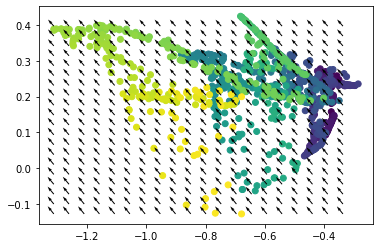

  1%|          | 97/10000 [00:01<02:19, 70.79it/s] 

EPOCH 100.


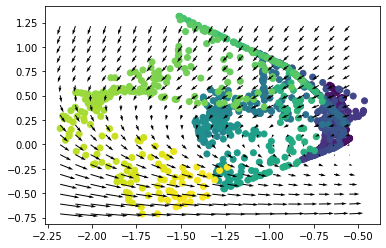

  2%|▏         | 193/10000 [00:03<02:18, 70.78it/s]

EPOCH 200.


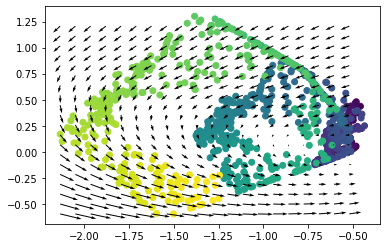

  3%|▎         | 297/10000 [00:05<02:15, 71.36it/s]

EPOCH 300.


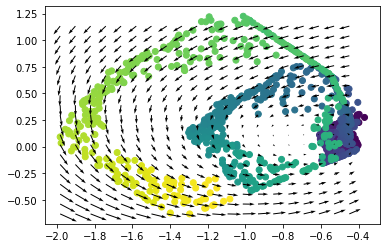

  4%|▍         | 393/10000 [00:07<02:16, 70.52it/s]

EPOCH 400.


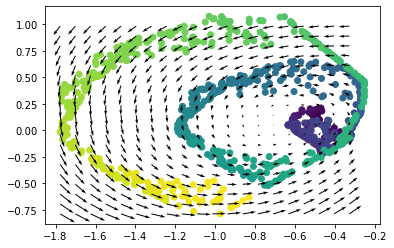

  5%|▍         | 497/10000 [00:08<02:12, 71.71it/s]

EPOCH 500.


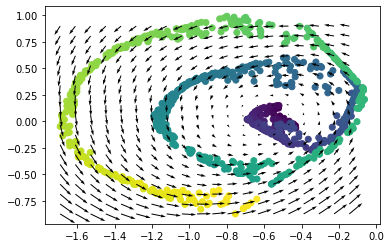

  6%|▌         | 593/10000 [00:10<02:11, 71.33it/s]

EPOCH 600.


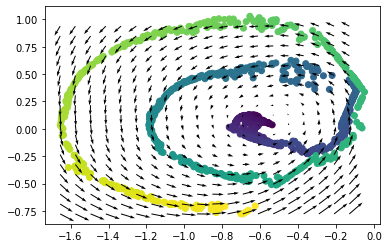

  7%|▋         | 697/10000 [00:12<02:09, 71.63it/s]

EPOCH 700.


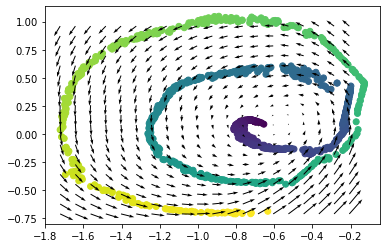

  8%|▊         | 793/10000 [00:14<02:10, 70.55it/s]

EPOCH 800.


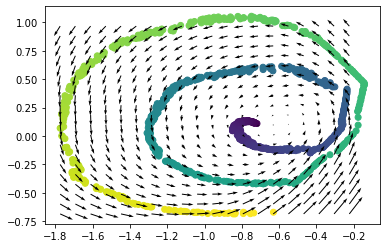

  9%|▉         | 897/10000 [00:16<02:08, 71.04it/s]

EPOCH 900.


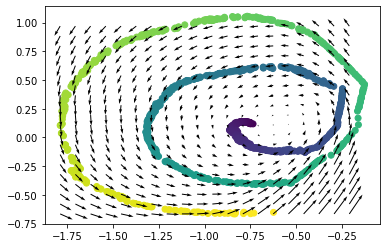

 10%|█         | 1000/10000 [00:17<02:07, 70.71it/s]

EPOCH 1000.


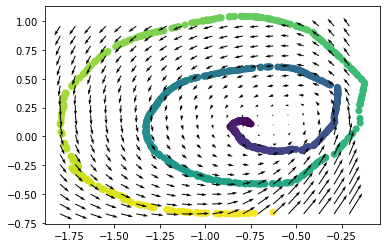

 11%|█         | 1096/10000 [00:19<02:04, 71.24it/s]

EPOCH 1100.


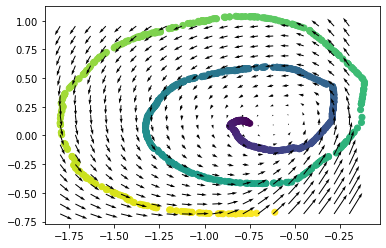

 12%|█▏        | 1200/10000 [00:21<02:04, 70.45it/s]

EPOCH 1200.


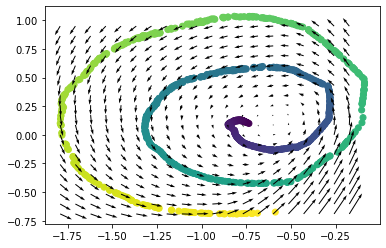

 13%|█▎        | 1296/10000 [00:23<02:03, 70.75it/s]

EPOCH 1300.


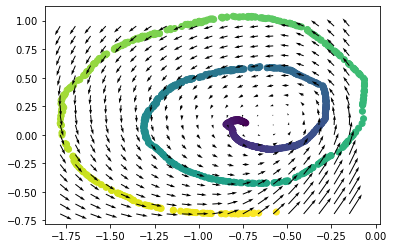

 14%|█▍        | 1400/10000 [00:25<02:02, 70.27it/s]

EPOCH 1400.


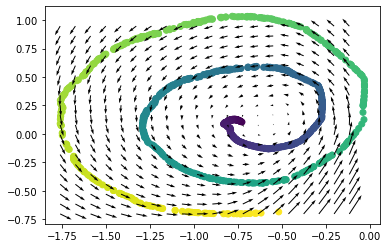

 15%|█▍        | 1496/10000 [00:26<01:59, 71.25it/s]

EPOCH 1500.


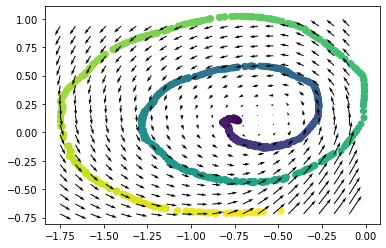

 16%|█▌        | 1600/10000 [00:28<01:57, 71.50it/s]

EPOCH 1600.


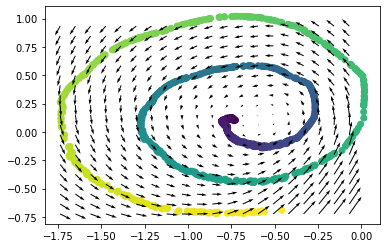

 17%|█▋        | 1694/10000 [00:30<01:57, 70.83it/s]

EPOCH 1700.


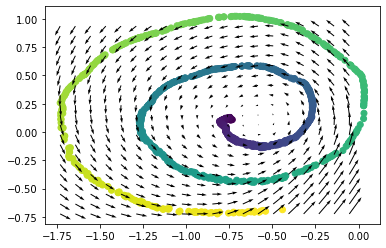

 18%|█▊        | 1798/10000 [00:32<01:55, 71.05it/s]

EPOCH 1800.


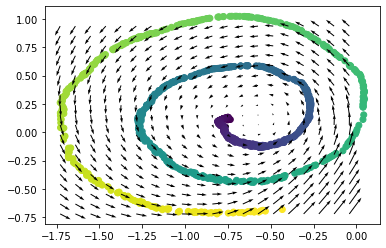

 19%|█▉        | 1893/10000 [00:33<01:55, 69.93it/s]

EPOCH 1900.


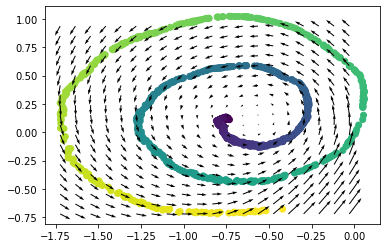

 20%|█▉        | 1997/10000 [00:35<01:51, 71.52it/s]

EPOCH 2000.


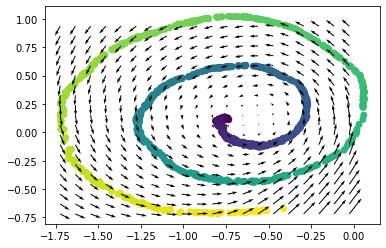

 21%|██        | 2093/10000 [00:37<01:51, 70.72it/s]

EPOCH 2100.


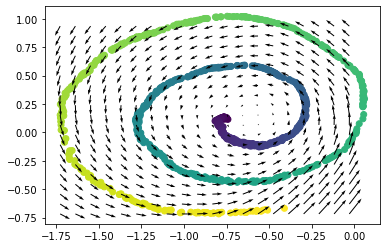

 22%|██▏       | 2197/10000 [00:39<01:50, 70.89it/s]

EPOCH 2200.


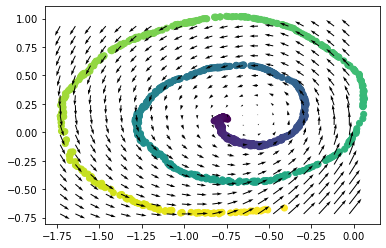

 23%|██▎       | 2293/10000 [00:41<01:50, 69.95it/s]

EPOCH 2300.


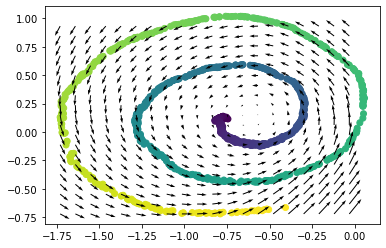

 24%|██▍       | 2397/10000 [00:42<01:47, 70.61it/s]

EPOCH 2400.


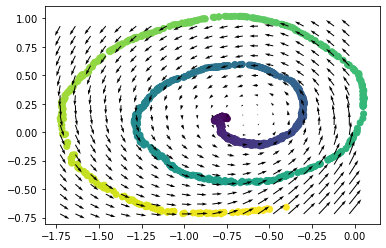

 25%|██▍       | 2493/10000 [00:44<01:45, 70.83it/s]

EPOCH 2500.


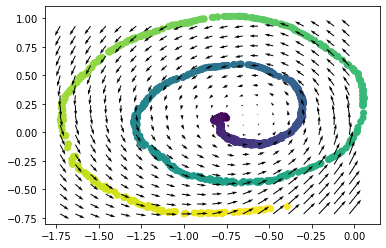

 26%|██▌       | 2597/10000 [00:46<01:43, 71.24it/s]

EPOCH 2600.


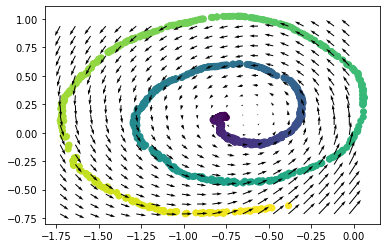

 27%|██▋       | 2693/10000 [00:48<01:43, 70.63it/s]

EPOCH 2700.


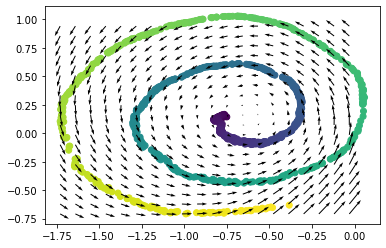

 28%|██▊       | 2797/10000 [00:50<01:41, 71.17it/s]

EPOCH 2800.


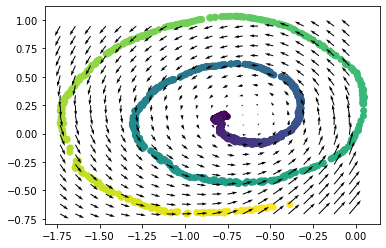

 29%|██▉       | 2893/10000 [00:51<01:40, 70.46it/s]

EPOCH 2900.


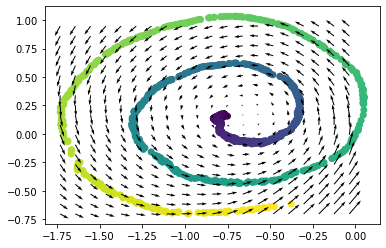

 30%|██▉       | 2997/10000 [00:53<01:38, 71.16it/s]

EPOCH 3000.


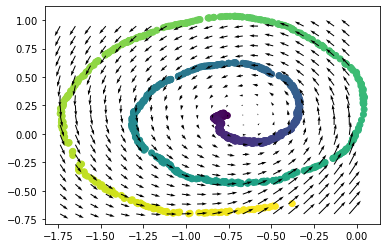

 31%|███       | 3093/10000 [00:55<01:37, 70.50it/s]

EPOCH 3100.


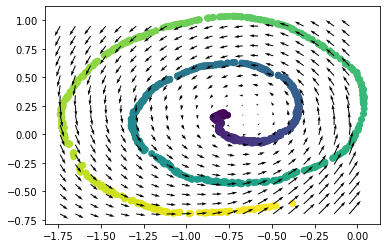

 32%|███▏      | 3197/10000 [00:57<01:35, 71.14it/s]

EPOCH 3200.


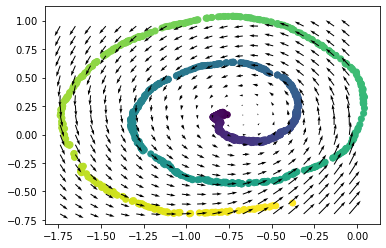

 33%|███▎      | 3293/10000 [00:58<01:34, 70.72it/s]

EPOCH 3300.


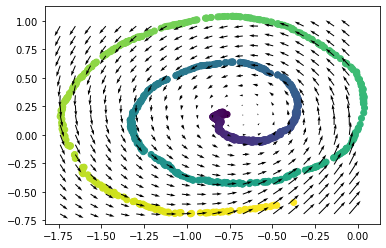

 34%|███▍      | 3397/10000 [01:00<01:32, 71.24it/s]

EPOCH 3400.


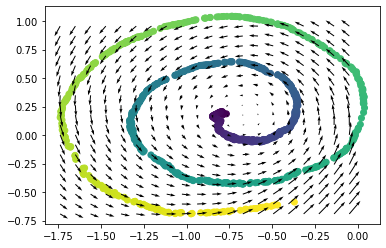

 35%|███▍      | 3493/10000 [01:02<01:32, 70.54it/s]

EPOCH 3500.


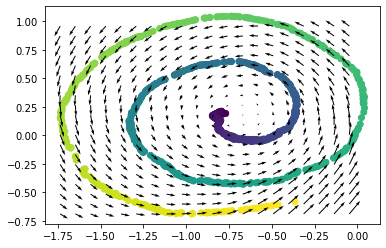

 36%|███▌      | 3597/10000 [01:04<01:29, 71.69it/s]

EPOCH 3600.


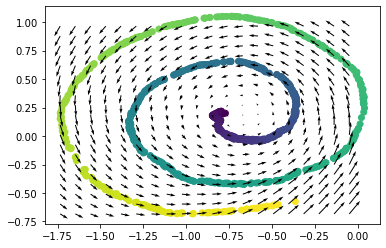

 37%|███▋      | 3693/10000 [01:06<01:29, 70.86it/s]

EPOCH 3700.


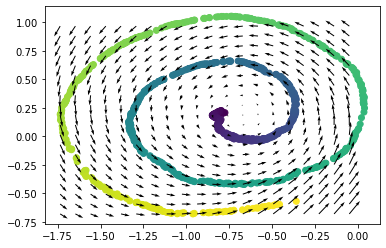

 38%|███▊      | 3797/10000 [01:07<01:27, 71.08it/s]

EPOCH 3800.


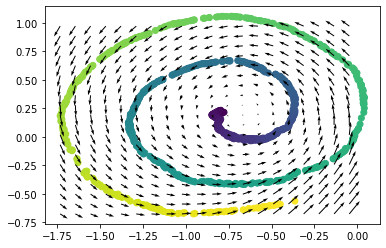

 39%|███▉      | 3893/10000 [01:09<01:25, 71.24it/s]

EPOCH 3900.


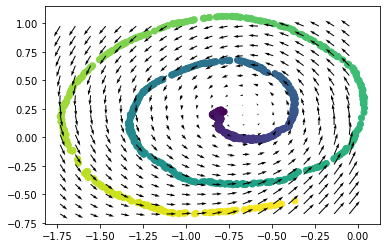

 40%|███▉      | 3997/10000 [01:11<01:23, 71.63it/s]

EPOCH 4000.


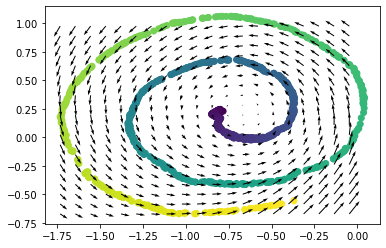

 41%|████      | 4093/10000 [01:13<01:23, 70.98it/s]

EPOCH 4100.


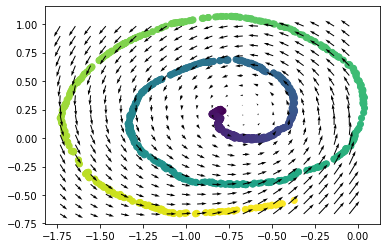

 42%|████▏     | 4197/10000 [01:14<01:22, 70.49it/s]

EPOCH 4200.


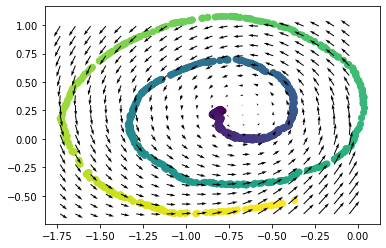

 43%|████▎     | 4293/10000 [01:16<01:20, 70.83it/s]

EPOCH 4300.


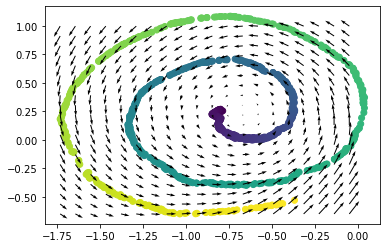

 44%|████▍     | 4397/10000 [01:18<01:18, 71.41it/s]

EPOCH 4400.


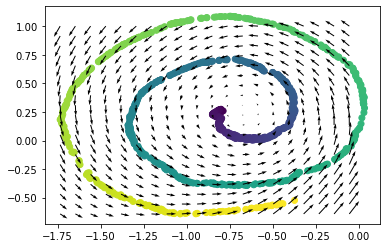

 45%|████▍     | 4493/10000 [01:20<01:17, 71.06it/s]

EPOCH 4500.


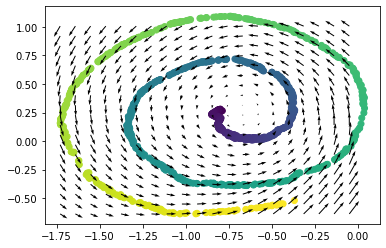

 46%|████▌     | 4597/10000 [01:22<01:16, 70.49it/s]

EPOCH 4600.


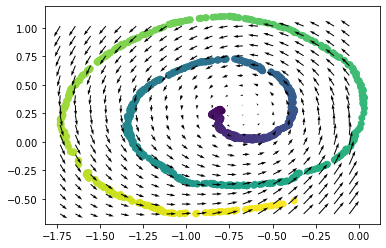

 47%|████▋     | 4693/10000 [01:23<01:15, 70.48it/s]

EPOCH 4700.


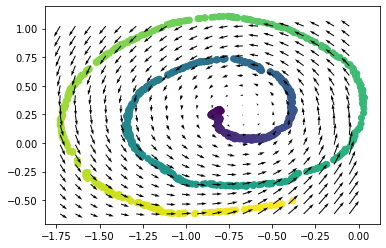

 48%|████▊     | 4797/10000 [01:25<01:12, 71.40it/s]

EPOCH 4800.


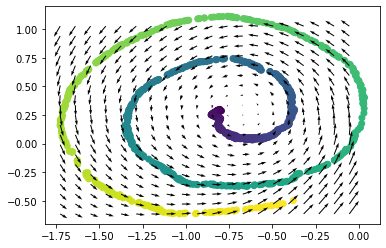

 49%|████▉     | 4893/10000 [01:27<01:12, 70.65it/s]

EPOCH 4900.


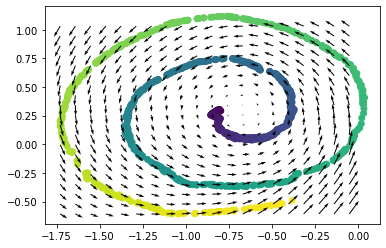

 50%|████▉     | 4997/10000 [01:29<01:10, 71.07it/s]

EPOCH 5000.


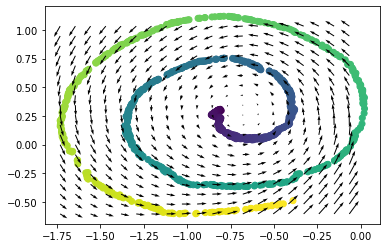

 51%|█████     | 5100/10000 [01:30<01:08, 71.32it/s]

EPOCH 5100.


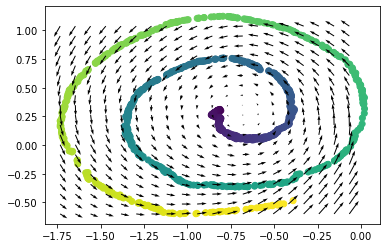

 52%|█████▏    | 5196/10000 [01:32<01:08, 70.55it/s]

EPOCH 5200.


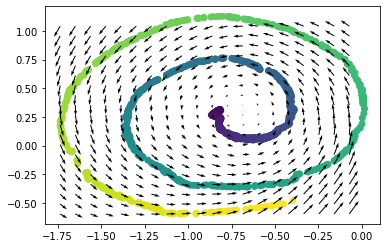

 53%|█████▎    | 5300/10000 [01:34<01:05, 71.26it/s]

EPOCH 5300.


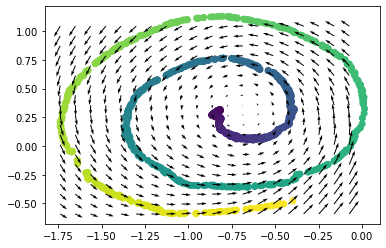

 54%|█████▍    | 5396/10000 [01:36<01:04, 71.00it/s]

EPOCH 5400.


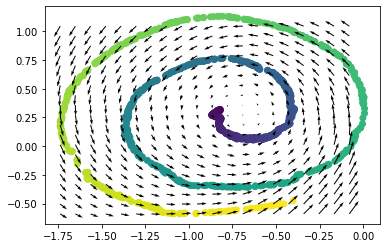

 55%|█████▍    | 5499/10000 [01:38<01:03, 71.28it/s]

EPOCH 5500.


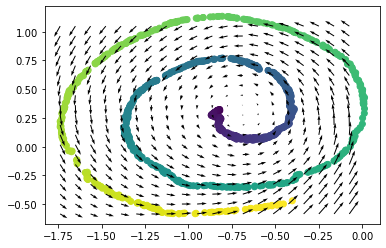

 56%|█████▌    | 5595/10000 [01:39<01:02, 71.01it/s]

EPOCH 5600.


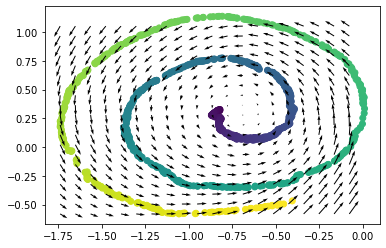

 57%|█████▋    | 5699/10000 [01:41<01:00, 71.60it/s]

EPOCH 5700.


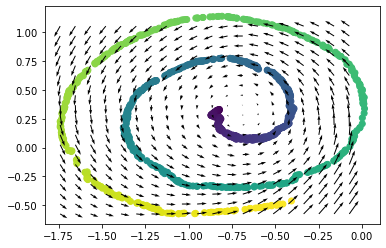

 58%|█████▊    | 5795/10000 [01:43<01:00, 69.98it/s]

EPOCH 5800.


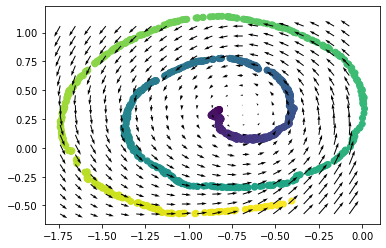

 59%|█████▉    | 5899/10000 [01:45<00:57, 70.79it/s]

EPOCH 5900.


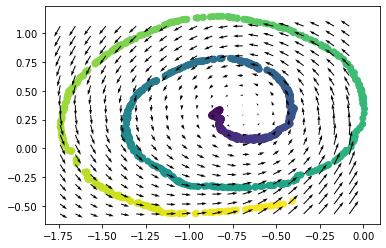

 60%|█████▉    | 5995/10000 [01:46<00:56, 71.37it/s]

EPOCH 6000.


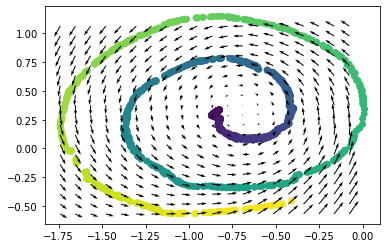

 61%|██████    | 6098/10000 [01:48<00:54, 71.91it/s]

EPOCH 6100.


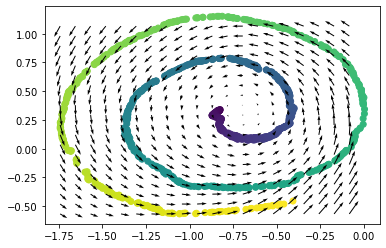

 62%|██████▏   | 6200/10000 [01:50<00:53, 71.30it/s]

EPOCH 6200.


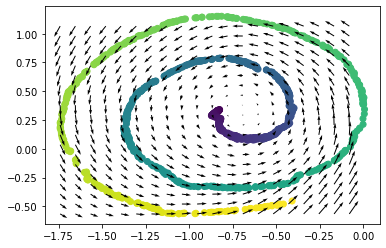

 63%|██████▎   | 6296/10000 [01:52<00:52, 70.97it/s]

EPOCH 6300.


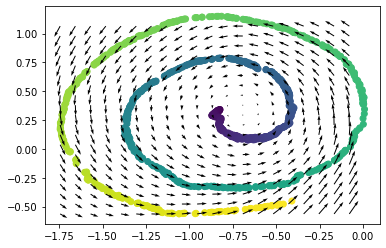

 64%|██████▍   | 6400/10000 [01:54<00:50, 71.09it/s]

EPOCH 6400.


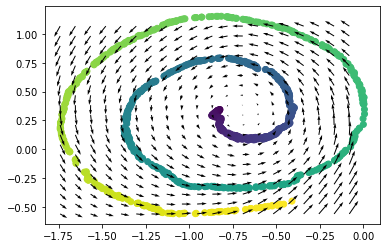

 65%|██████▍   | 6496/10000 [01:55<00:49, 70.10it/s]

EPOCH 6500.


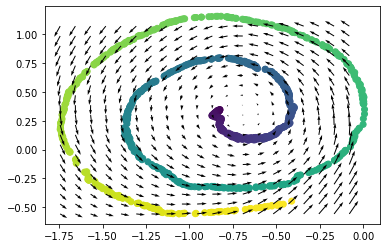

 66%|██████▌   | 6600/10000 [01:57<00:47, 71.37it/s]

EPOCH 6600.


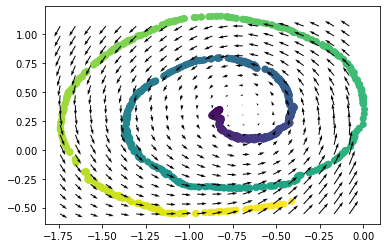

 67%|██████▋   | 6696/10000 [01:59<00:46, 70.71it/s]

EPOCH 6700.


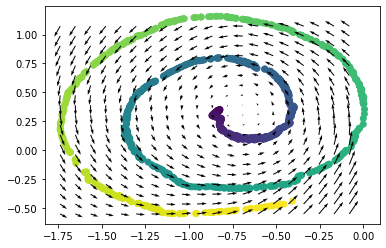

 68%|██████▊   | 6800/10000 [02:01<00:44, 71.55it/s]

EPOCH 6800.


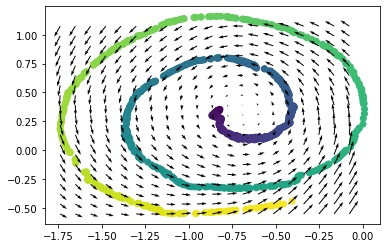

 69%|██████▉   | 6896/10000 [02:02<00:43, 71.34it/s]

EPOCH 6900.


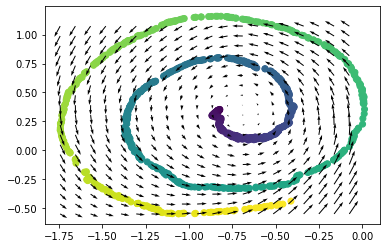

 70%|███████   | 7000/10000 [02:04<00:42, 71.41it/s]

EPOCH 7000.


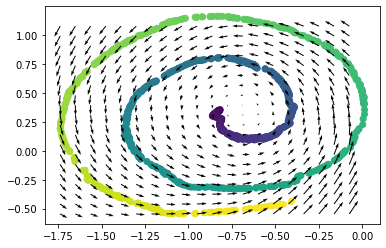

 71%|███████   | 7096/10000 [02:06<00:40, 71.31it/s]

EPOCH 7100.


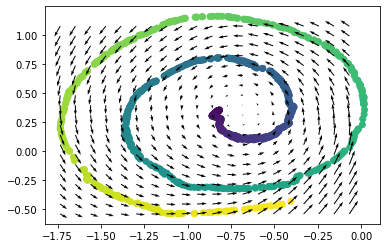

 72%|███████▏  | 7200/10000 [02:08<00:39, 71.05it/s]

EPOCH 7200.


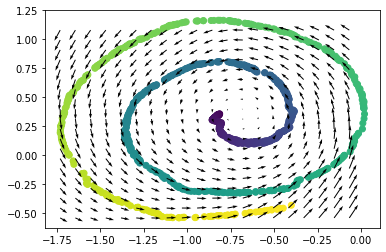

 73%|███████▎  | 7296/10000 [02:10<00:38, 70.73it/s]

EPOCH 7300.


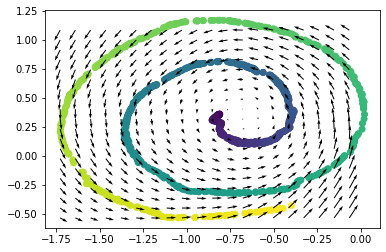

 74%|███████▍  | 7400/10000 [02:11<00:36, 71.66it/s]

EPOCH 7400.


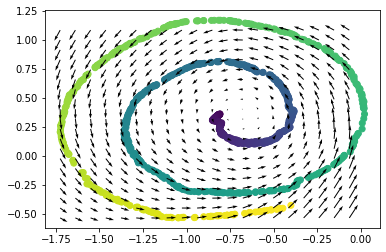

 75%|███████▍  | 7496/10000 [02:13<00:35, 70.59it/s]

EPOCH 7500.


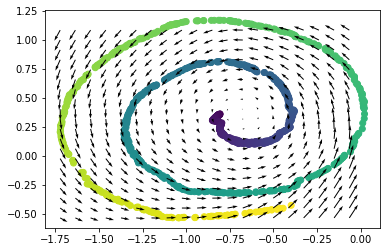

 76%|███████▌  | 7599/10000 [02:15<00:33, 71.28it/s]

EPOCH 7600.


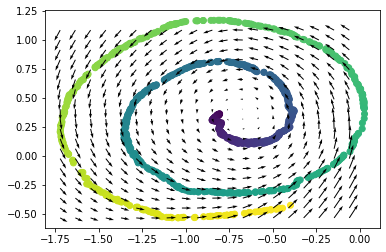

 77%|███████▋  | 7695/10000 [02:17<00:32, 70.68it/s]

EPOCH 7700.


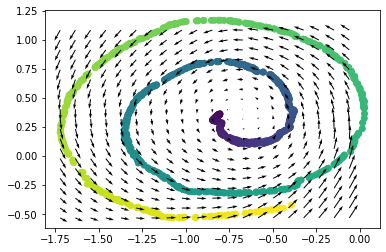

 78%|███████▊  | 7799/10000 [02:18<00:30, 71.37it/s]

EPOCH 7800.


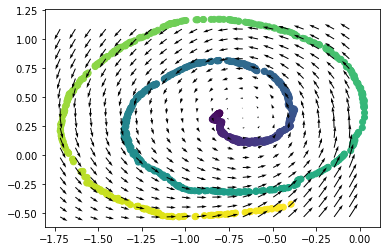

 79%|███████▉  | 7895/10000 [02:20<00:29, 70.51it/s]

EPOCH 7900.


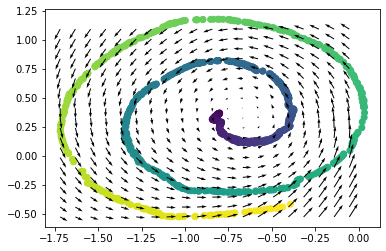

 80%|███████▉  | 7997/10000 [02:22<00:28, 71.11it/s]

EPOCH 8000.


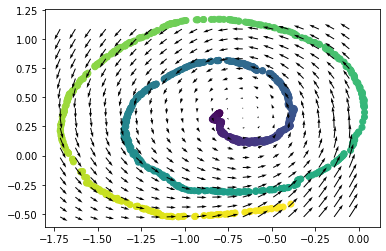

 81%|████████  | 8093/10000 [02:24<00:27, 70.04it/s]

EPOCH 8100.


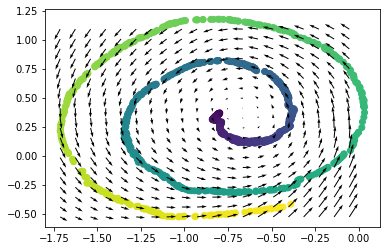

 82%|████████▏ | 8197/10000 [02:26<00:25, 70.50it/s]

EPOCH 8200.


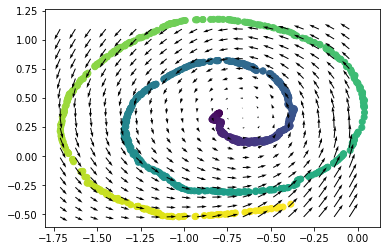

 83%|████████▎ | 8293/10000 [02:27<00:24, 70.59it/s]

EPOCH 8300.


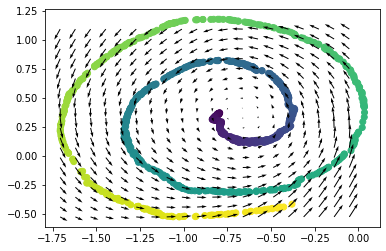

 84%|████████▍ | 8397/10000 [02:29<00:22, 71.09it/s]

EPOCH 8400.


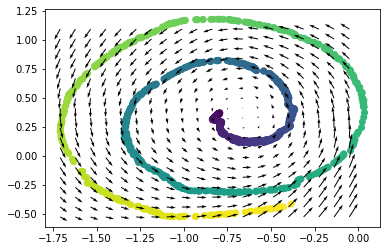

 85%|████████▍ | 8493/10000 [02:31<00:21, 70.68it/s]

EPOCH 8500.


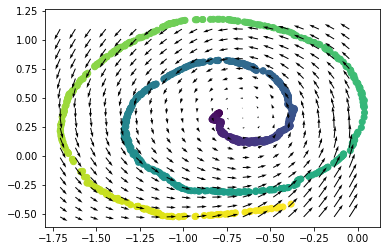

 86%|████████▌ | 8597/10000 [02:33<00:19, 71.46it/s]

EPOCH 8600.


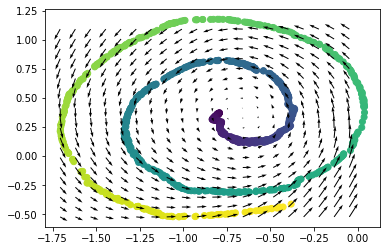

 87%|████████▋ | 8693/10000 [02:34<00:18, 71.03it/s]

EPOCH 8700.


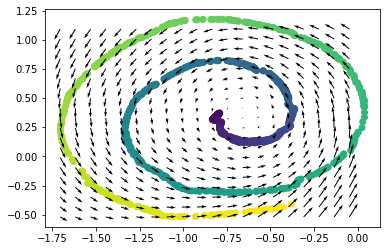

 88%|████████▊ | 8797/10000 [02:36<00:16, 70.95it/s]

EPOCH 8800.


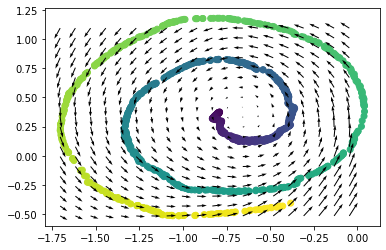

 89%|████████▉ | 8893/10000 [02:38<00:15, 70.25it/s]

EPOCH 8900.


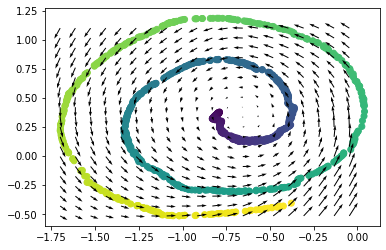

 90%|████████▉ | 8997/10000 [02:40<00:14, 71.21it/s]

EPOCH 9000.


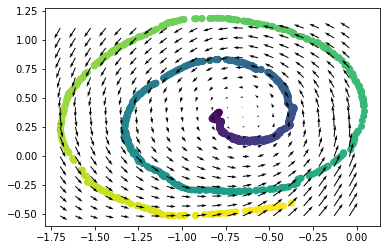

 91%|█████████ | 9093/10000 [02:41<00:12, 70.95it/s]

EPOCH 9100.


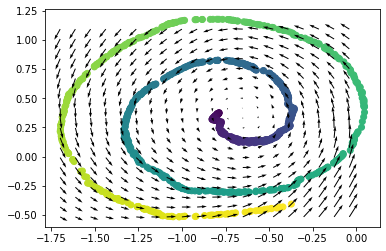

 92%|█████████▏| 9197/10000 [02:43<00:11, 71.27it/s]

EPOCH 9200.


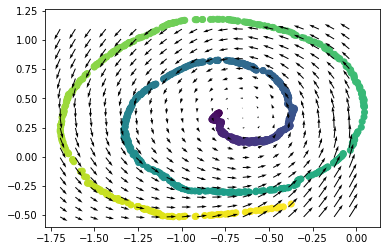

 93%|█████████▎| 9293/10000 [02:45<00:10, 70.15it/s]

EPOCH 9300.


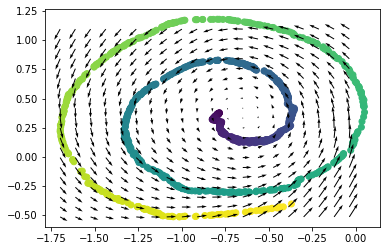

 94%|█████████▍| 9397/10000 [02:47<00:08, 71.30it/s]

EPOCH 9400.


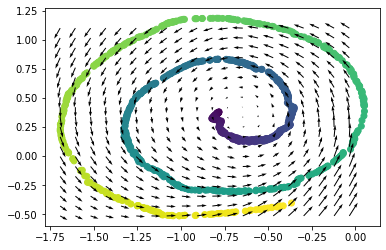

 95%|█████████▍| 9493/10000 [02:49<00:07, 70.30it/s]

EPOCH 9500.


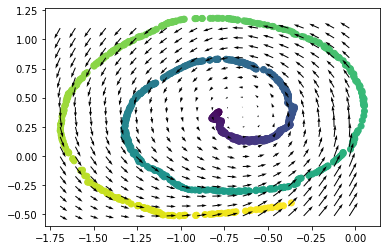

 96%|█████████▌| 9595/10000 [02:51<00:05, 70.60it/s]

EPOCH 9600.


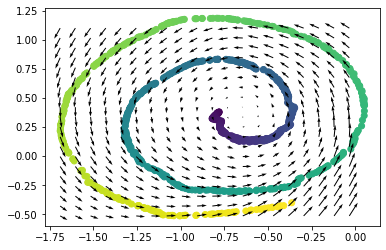

 97%|█████████▋| 9699/10000 [02:52<00:04, 71.30it/s]

EPOCH 9700.


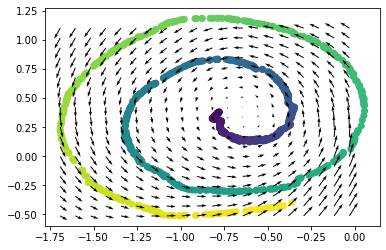

 98%|█████████▊| 9795/10000 [02:54<00:02, 70.74it/s]

EPOCH 9800.


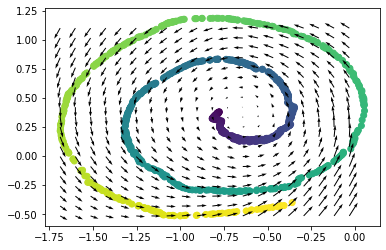

 99%|█████████▉| 9899/10000 [02:56<00:01, 71.46it/s]

EPOCH 9900.


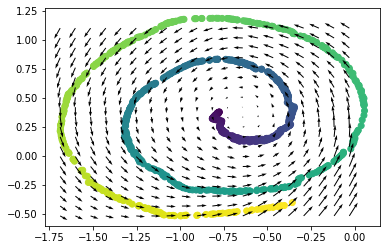

100%|██████████| 10000/10000 [02:58<00:00, 56.13it/s]


In [55]:
FE.fit(n_steps = 10000)

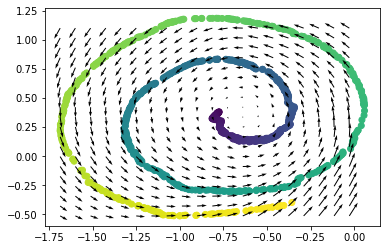

In [56]:
FE.visualize_points(labels)

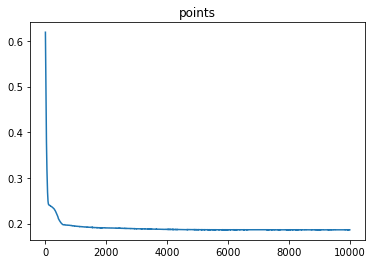

In [58]:
FE.visualize_loss("points")

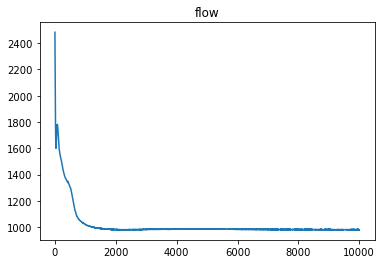

In [59]:
FE.visualize_loss("flow")

## Testing on Swiss Roll (not from origin)

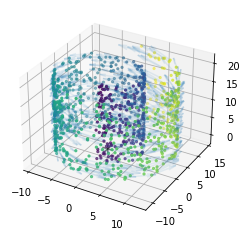

In [61]:
from directed_graphs.datasets import directed_swiss_roll_sklearn
X, flow, labels = directed_swiss_roll_sklearn()
plot_directed_3d(X, flow, labels)
X = torch.tensor(X).float().to(device)
flow = torch.tensor(flow).float().to(device)

In [62]:
FE = FlowEmbedder(X,
                  flow,
                  FAShape=(2, 4, 8, 4, 2),
                  EncShape=(3, 4, 8, 4, 2),
                  knn = 10,
                  device = device).to(device)

  0%|          | 0/10000 [00:00<?, ?it/s]

EPOCH 0.


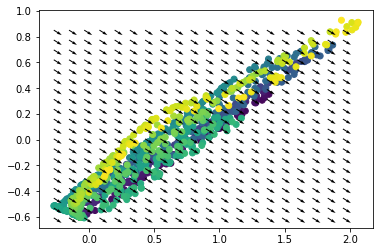

  1%|          | 97/10000 [00:01<02:18, 71.63it/s] 

EPOCH 100.


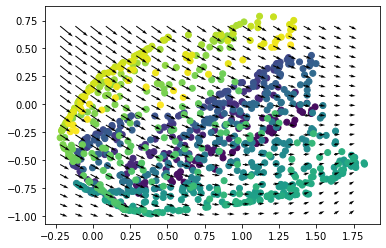

  2%|▏         | 193/10000 [00:03<02:17, 71.32it/s]

EPOCH 200.


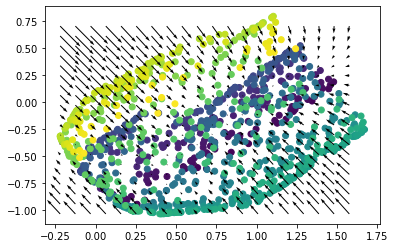

  3%|▎         | 297/10000 [00:05<02:14, 72.07it/s]

EPOCH 300.


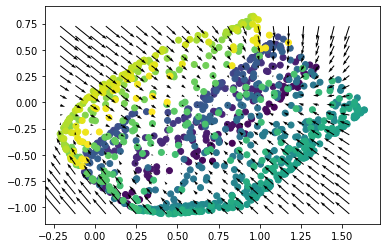

  4%|▍         | 393/10000 [00:07<02:15, 70.72it/s]

EPOCH 400.


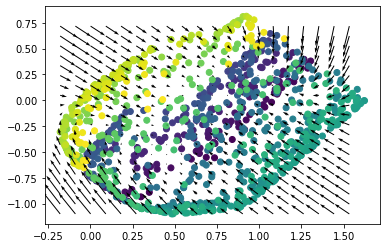

  5%|▍         | 497/10000 [00:08<02:11, 72.06it/s]

EPOCH 500.


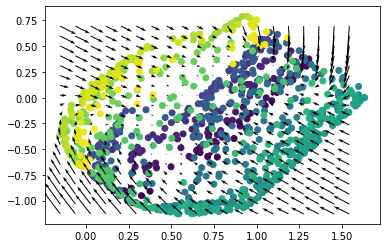

  6%|▌         | 593/10000 [00:10<02:11, 71.37it/s]

EPOCH 600.


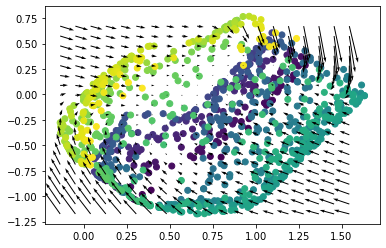

  7%|▋         | 697/10000 [00:12<02:08, 72.32it/s]

EPOCH 700.


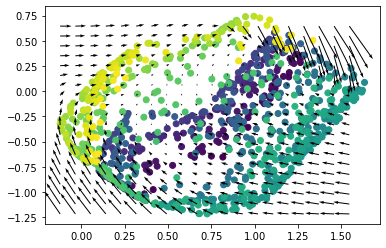

  8%|▊         | 793/10000 [00:14<02:08, 71.42it/s]

EPOCH 800.


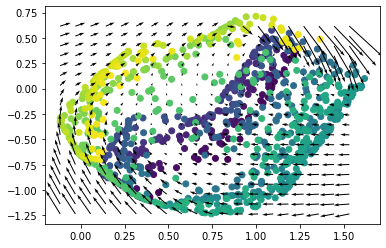

  9%|▉         | 897/10000 [00:16<02:07, 71.58it/s]

EPOCH 900.


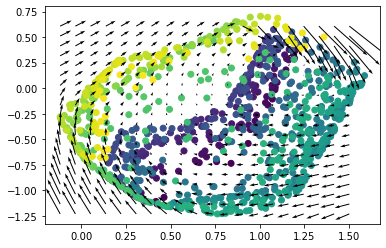

 10%|▉         | 961/10000 [00:17<02:15, 66.89it/s]

In [ ]:
FE.fit(n_steps = 10000)

In [ ]:
FE.visualize_points(labels)

In [ ]:
FE.visualize_loss("points")